# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

/usr/local/lib/python3.5/dist-packages/matplotlib/font_manager.py:280: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  'Matplotlib is building the font cache using fc-list. '


In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:03, 51.5MB/s]                            
SVHN Testing Set: 64.3MB [00:01, 47.8MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

In [5]:
print(trainset['X'].shape)
print(trainset['X'][0:3,0:3,0:1,0])
print(trainset['y'].shape)
print(trainset['y'][0:3])

(32, 32, 3, 73257)
[[[33]
  [15]
  [15]]

 [[28]
  [14]
  [14]]

 [[40]
  [18]
  [16]]]
(73257, 1)
[[1]
 [9]
 [2]]


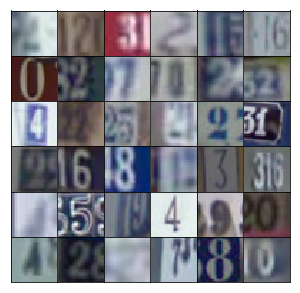

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):

        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512, activation=None)
        
        # Conv Block 1: DeConv, BatchNorm, LReLU: (Batch Num, 4, 4, 512)
        x = tf.reshape(x, (-1, 4, 4, 512))
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha*x, x) # LReLU
        
        # Conv Block 2: (Batch Num, 8, 8, 256)
        x = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding='same', use_bias=True, activation=None)
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha*x, x)
        
        #  Conv Block 3: (Batch Num, 16, 16, 128)
        x = tf.layers.conv2d_transpose(x, 128, 5, strides=2, padding='same', use_bias=True, activation=None)
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha*x, x)
        
        # Conv Block 4: (Batch Num, 32, 32, 3)
        x = tf.layers.conv2d_transpose(x, output_dim, 5, strides=2, padding='same', use_bias=True, activation=None)
        # x = tf.layers.batch_normalization(x, training=training)
        # x = tf.maximum(alpha*x, x)
        
        # Output layer, 32x32x3
        logits = x
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        
        # Don't use the batch norm at the first layer out:(BatchNum, 16, 16, 64)
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding='same', use_bias=True)
        x = tf.maximum(alpha*x, x)
        
        # out: (BatchNum, 8, 8, 128)
        x = tf.layers.conv2d(x, 128, 5, strides=2, padding='same', use_bias=True)
        x = tf.layers.batch_normalization(x)
        x = tf.maximum(alpha*x, x)
        
        # out: (BatchNum, 4, 4, 256)
        x = tf.layers.conv2d(x, 256, 5, strides=2, padding='same', use_bias=True)
        x = tf.layers.batch_normalization(x)
        x = tf.maximum(alpha*x, x)
        
        # Flatten -> FC(1024) (NatchNum, 1024)
        x = tf.reshape(x, (-1, 4*4*256))
    
        # Logits
        x = tf.layers.dense(x, 1)

        logits = x
        out = tf.sigmoid(x)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x}) # we don't need it, but for just to avoid the control_dependency error

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [21]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2233... Generator Loss: 0.7011
Epoch 1/25... Discriminator Loss: 0.6775... Generator Loss: 1.3328
Epoch 1/25... Discriminator Loss: 0.8210... Generator Loss: 1.3538
Epoch 1/25... Discriminator Loss: 0.8742... Generator Loss: 1.6434
Epoch 1/25... Discriminator Loss: 0.4888... Generator Loss: 1.9891
Epoch 1/25... Discriminator Loss: 0.7184... Generator Loss: 1.3837
Epoch 1/25... Discriminator Loss: 2.5799... Generator Loss: 0.6016
Epoch 1/25... Discriminator Loss: 1.4925... Generator Loss: 0.7277
Epoch 1/25... Discriminator Loss: 1.4196... Generator Loss: 0.7158
Epoch 1/25... Discriminator Loss: 1.2688... Generator Loss: 0.7650


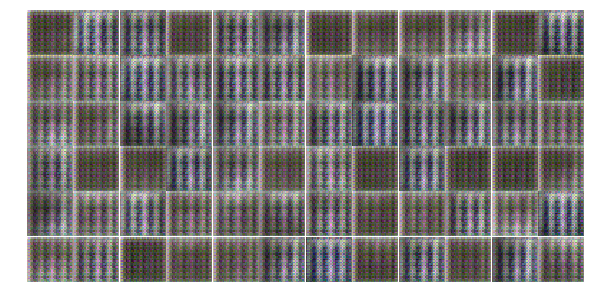

Epoch 1/25... Discriminator Loss: 1.2721... Generator Loss: 0.7384
Epoch 1/25... Discriminator Loss: 1.0983... Generator Loss: 0.8074
Epoch 1/25... Discriminator Loss: 1.2263... Generator Loss: 0.7521
Epoch 1/25... Discriminator Loss: 1.1744... Generator Loss: 0.8743
Epoch 1/25... Discriminator Loss: 1.3981... Generator Loss: 0.7543
Epoch 1/25... Discriminator Loss: 1.3529... Generator Loss: 0.7907
Epoch 1/25... Discriminator Loss: 1.2325... Generator Loss: 0.8142
Epoch 1/25... Discriminator Loss: 1.3242... Generator Loss: 0.7103
Epoch 1/25... Discriminator Loss: 1.2242... Generator Loss: 0.8797
Epoch 1/25... Discriminator Loss: 1.1927... Generator Loss: 0.8301


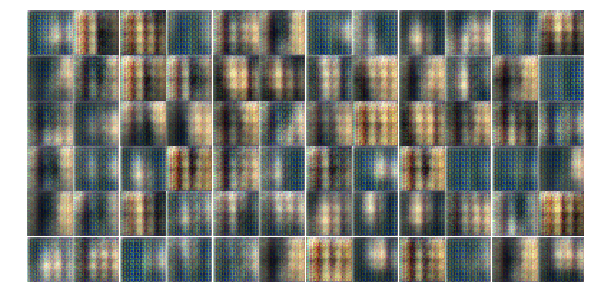

Epoch 1/25... Discriminator Loss: 1.1314... Generator Loss: 0.8327
Epoch 1/25... Discriminator Loss: 1.1416... Generator Loss: 0.8392
Epoch 1/25... Discriminator Loss: 1.2592... Generator Loss: 0.8338
Epoch 1/25... Discriminator Loss: 1.5175... Generator Loss: 0.7397
Epoch 1/25... Discriminator Loss: 1.1601... Generator Loss: 0.9034
Epoch 1/25... Discriminator Loss: 1.4331... Generator Loss: 0.6108
Epoch 1/25... Discriminator Loss: 1.3315... Generator Loss: 0.7859
Epoch 1/25... Discriminator Loss: 1.2631... Generator Loss: 0.7537
Epoch 1/25... Discriminator Loss: 1.4759... Generator Loss: 0.5737
Epoch 1/25... Discriminator Loss: 1.3320... Generator Loss: 0.7693


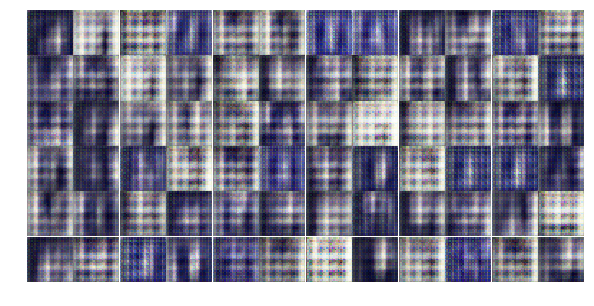

Epoch 1/25... Discriminator Loss: 1.3011... Generator Loss: 0.7885
Epoch 1/25... Discriminator Loss: 1.1295... Generator Loss: 0.8849
Epoch 1/25... Discriminator Loss: 1.5079... Generator Loss: 0.6312
Epoch 1/25... Discriminator Loss: 1.3499... Generator Loss: 0.7482
Epoch 1/25... Discriminator Loss: 1.3265... Generator Loss: 0.8637
Epoch 1/25... Discriminator Loss: 1.1675... Generator Loss: 0.8031
Epoch 1/25... Discriminator Loss: 1.2442... Generator Loss: 0.7110
Epoch 1/25... Discriminator Loss: 1.4616... Generator Loss: 0.7936
Epoch 1/25... Discriminator Loss: 1.2367... Generator Loss: 0.8513
Epoch 1/25... Discriminator Loss: 1.3305... Generator Loss: 0.7586


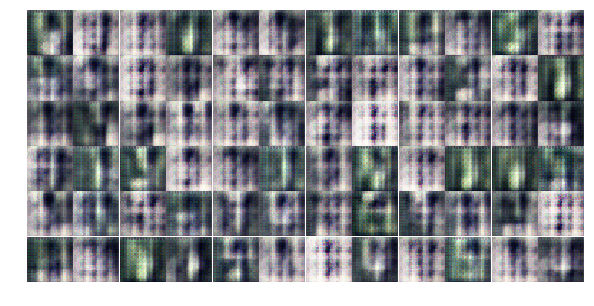

Epoch 1/25... Discriminator Loss: 1.2644... Generator Loss: 0.7483
Epoch 1/25... Discriminator Loss: 1.1899... Generator Loss: 0.9367
Epoch 1/25... Discriminator Loss: 1.3127... Generator Loss: 0.7068
Epoch 1/25... Discriminator Loss: 1.3284... Generator Loss: 0.6783
Epoch 1/25... Discriminator Loss: 1.3665... Generator Loss: 0.7585
Epoch 1/25... Discriminator Loss: 1.3129... Generator Loss: 0.6925
Epoch 1/25... Discriminator Loss: 1.4429... Generator Loss: 0.6860
Epoch 1/25... Discriminator Loss: 1.3376... Generator Loss: 0.7343
Epoch 1/25... Discriminator Loss: 1.3760... Generator Loss: 0.7562
Epoch 1/25... Discriminator Loss: 1.3504... Generator Loss: 0.7060


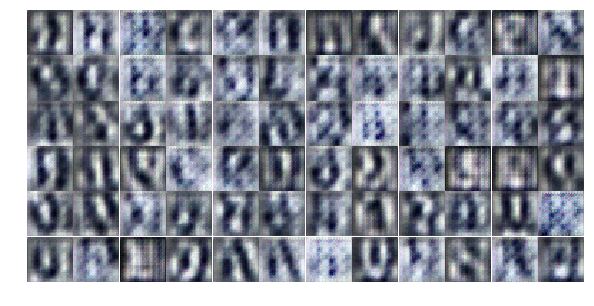

Epoch 1/25... Discriminator Loss: 1.2653... Generator Loss: 0.7309
Epoch 1/25... Discriminator Loss: 1.4357... Generator Loss: 0.7780
Epoch 1/25... Discriminator Loss: 1.1396... Generator Loss: 0.8523
Epoch 1/25... Discriminator Loss: 1.3271... Generator Loss: 0.7706
Epoch 1/25... Discriminator Loss: 1.3844... Generator Loss: 0.7114
Epoch 1/25... Discriminator Loss: 1.2830... Generator Loss: 0.7524
Epoch 1/25... Discriminator Loss: 1.2227... Generator Loss: 0.8446
Epoch 2/25... Discriminator Loss: 1.3938... Generator Loss: 0.7568
Epoch 2/25... Discriminator Loss: 1.4641... Generator Loss: 0.8343
Epoch 2/25... Discriminator Loss: 1.3938... Generator Loss: 0.8000


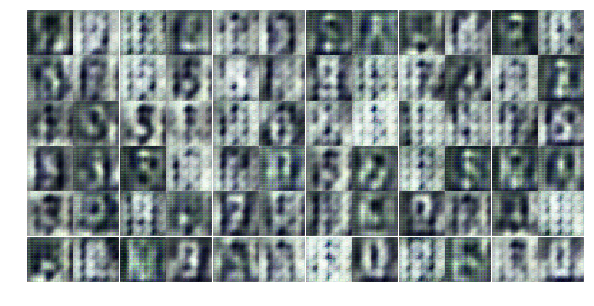

Epoch 2/25... Discriminator Loss: 1.2743... Generator Loss: 0.7493
Epoch 2/25... Discriminator Loss: 1.2883... Generator Loss: 0.7439
Epoch 2/25... Discriminator Loss: 1.2665... Generator Loss: 0.8292
Epoch 2/25... Discriminator Loss: 1.3460... Generator Loss: 0.6609
Epoch 2/25... Discriminator Loss: 1.2732... Generator Loss: 0.8374
Epoch 2/25... Discriminator Loss: 1.3191... Generator Loss: 0.6917
Epoch 2/25... Discriminator Loss: 1.2318... Generator Loss: 0.7712
Epoch 2/25... Discriminator Loss: 1.3640... Generator Loss: 0.6885
Epoch 2/25... Discriminator Loss: 1.2900... Generator Loss: 0.8464
Epoch 2/25... Discriminator Loss: 1.3389... Generator Loss: 0.7432


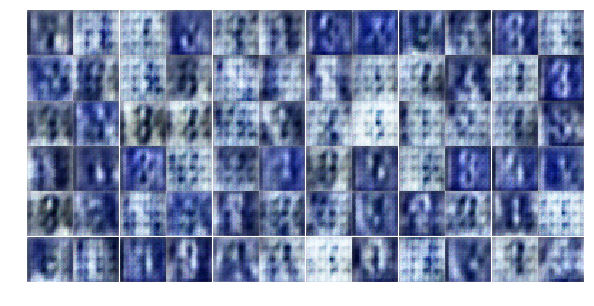

Epoch 2/25... Discriminator Loss: 1.2891... Generator Loss: 0.6641
Epoch 2/25... Discriminator Loss: 1.2875... Generator Loss: 0.7212
Epoch 2/25... Discriminator Loss: 1.4221... Generator Loss: 0.6947
Epoch 2/25... Discriminator Loss: 1.2861... Generator Loss: 0.8073
Epoch 2/25... Discriminator Loss: 1.2452... Generator Loss: 0.7405
Epoch 2/25... Discriminator Loss: 1.2551... Generator Loss: 0.7280
Epoch 2/25... Discriminator Loss: 1.2925... Generator Loss: 0.7260
Epoch 2/25... Discriminator Loss: 1.3077... Generator Loss: 0.7123
Epoch 2/25... Discriminator Loss: 1.3539... Generator Loss: 0.8452
Epoch 2/25... Discriminator Loss: 1.0771... Generator Loss: 0.8103


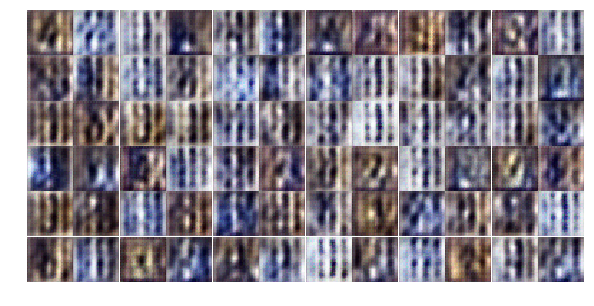

Epoch 2/25... Discriminator Loss: 1.2254... Generator Loss: 0.8544
Epoch 2/25... Discriminator Loss: 1.3304... Generator Loss: 0.6882
Epoch 2/25... Discriminator Loss: 1.1961... Generator Loss: 0.8131
Epoch 2/25... Discriminator Loss: 1.3080... Generator Loss: 1.1195
Epoch 2/25... Discriminator Loss: 1.2935... Generator Loss: 0.7120
Epoch 2/25... Discriminator Loss: 1.2994... Generator Loss: 0.7172
Epoch 2/25... Discriminator Loss: 1.2987... Generator Loss: 0.8364
Epoch 2/25... Discriminator Loss: 1.1831... Generator Loss: 0.6994
Epoch 2/25... Discriminator Loss: 1.0197... Generator Loss: 0.9399
Epoch 2/25... Discriminator Loss: 1.2132... Generator Loss: 0.8436


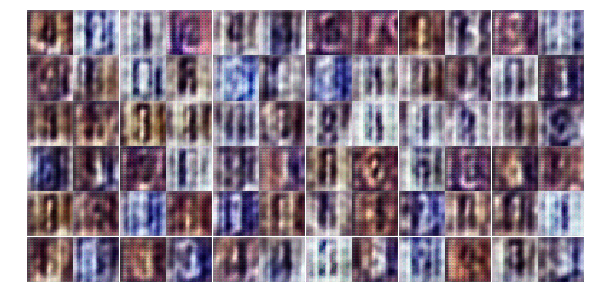

Epoch 2/25... Discriminator Loss: 1.1750... Generator Loss: 1.0958
Epoch 2/25... Discriminator Loss: 0.9064... Generator Loss: 1.0020
Epoch 2/25... Discriminator Loss: 1.1773... Generator Loss: 0.8402
Epoch 2/25... Discriminator Loss: 1.0814... Generator Loss: 0.8220
Epoch 2/25... Discriminator Loss: 1.0376... Generator Loss: 0.9225
Epoch 2/25... Discriminator Loss: 0.7601... Generator Loss: 1.0079
Epoch 2/25... Discriminator Loss: 1.3858... Generator Loss: 0.9438
Epoch 2/25... Discriminator Loss: 0.9411... Generator Loss: 0.8457
Epoch 2/25... Discriminator Loss: 1.3520... Generator Loss: 0.8078
Epoch 2/25... Discriminator Loss: 1.2348... Generator Loss: 0.7891


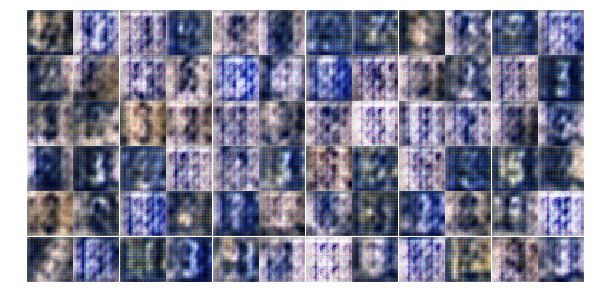

Epoch 2/25... Discriminator Loss: 1.2221... Generator Loss: 0.8415
Epoch 2/25... Discriminator Loss: 1.1726... Generator Loss: 0.7171
Epoch 2/25... Discriminator Loss: 1.2413... Generator Loss: 1.2157
Epoch 2/25... Discriminator Loss: 1.2383... Generator Loss: 0.6640
Epoch 2/25... Discriminator Loss: 1.1036... Generator Loss: 0.8515
Epoch 2/25... Discriminator Loss: 0.9741... Generator Loss: 0.8667
Epoch 2/25... Discriminator Loss: 1.1638... Generator Loss: 1.1233
Epoch 2/25... Discriminator Loss: 1.3236... Generator Loss: 0.7573
Epoch 2/25... Discriminator Loss: 1.3683... Generator Loss: 0.8033
Epoch 2/25... Discriminator Loss: 1.1878... Generator Loss: 0.8434


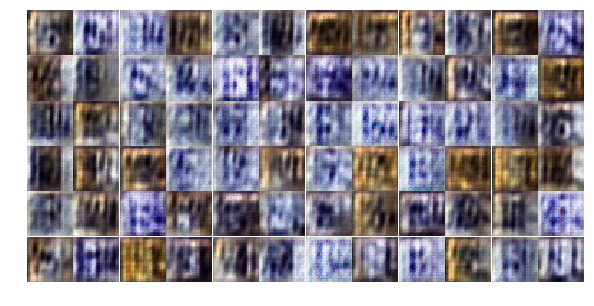

Epoch 2/25... Discriminator Loss: 1.4893... Generator Loss: 0.7154
Epoch 2/25... Discriminator Loss: 1.2428... Generator Loss: 0.7101
Epoch 2/25... Discriminator Loss: 1.2845... Generator Loss: 0.8664
Epoch 2/25... Discriminator Loss: 1.3423... Generator Loss: 0.8387
Epoch 3/25... Discriminator Loss: 1.2555... Generator Loss: 0.7539
Epoch 3/25... Discriminator Loss: 1.3064... Generator Loss: 0.7062
Epoch 3/25... Discriminator Loss: 1.0930... Generator Loss: 1.0825
Epoch 3/25... Discriminator Loss: 1.1919... Generator Loss: 0.8087
Epoch 3/25... Discriminator Loss: 1.2859... Generator Loss: 0.8946
Epoch 3/25... Discriminator Loss: 1.3635... Generator Loss: 0.8159


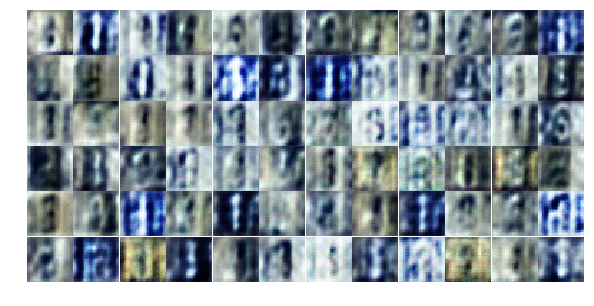

Epoch 3/25... Discriminator Loss: 1.2452... Generator Loss: 0.8523
Epoch 3/25... Discriminator Loss: 1.3082... Generator Loss: 0.7101
Epoch 3/25... Discriminator Loss: 1.3465... Generator Loss: 1.1207
Epoch 3/25... Discriminator Loss: 1.2914... Generator Loss: 0.8117
Epoch 3/25... Discriminator Loss: 1.2873... Generator Loss: 0.6832
Epoch 3/25... Discriminator Loss: 1.3750... Generator Loss: 1.0251
Epoch 3/25... Discriminator Loss: 1.3303... Generator Loss: 0.7547
Epoch 3/25... Discriminator Loss: 1.2389... Generator Loss: 0.7608
Epoch 3/25... Discriminator Loss: 1.4625... Generator Loss: 0.7435
Epoch 3/25... Discriminator Loss: 1.3689... Generator Loss: 0.7342


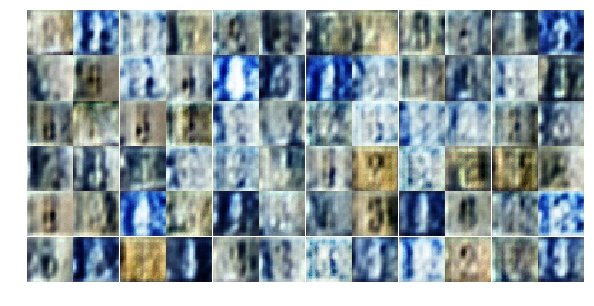

Epoch 3/25... Discriminator Loss: 1.3566... Generator Loss: 0.7174
Epoch 3/25... Discriminator Loss: 1.2561... Generator Loss: 0.7383
Epoch 3/25... Discriminator Loss: 1.3100... Generator Loss: 0.7634
Epoch 3/25... Discriminator Loss: 1.2557... Generator Loss: 0.7519
Epoch 3/25... Discriminator Loss: 1.3306... Generator Loss: 0.7075
Epoch 3/25... Discriminator Loss: 1.2642... Generator Loss: 0.7074
Epoch 3/25... Discriminator Loss: 1.3172... Generator Loss: 0.7802
Epoch 3/25... Discriminator Loss: 1.3305... Generator Loss: 0.7906
Epoch 3/25... Discriminator Loss: 1.3955... Generator Loss: 0.7485
Epoch 3/25... Discriminator Loss: 1.2140... Generator Loss: 0.7221


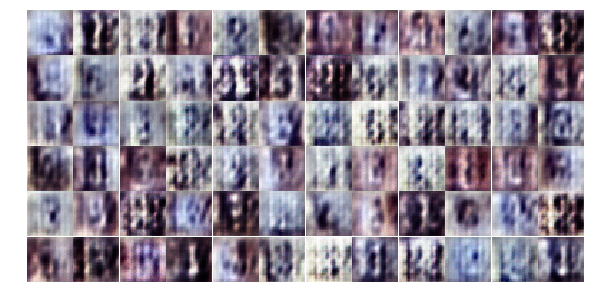

Epoch 3/25... Discriminator Loss: 1.3731... Generator Loss: 0.7087
Epoch 3/25... Discriminator Loss: 1.5315... Generator Loss: 0.6579
Epoch 3/25... Discriminator Loss: 1.2808... Generator Loss: 0.8165
Epoch 3/25... Discriminator Loss: 1.3733... Generator Loss: 0.7288
Epoch 3/25... Discriminator Loss: 1.2847... Generator Loss: 0.7298
Epoch 3/25... Discriminator Loss: 1.3302... Generator Loss: 0.7259
Epoch 3/25... Discriminator Loss: 1.3179... Generator Loss: 0.7573
Epoch 3/25... Discriminator Loss: 1.2554... Generator Loss: 0.8497
Epoch 3/25... Discriminator Loss: 1.2924... Generator Loss: 0.7503
Epoch 3/25... Discriminator Loss: 1.2468... Generator Loss: 0.7361


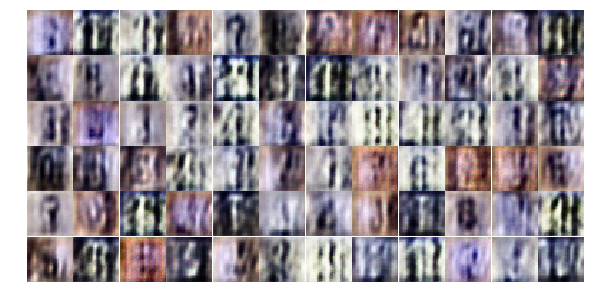

Epoch 3/25... Discriminator Loss: 1.1685... Generator Loss: 0.8722
Epoch 3/25... Discriminator Loss: 1.1643... Generator Loss: 0.7613
Epoch 3/25... Discriminator Loss: 1.3718... Generator Loss: 0.5751
Epoch 3/25... Discriminator Loss: 1.1715... Generator Loss: 0.8328
Epoch 3/25... Discriminator Loss: 1.2589... Generator Loss: 0.7153
Epoch 3/25... Discriminator Loss: 1.3396... Generator Loss: 0.8199
Epoch 3/25... Discriminator Loss: 1.3580... Generator Loss: 0.7169
Epoch 3/25... Discriminator Loss: 1.3581... Generator Loss: 0.7229
Epoch 3/25... Discriminator Loss: 1.2776... Generator Loss: 0.7279
Epoch 3/25... Discriminator Loss: 1.1450... Generator Loss: 0.8648


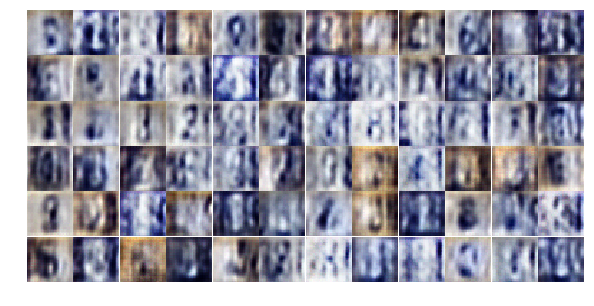

Epoch 3/25... Discriminator Loss: 1.2930... Generator Loss: 0.6770
Epoch 3/25... Discriminator Loss: 1.3759... Generator Loss: 0.7898
Epoch 3/25... Discriminator Loss: 1.2499... Generator Loss: 0.7658
Epoch 3/25... Discriminator Loss: 1.2326... Generator Loss: 0.8036
Epoch 3/25... Discriminator Loss: 1.3268... Generator Loss: 0.7906
Epoch 3/25... Discriminator Loss: 1.3439... Generator Loss: 0.7566
Epoch 3/25... Discriminator Loss: 1.2895... Generator Loss: 0.7466
Epoch 3/25... Discriminator Loss: 1.3111... Generator Loss: 0.7743
Epoch 3/25... Discriminator Loss: 1.3765... Generator Loss: 0.7698
Epoch 3/25... Discriminator Loss: 1.2943... Generator Loss: 0.7093


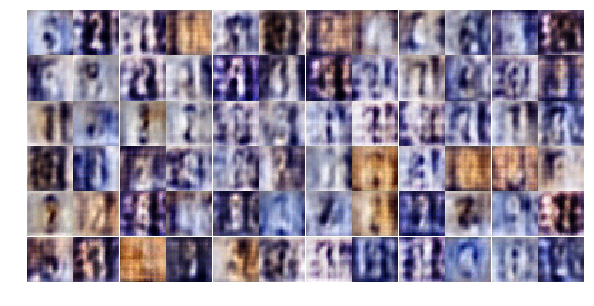

Epoch 3/25... Discriminator Loss: 1.3469... Generator Loss: 0.7670
Epoch 4/25... Discriminator Loss: 1.3135... Generator Loss: 0.7510
Epoch 4/25... Discriminator Loss: 1.2971... Generator Loss: 0.6417
Epoch 4/25... Discriminator Loss: 1.3378... Generator Loss: 0.7533
Epoch 4/25... Discriminator Loss: 1.2711... Generator Loss: 0.7211
Epoch 4/25... Discriminator Loss: 1.3951... Generator Loss: 0.7630
Epoch 4/25... Discriminator Loss: 1.2541... Generator Loss: 0.7325
Epoch 4/25... Discriminator Loss: 1.3377... Generator Loss: 0.7603
Epoch 4/25... Discriminator Loss: 1.3151... Generator Loss: 0.7199
Epoch 4/25... Discriminator Loss: 1.2631... Generator Loss: 0.7777


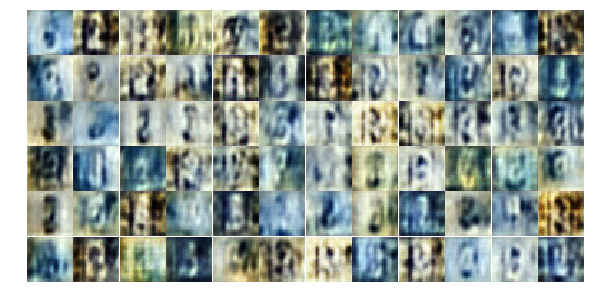

Epoch 4/25... Discriminator Loss: 1.3100... Generator Loss: 0.7419
Epoch 4/25... Discriminator Loss: 1.2769... Generator Loss: 0.8248
Epoch 4/25... Discriminator Loss: 1.4239... Generator Loss: 0.7448
Epoch 4/25... Discriminator Loss: 1.2918... Generator Loss: 0.7549
Epoch 4/25... Discriminator Loss: 1.4725... Generator Loss: 0.7036
Epoch 4/25... Discriminator Loss: 1.3117... Generator Loss: 0.7258
Epoch 4/25... Discriminator Loss: 1.2283... Generator Loss: 0.7167
Epoch 4/25... Discriminator Loss: 1.3688... Generator Loss: 0.7542
Epoch 4/25... Discriminator Loss: 1.3817... Generator Loss: 0.7075
Epoch 4/25... Discriminator Loss: 1.3445... Generator Loss: 0.7441


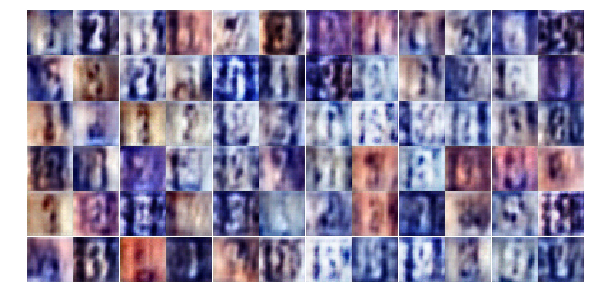

Epoch 4/25... Discriminator Loss: 1.3293... Generator Loss: 0.7381
Epoch 4/25... Discriminator Loss: 1.2801... Generator Loss: 0.8762
Epoch 4/25... Discriminator Loss: 1.4124... Generator Loss: 0.8104
Epoch 4/25... Discriminator Loss: 1.3517... Generator Loss: 0.6517
Epoch 4/25... Discriminator Loss: 1.3484... Generator Loss: 0.8783
Epoch 4/25... Discriminator Loss: 1.1243... Generator Loss: 0.8700
Epoch 4/25... Discriminator Loss: 1.3048... Generator Loss: 0.7502
Epoch 4/25... Discriminator Loss: 1.2570... Generator Loss: 0.7923
Epoch 4/25... Discriminator Loss: 1.3204... Generator Loss: 0.8143
Epoch 4/25... Discriminator Loss: 1.3711... Generator Loss: 0.7793


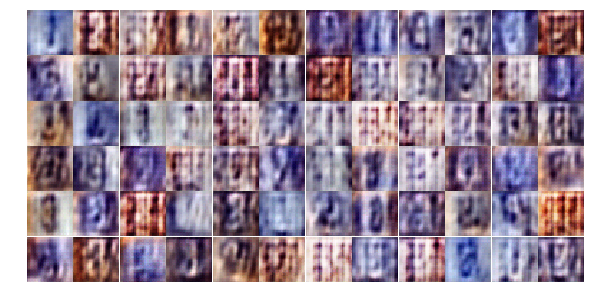

Epoch 4/25... Discriminator Loss: 1.2610... Generator Loss: 0.7527
Epoch 4/25... Discriminator Loss: 1.3800... Generator Loss: 0.7313
Epoch 4/25... Discriminator Loss: 1.3140... Generator Loss: 0.7599
Epoch 4/25... Discriminator Loss: 1.3107... Generator Loss: 0.7422
Epoch 4/25... Discriminator Loss: 1.1270... Generator Loss: 0.7378
Epoch 4/25... Discriminator Loss: 1.3202... Generator Loss: 0.7257
Epoch 4/25... Discriminator Loss: 1.2857... Generator Loss: 0.6998
Epoch 4/25... Discriminator Loss: 1.2749... Generator Loss: 0.7426
Epoch 4/25... Discriminator Loss: 1.3252... Generator Loss: 0.6792
Epoch 4/25... Discriminator Loss: 1.1266... Generator Loss: 0.7895


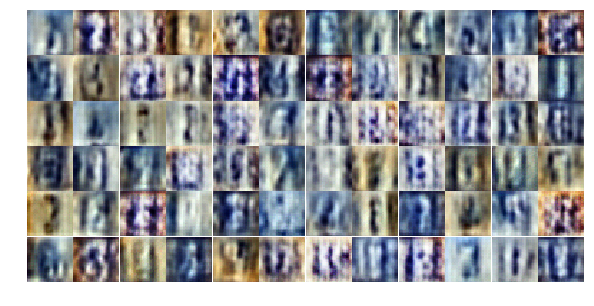

Epoch 4/25... Discriminator Loss: 1.2881... Generator Loss: 0.7446
Epoch 4/25... Discriminator Loss: 1.4090... Generator Loss: 1.0170
Epoch 4/25... Discriminator Loss: 1.3499... Generator Loss: 0.6651
Epoch 4/25... Discriminator Loss: 1.2253... Generator Loss: 0.7343
Epoch 4/25... Discriminator Loss: 1.3167... Generator Loss: 0.8377
Epoch 4/25... Discriminator Loss: 1.3100... Generator Loss: 0.8108
Epoch 4/25... Discriminator Loss: 1.2863... Generator Loss: 0.7581
Epoch 4/25... Discriminator Loss: 1.4915... Generator Loss: 0.5671
Epoch 4/25... Discriminator Loss: 1.2705... Generator Loss: 0.7025
Epoch 4/25... Discriminator Loss: 1.3603... Generator Loss: 0.8269


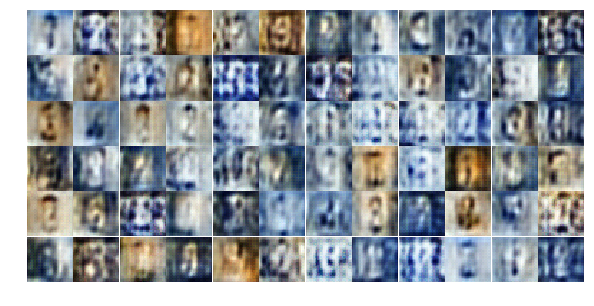

Epoch 4/25... Discriminator Loss: 1.1119... Generator Loss: 0.8120
Epoch 4/25... Discriminator Loss: 1.6892... Generator Loss: 0.6946
Epoch 4/25... Discriminator Loss: 1.2859... Generator Loss: 0.6868
Epoch 4/25... Discriminator Loss: 1.2485... Generator Loss: 0.7789
Epoch 4/25... Discriminator Loss: 1.3384... Generator Loss: 0.7857
Epoch 4/25... Discriminator Loss: 1.3312... Generator Loss: 0.6621
Epoch 4/25... Discriminator Loss: 0.8821... Generator Loss: 1.0681
Epoch 4/25... Discriminator Loss: 1.2711... Generator Loss: 0.7564
Epoch 4/25... Discriminator Loss: 1.3092... Generator Loss: 0.7829
Epoch 5/25... Discriminator Loss: 1.3053... Generator Loss: 0.6932


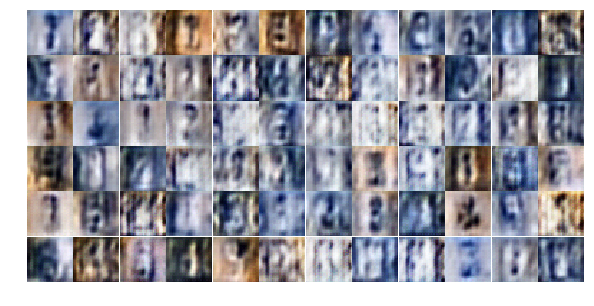

Epoch 5/25... Discriminator Loss: 1.3445... Generator Loss: 0.7824
Epoch 5/25... Discriminator Loss: 1.2395... Generator Loss: 0.7409
Epoch 5/25... Discriminator Loss: 1.3597... Generator Loss: 0.7300
Epoch 5/25... Discriminator Loss: 1.2430... Generator Loss: 0.7384
Epoch 5/25... Discriminator Loss: 1.1973... Generator Loss: 0.7410
Epoch 5/25... Discriminator Loss: 1.3346... Generator Loss: 0.6483
Epoch 5/25... Discriminator Loss: 1.3084... Generator Loss: 0.8559
Epoch 5/25... Discriminator Loss: 1.1122... Generator Loss: 0.8354
Epoch 5/25... Discriminator Loss: 1.4999... Generator Loss: 0.8384
Epoch 5/25... Discriminator Loss: 1.3779... Generator Loss: 0.7186


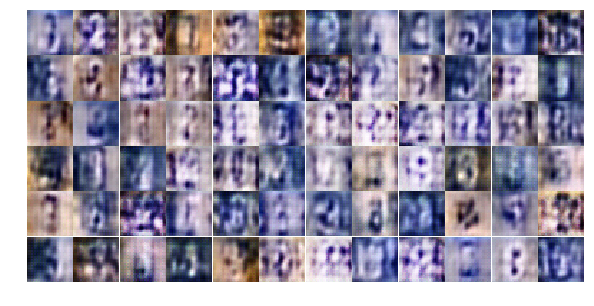

Epoch 5/25... Discriminator Loss: 1.1849... Generator Loss: 0.8429
Epoch 5/25... Discriminator Loss: 1.3783... Generator Loss: 0.7579
Epoch 5/25... Discriminator Loss: 1.1348... Generator Loss: 0.8096
Epoch 5/25... Discriminator Loss: 1.3400... Generator Loss: 0.7945
Epoch 5/25... Discriminator Loss: 1.2275... Generator Loss: 0.8724
Epoch 5/25... Discriminator Loss: 1.1942... Generator Loss: 0.9486
Epoch 5/25... Discriminator Loss: 1.3386... Generator Loss: 0.9274
Epoch 5/25... Discriminator Loss: 1.2637... Generator Loss: 0.8754
Epoch 5/25... Discriminator Loss: 1.0338... Generator Loss: 0.9419
Epoch 5/25... Discriminator Loss: 1.2963... Generator Loss: 0.7113


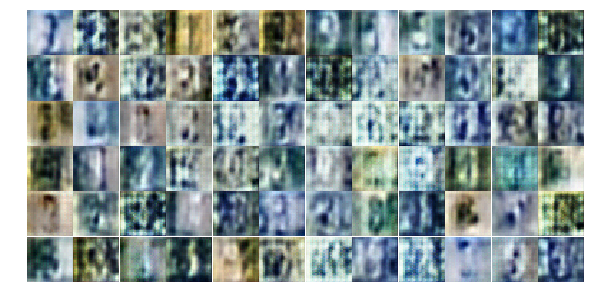

Epoch 5/25... Discriminator Loss: 1.2933... Generator Loss: 0.7752
Epoch 5/25... Discriminator Loss: 1.2480... Generator Loss: 0.7818
Epoch 5/25... Discriminator Loss: 1.3344... Generator Loss: 0.7245
Epoch 5/25... Discriminator Loss: 1.2762... Generator Loss: 0.8437
Epoch 5/25... Discriminator Loss: 1.0867... Generator Loss: 0.8037
Epoch 5/25... Discriminator Loss: 1.1194... Generator Loss: 0.9985
Epoch 5/25... Discriminator Loss: 1.2768... Generator Loss: 1.1950
Epoch 5/25... Discriminator Loss: 1.1997... Generator Loss: 0.7846
Epoch 5/25... Discriminator Loss: 1.3819... Generator Loss: 0.8212
Epoch 5/25... Discriminator Loss: 1.2756... Generator Loss: 0.7951


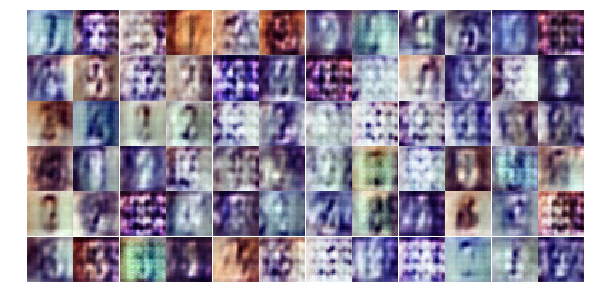

Epoch 5/25... Discriminator Loss: 1.0068... Generator Loss: 0.8686
Epoch 5/25... Discriminator Loss: 1.3677... Generator Loss: 0.6967
Epoch 5/25... Discriminator Loss: 1.2536... Generator Loss: 0.7478
Epoch 5/25... Discriminator Loss: 1.2378... Generator Loss: 0.8183
Epoch 5/25... Discriminator Loss: 1.1309... Generator Loss: 0.8246
Epoch 5/25... Discriminator Loss: 1.1382... Generator Loss: 0.7967
Epoch 5/25... Discriminator Loss: 1.2679... Generator Loss: 1.1692
Epoch 5/25... Discriminator Loss: 1.2067... Generator Loss: 1.0908
Epoch 5/25... Discriminator Loss: 1.1018... Generator Loss: 0.9508
Epoch 5/25... Discriminator Loss: 1.4646... Generator Loss: 0.9256


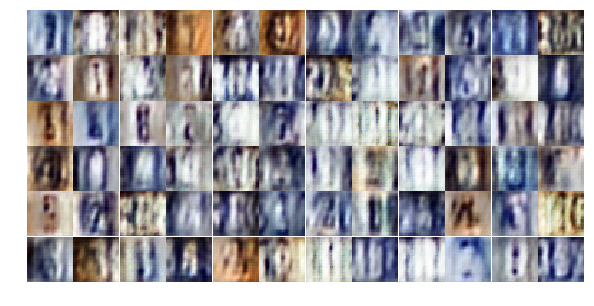

Epoch 5/25... Discriminator Loss: 1.1546... Generator Loss: 0.8247
Epoch 5/25... Discriminator Loss: 1.4351... Generator Loss: 0.6510
Epoch 5/25... Discriminator Loss: 1.1512... Generator Loss: 0.8588
Epoch 5/25... Discriminator Loss: 1.2415... Generator Loss: 0.7999
Epoch 5/25... Discriminator Loss: 1.2241... Generator Loss: 0.8032
Epoch 5/25... Discriminator Loss: 1.1072... Generator Loss: 0.8216
Epoch 5/25... Discriminator Loss: 1.2038... Generator Loss: 0.7549
Epoch 5/25... Discriminator Loss: 1.2379... Generator Loss: 1.0888
Epoch 5/25... Discriminator Loss: 1.2762... Generator Loss: 0.8153
Epoch 5/25... Discriminator Loss: 1.2065... Generator Loss: 0.6606


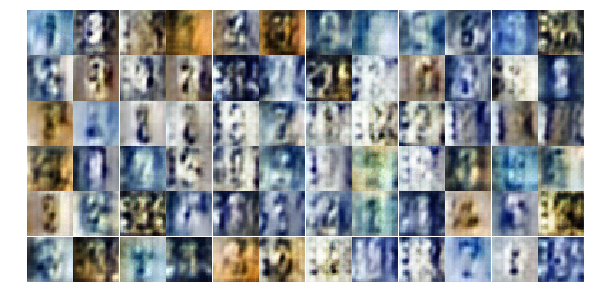

Epoch 5/25... Discriminator Loss: 1.1297... Generator Loss: 0.8560
Epoch 5/25... Discriminator Loss: 1.1312... Generator Loss: 0.7832
Epoch 5/25... Discriminator Loss: 1.1959... Generator Loss: 0.8495
Epoch 5/25... Discriminator Loss: 0.9420... Generator Loss: 1.6964
Epoch 5/25... Discriminator Loss: 1.2824... Generator Loss: 0.6710
Epoch 5/25... Discriminator Loss: 1.3230... Generator Loss: 0.7807
Epoch 6/25... Discriminator Loss: 1.2746... Generator Loss: 0.7556
Epoch 6/25... Discriminator Loss: 1.1821... Generator Loss: 0.7787
Epoch 6/25... Discriminator Loss: 1.2209... Generator Loss: 0.8459
Epoch 6/25... Discriminator Loss: 0.9198... Generator Loss: 0.9783


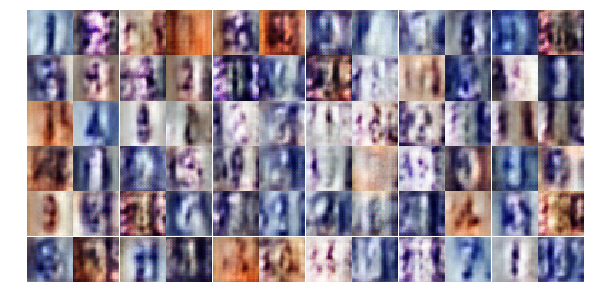

Epoch 6/25... Discriminator Loss: 1.1947... Generator Loss: 0.8050
Epoch 6/25... Discriminator Loss: 1.0476... Generator Loss: 0.8064
Epoch 6/25... Discriminator Loss: 1.2594... Generator Loss: 1.0215
Epoch 6/25... Discriminator Loss: 1.1386... Generator Loss: 0.8865
Epoch 6/25... Discriminator Loss: 1.1059... Generator Loss: 0.7932
Epoch 6/25... Discriminator Loss: 1.0864... Generator Loss: 1.0342
Epoch 6/25... Discriminator Loss: 1.2091... Generator Loss: 0.8673
Epoch 6/25... Discriminator Loss: 0.9925... Generator Loss: 0.9027
Epoch 6/25... Discriminator Loss: 1.3046... Generator Loss: 0.9821
Epoch 6/25... Discriminator Loss: 1.1590... Generator Loss: 0.9184


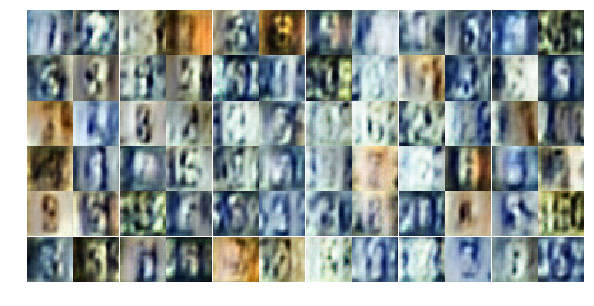

Epoch 6/25... Discriminator Loss: 1.1870... Generator Loss: 0.8723
Epoch 6/25... Discriminator Loss: 1.4551... Generator Loss: 0.8446
Epoch 6/25... Discriminator Loss: 1.1742... Generator Loss: 1.1593
Epoch 6/25... Discriminator Loss: 1.1861... Generator Loss: 0.8718
Epoch 6/25... Discriminator Loss: 1.0679... Generator Loss: 0.7810
Epoch 6/25... Discriminator Loss: 1.1633... Generator Loss: 0.8967
Epoch 6/25... Discriminator Loss: 1.1180... Generator Loss: 0.8535
Epoch 6/25... Discriminator Loss: 1.0254... Generator Loss: 1.0623
Epoch 6/25... Discriminator Loss: 1.2518... Generator Loss: 0.9125
Epoch 6/25... Discriminator Loss: 1.1662... Generator Loss: 0.7959


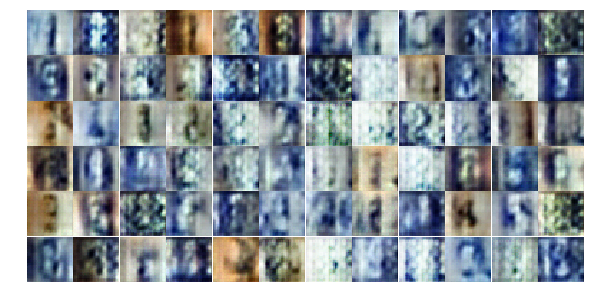

Epoch 6/25... Discriminator Loss: 0.7735... Generator Loss: 1.2579
Epoch 6/25... Discriminator Loss: 1.1775... Generator Loss: 0.7097
Epoch 6/25... Discriminator Loss: 1.1431... Generator Loss: 1.1099
Epoch 6/25... Discriminator Loss: 0.8264... Generator Loss: 1.3349
Epoch 6/25... Discriminator Loss: 0.9349... Generator Loss: 1.1483
Epoch 6/25... Discriminator Loss: 1.0120... Generator Loss: 1.2887
Epoch 6/25... Discriminator Loss: 1.0154... Generator Loss: 1.0154
Epoch 6/25... Discriminator Loss: 1.0962... Generator Loss: 1.0497
Epoch 6/25... Discriminator Loss: 1.2134... Generator Loss: 1.2516
Epoch 6/25... Discriminator Loss: 0.9152... Generator Loss: 1.0194


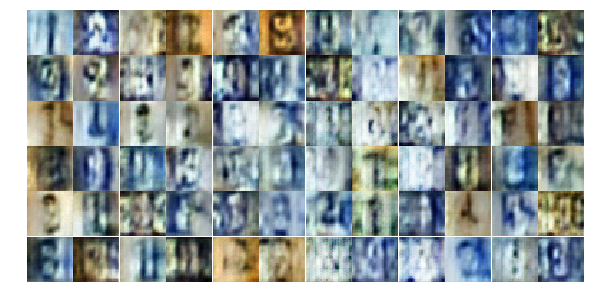

Epoch 6/25... Discriminator Loss: 1.1694... Generator Loss: 0.9680
Epoch 6/25... Discriminator Loss: 0.9978... Generator Loss: 1.0961
Epoch 6/25... Discriminator Loss: 1.1772... Generator Loss: 0.8920
Epoch 6/25... Discriminator Loss: 1.3062... Generator Loss: 1.3733
Epoch 6/25... Discriminator Loss: 1.2321... Generator Loss: 0.9390
Epoch 6/25... Discriminator Loss: 0.8771... Generator Loss: 1.2352
Epoch 6/25... Discriminator Loss: 1.0095... Generator Loss: 1.0511
Epoch 6/25... Discriminator Loss: 0.9733... Generator Loss: 1.0877
Epoch 6/25... Discriminator Loss: 0.9793... Generator Loss: 0.8293
Epoch 6/25... Discriminator Loss: 1.0256... Generator Loss: 0.9490


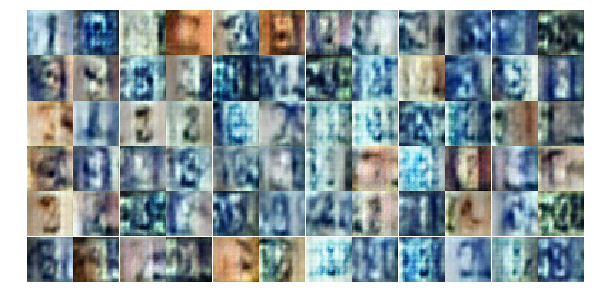

Epoch 6/25... Discriminator Loss: 1.2182... Generator Loss: 1.1641
Epoch 6/25... Discriminator Loss: 1.0887... Generator Loss: 0.9564
Epoch 6/25... Discriminator Loss: 1.0413... Generator Loss: 0.9380
Epoch 6/25... Discriminator Loss: 1.1808... Generator Loss: 0.9518
Epoch 6/25... Discriminator Loss: 1.1214... Generator Loss: 1.0151
Epoch 6/25... Discriminator Loss: 1.0536... Generator Loss: 0.9770
Epoch 6/25... Discriminator Loss: 1.1801... Generator Loss: 1.0092
Epoch 6/25... Discriminator Loss: 1.0758... Generator Loss: 1.0232
Epoch 6/25... Discriminator Loss: 1.0739... Generator Loss: 0.9962
Epoch 6/25... Discriminator Loss: 1.0174... Generator Loss: 1.0508


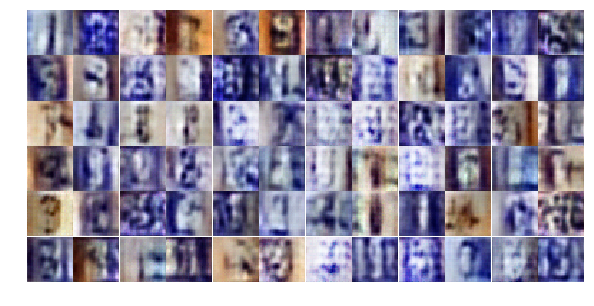

Epoch 6/25... Discriminator Loss: 1.1314... Generator Loss: 0.8516
Epoch 6/25... Discriminator Loss: 1.2230... Generator Loss: 1.0315
Epoch 6/25... Discriminator Loss: 1.0656... Generator Loss: 0.8677
Epoch 7/25... Discriminator Loss: 1.1594... Generator Loss: 0.8066
Epoch 7/25... Discriminator Loss: 1.0932... Generator Loss: 1.0342
Epoch 7/25... Discriminator Loss: 1.0349... Generator Loss: 0.9188
Epoch 7/25... Discriminator Loss: 1.1636... Generator Loss: 1.0239
Epoch 7/25... Discriminator Loss: 1.1599... Generator Loss: 0.8607
Epoch 7/25... Discriminator Loss: 1.1541... Generator Loss: 0.8293
Epoch 7/25... Discriminator Loss: 1.1344... Generator Loss: 0.9350


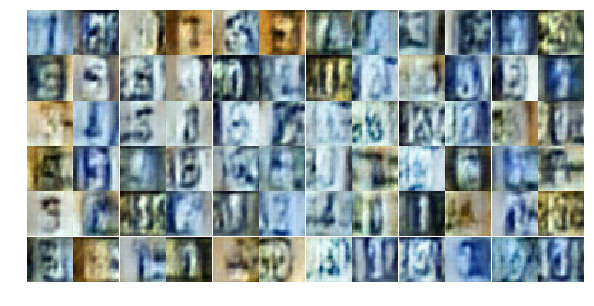

Epoch 7/25... Discriminator Loss: 1.1578... Generator Loss: 0.9185
Epoch 7/25... Discriminator Loss: 1.0475... Generator Loss: 0.9510
Epoch 7/25... Discriminator Loss: 1.2732... Generator Loss: 1.1365
Epoch 7/25... Discriminator Loss: 1.0724... Generator Loss: 0.9104
Epoch 7/25... Discriminator Loss: 1.2063... Generator Loss: 1.0102
Epoch 7/25... Discriminator Loss: 1.0325... Generator Loss: 0.9392
Epoch 7/25... Discriminator Loss: 1.1565... Generator Loss: 0.8257
Epoch 7/25... Discriminator Loss: 1.1745... Generator Loss: 0.9470
Epoch 7/25... Discriminator Loss: 1.1821... Generator Loss: 0.7756
Epoch 7/25... Discriminator Loss: 1.0540... Generator Loss: 0.9521


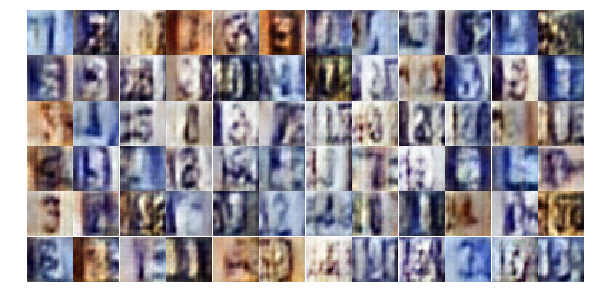

Epoch 7/25... Discriminator Loss: 1.0980... Generator Loss: 1.0075
Epoch 7/25... Discriminator Loss: 1.1284... Generator Loss: 0.9492
Epoch 7/25... Discriminator Loss: 1.2028... Generator Loss: 0.8425
Epoch 7/25... Discriminator Loss: 1.1183... Generator Loss: 0.8693
Epoch 7/25... Discriminator Loss: 1.0335... Generator Loss: 1.0074
Epoch 7/25... Discriminator Loss: 1.4699... Generator Loss: 1.2708
Epoch 7/25... Discriminator Loss: 1.1569... Generator Loss: 0.9119
Epoch 7/25... Discriminator Loss: 0.9833... Generator Loss: 0.9948
Epoch 7/25... Discriminator Loss: 1.0860... Generator Loss: 1.0149
Epoch 7/25... Discriminator Loss: 1.1514... Generator Loss: 0.9008


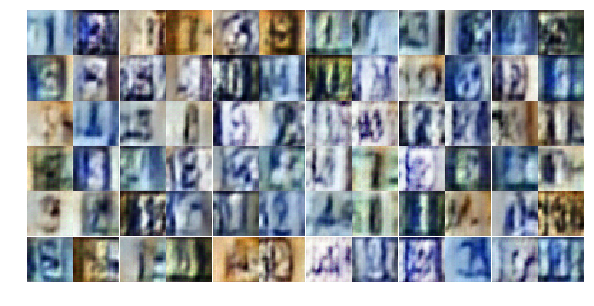

Epoch 7/25... Discriminator Loss: 1.1784... Generator Loss: 0.8071
Epoch 7/25... Discriminator Loss: 1.1626... Generator Loss: 0.9720
Epoch 7/25... Discriminator Loss: 1.0389... Generator Loss: 1.0252
Epoch 7/25... Discriminator Loss: 1.0499... Generator Loss: 0.9953
Epoch 7/25... Discriminator Loss: 1.1732... Generator Loss: 0.8432
Epoch 7/25... Discriminator Loss: 1.1656... Generator Loss: 0.7638
Epoch 7/25... Discriminator Loss: 1.1754... Generator Loss: 1.0332
Epoch 7/25... Discriminator Loss: 1.1301... Generator Loss: 0.9196
Epoch 7/25... Discriminator Loss: 1.0243... Generator Loss: 1.2024
Epoch 7/25... Discriminator Loss: 1.1106... Generator Loss: 0.8538


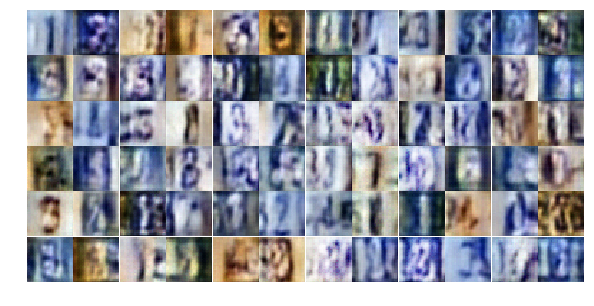

Epoch 7/25... Discriminator Loss: 1.1194... Generator Loss: 0.9586
Epoch 7/25... Discriminator Loss: 1.1383... Generator Loss: 0.9968
Epoch 7/25... Discriminator Loss: 1.0460... Generator Loss: 1.0816
Epoch 7/25... Discriminator Loss: 1.1605... Generator Loss: 0.7340
Epoch 7/25... Discriminator Loss: 1.0054... Generator Loss: 0.9549
Epoch 7/25... Discriminator Loss: 1.2027... Generator Loss: 1.1294
Epoch 7/25... Discriminator Loss: 1.1398... Generator Loss: 0.8265
Epoch 7/25... Discriminator Loss: 1.1521... Generator Loss: 0.7696
Epoch 7/25... Discriminator Loss: 0.9858... Generator Loss: 1.0989
Epoch 7/25... Discriminator Loss: 1.2148... Generator Loss: 0.7917


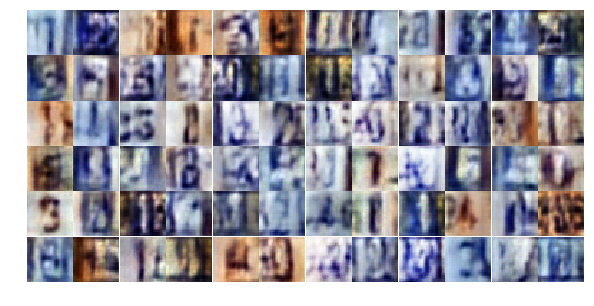

Epoch 7/25... Discriminator Loss: 1.0907... Generator Loss: 0.9916
Epoch 7/25... Discriminator Loss: 1.1009... Generator Loss: 0.8313
Epoch 7/25... Discriminator Loss: 1.2226... Generator Loss: 1.1275
Epoch 7/25... Discriminator Loss: 1.0154... Generator Loss: 0.8443
Epoch 7/25... Discriminator Loss: 1.0323... Generator Loss: 1.1772
Epoch 7/25... Discriminator Loss: 1.1730... Generator Loss: 0.8135
Epoch 7/25... Discriminator Loss: 1.1183... Generator Loss: 0.9073
Epoch 7/25... Discriminator Loss: 1.0983... Generator Loss: 0.9112
Epoch 7/25... Discriminator Loss: 1.0419... Generator Loss: 0.9141
Epoch 7/25... Discriminator Loss: 1.1554... Generator Loss: 0.8583


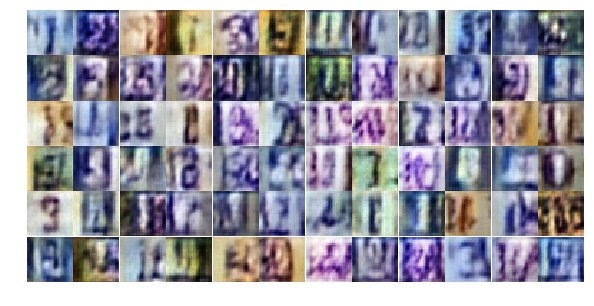

Epoch 7/25... Discriminator Loss: 1.0201... Generator Loss: 1.2143
Epoch 8/25... Discriminator Loss: 1.1579... Generator Loss: 1.0500
Epoch 8/25... Discriminator Loss: 1.1519... Generator Loss: 1.1090
Epoch 8/25... Discriminator Loss: 1.1067... Generator Loss: 0.8654
Epoch 8/25... Discriminator Loss: 1.1472... Generator Loss: 0.8384
Epoch 8/25... Discriminator Loss: 1.2517... Generator Loss: 1.2028
Epoch 8/25... Discriminator Loss: 1.2364... Generator Loss: 0.9287
Epoch 8/25... Discriminator Loss: 1.0494... Generator Loss: 1.1446
Epoch 8/25... Discriminator Loss: 1.1167... Generator Loss: 0.8741
Epoch 8/25... Discriminator Loss: 1.1331... Generator Loss: 0.9064


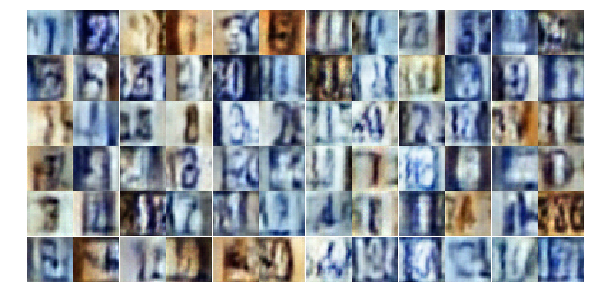

Epoch 8/25... Discriminator Loss: 1.1094... Generator Loss: 0.9054
Epoch 8/25... Discriminator Loss: 1.0952... Generator Loss: 0.9014
Epoch 8/25... Discriminator Loss: 1.1822... Generator Loss: 0.9171
Epoch 8/25... Discriminator Loss: 1.1148... Generator Loss: 0.9778
Epoch 8/25... Discriminator Loss: 1.1443... Generator Loss: 1.2062
Epoch 8/25... Discriminator Loss: 1.1102... Generator Loss: 0.9403
Epoch 8/25... Discriminator Loss: 1.1423... Generator Loss: 0.8253
Epoch 8/25... Discriminator Loss: 1.0760... Generator Loss: 0.9907
Epoch 8/25... Discriminator Loss: 1.1274... Generator Loss: 0.9092
Epoch 8/25... Discriminator Loss: 1.2543... Generator Loss: 0.7676


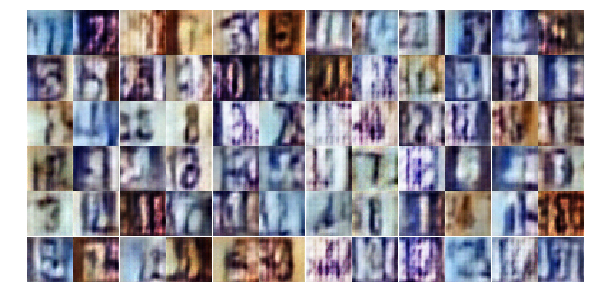

Epoch 8/25... Discriminator Loss: 1.1073... Generator Loss: 0.7791
Epoch 8/25... Discriminator Loss: 1.1800... Generator Loss: 0.9220
Epoch 8/25... Discriminator Loss: 1.1796... Generator Loss: 0.8524
Epoch 8/25... Discriminator Loss: 1.2096... Generator Loss: 0.7782
Epoch 8/25... Discriminator Loss: 1.0780... Generator Loss: 0.9614
Epoch 8/25... Discriminator Loss: 1.0492... Generator Loss: 0.9443
Epoch 8/25... Discriminator Loss: 1.1159... Generator Loss: 0.9641
Epoch 8/25... Discriminator Loss: 1.2429... Generator Loss: 0.9069
Epoch 8/25... Discriminator Loss: 1.1109... Generator Loss: 0.8811
Epoch 8/25... Discriminator Loss: 1.1659... Generator Loss: 0.9035


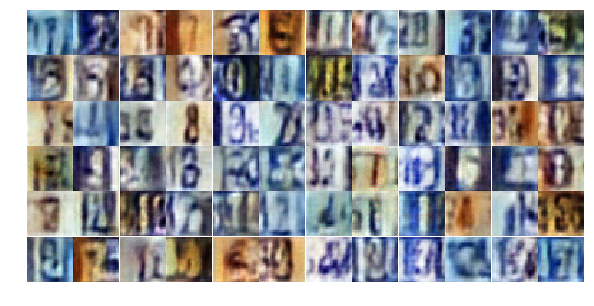

Epoch 8/25... Discriminator Loss: 1.2039... Generator Loss: 0.8031
Epoch 8/25... Discriminator Loss: 1.1338... Generator Loss: 0.8520
Epoch 8/25... Discriminator Loss: 1.1803... Generator Loss: 1.1746
Epoch 8/25... Discriminator Loss: 1.1305... Generator Loss: 0.9898
Epoch 8/25... Discriminator Loss: 1.1517... Generator Loss: 0.8715
Epoch 8/25... Discriminator Loss: 1.1754... Generator Loss: 0.8573
Epoch 8/25... Discriminator Loss: 1.1086... Generator Loss: 0.9173
Epoch 8/25... Discriminator Loss: 1.0234... Generator Loss: 0.9402
Epoch 8/25... Discriminator Loss: 1.2785... Generator Loss: 0.8763
Epoch 8/25... Discriminator Loss: 1.1368... Generator Loss: 0.8098


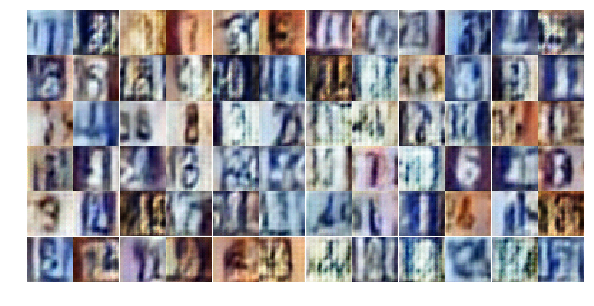

Epoch 8/25... Discriminator Loss: 1.2536... Generator Loss: 0.8422
Epoch 8/25... Discriminator Loss: 1.1704... Generator Loss: 0.7751
Epoch 8/25... Discriminator Loss: 1.2591... Generator Loss: 0.8470
Epoch 8/25... Discriminator Loss: 1.1804... Generator Loss: 0.9515
Epoch 8/25... Discriminator Loss: 1.1685... Generator Loss: 0.8873
Epoch 8/25... Discriminator Loss: 1.0597... Generator Loss: 0.8773
Epoch 8/25... Discriminator Loss: 1.1265... Generator Loss: 0.8770
Epoch 8/25... Discriminator Loss: 1.2149... Generator Loss: 0.8388
Epoch 8/25... Discriminator Loss: 1.1890... Generator Loss: 0.8212
Epoch 8/25... Discriminator Loss: 1.1676... Generator Loss: 0.8860


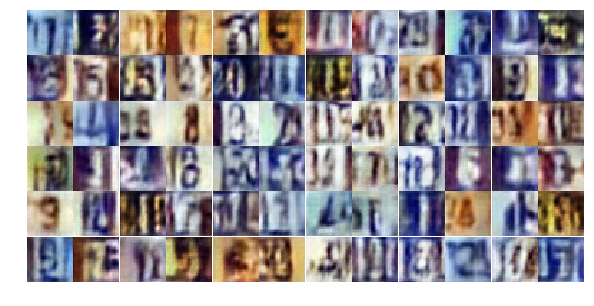

Epoch 8/25... Discriminator Loss: 1.2478... Generator Loss: 0.8056
Epoch 8/25... Discriminator Loss: 1.1409... Generator Loss: 0.9122
Epoch 8/25... Discriminator Loss: 1.1516... Generator Loss: 0.8839
Epoch 8/25... Discriminator Loss: 1.1359... Generator Loss: 0.9638
Epoch 8/25... Discriminator Loss: 1.1814... Generator Loss: 0.9582
Epoch 8/25... Discriminator Loss: 1.2386... Generator Loss: 0.8567
Epoch 8/25... Discriminator Loss: 1.1942... Generator Loss: 0.9908
Epoch 8/25... Discriminator Loss: 1.2381... Generator Loss: 1.2182
Epoch 9/25... Discriminator Loss: 1.2177... Generator Loss: 0.7290
Epoch 9/25... Discriminator Loss: 1.2075... Generator Loss: 0.8368


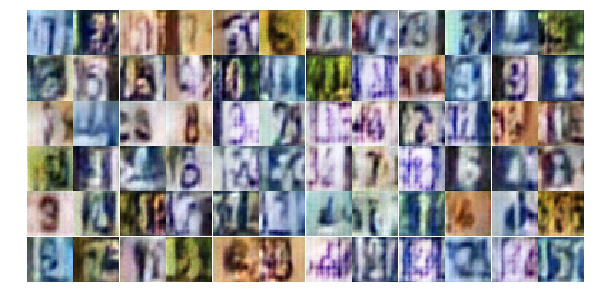

Epoch 9/25... Discriminator Loss: 1.5279... Generator Loss: 1.2946
Epoch 9/25... Discriminator Loss: 1.1551... Generator Loss: 0.9431
Epoch 9/25... Discriminator Loss: 1.1361... Generator Loss: 0.8925
Epoch 9/25... Discriminator Loss: 1.2216... Generator Loss: 0.8949
Epoch 9/25... Discriminator Loss: 1.2020... Generator Loss: 0.9204
Epoch 9/25... Discriminator Loss: 1.1879... Generator Loss: 0.8391
Epoch 9/25... Discriminator Loss: 1.1871... Generator Loss: 0.7621
Epoch 9/25... Discriminator Loss: 1.1601... Generator Loss: 0.9265
Epoch 9/25... Discriminator Loss: 1.1135... Generator Loss: 0.8592
Epoch 9/25... Discriminator Loss: 1.1885... Generator Loss: 0.9237


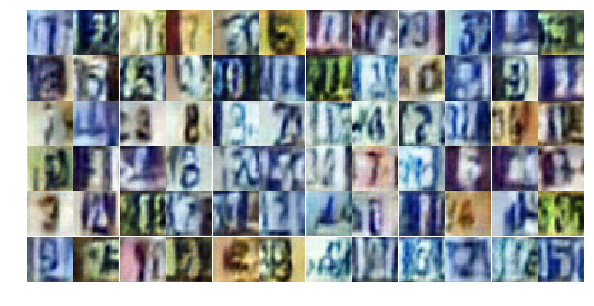

Epoch 9/25... Discriminator Loss: 1.0412... Generator Loss: 0.9448
Epoch 9/25... Discriminator Loss: 0.9896... Generator Loss: 0.9407
Epoch 9/25... Discriminator Loss: 1.4524... Generator Loss: 0.9132
Epoch 9/25... Discriminator Loss: 1.1489... Generator Loss: 0.8692
Epoch 9/25... Discriminator Loss: 1.1652... Generator Loss: 0.9473
Epoch 9/25... Discriminator Loss: 1.2196... Generator Loss: 0.8928
Epoch 9/25... Discriminator Loss: 1.2144... Generator Loss: 0.8625
Epoch 9/25... Discriminator Loss: 1.1198... Generator Loss: 0.9104
Epoch 9/25... Discriminator Loss: 1.1524... Generator Loss: 0.8183
Epoch 9/25... Discriminator Loss: 1.2242... Generator Loss: 0.7730


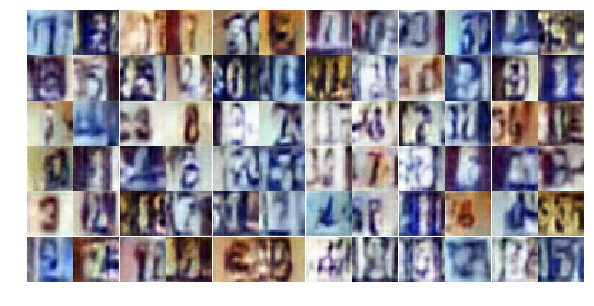

Epoch 9/25... Discriminator Loss: 1.1988... Generator Loss: 1.0348
Epoch 9/25... Discriminator Loss: 1.1218... Generator Loss: 0.9279
Epoch 9/25... Discriminator Loss: 1.1759... Generator Loss: 0.7650
Epoch 9/25... Discriminator Loss: 1.2701... Generator Loss: 1.0739
Epoch 9/25... Discriminator Loss: 1.2027... Generator Loss: 0.8169
Epoch 9/25... Discriminator Loss: 1.0817... Generator Loss: 0.8120
Epoch 9/25... Discriminator Loss: 1.0374... Generator Loss: 0.9228
Epoch 9/25... Discriminator Loss: 1.1909... Generator Loss: 0.8400
Epoch 9/25... Discriminator Loss: 1.2572... Generator Loss: 0.8006
Epoch 9/25... Discriminator Loss: 1.0997... Generator Loss: 0.8284


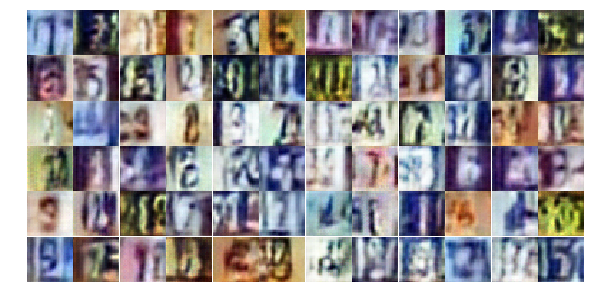

Epoch 9/25... Discriminator Loss: 1.1987... Generator Loss: 1.0119
Epoch 9/25... Discriminator Loss: 1.1361... Generator Loss: 0.9254
Epoch 9/25... Discriminator Loss: 1.2249... Generator Loss: 0.8771
Epoch 9/25... Discriminator Loss: 1.1296... Generator Loss: 0.9070
Epoch 9/25... Discriminator Loss: 1.1596... Generator Loss: 0.9389
Epoch 9/25... Discriminator Loss: 1.1495... Generator Loss: 0.8296
Epoch 9/25... Discriminator Loss: 1.1609... Generator Loss: 0.9248
Epoch 9/25... Discriminator Loss: 1.0305... Generator Loss: 1.0012
Epoch 9/25... Discriminator Loss: 1.1912... Generator Loss: 0.7310
Epoch 9/25... Discriminator Loss: 1.0775... Generator Loss: 0.9940


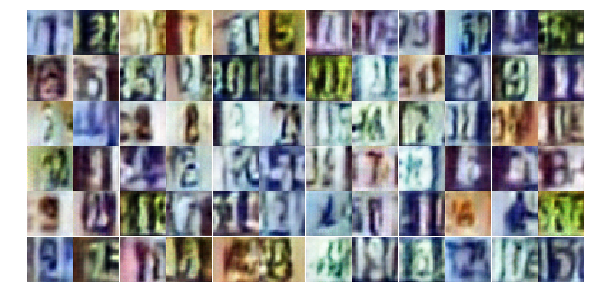

Epoch 9/25... Discriminator Loss: 1.1665... Generator Loss: 0.8988
Epoch 9/25... Discriminator Loss: 1.2714... Generator Loss: 0.8565
Epoch 9/25... Discriminator Loss: 1.1661... Generator Loss: 0.8069
Epoch 9/25... Discriminator Loss: 1.1473... Generator Loss: 0.9803
Epoch 9/25... Discriminator Loss: 1.0822... Generator Loss: 0.8425
Epoch 9/25... Discriminator Loss: 1.1638... Generator Loss: 0.8814
Epoch 9/25... Discriminator Loss: 1.0558... Generator Loss: 0.8396
Epoch 9/25... Discriminator Loss: 1.1510... Generator Loss: 0.8322
Epoch 9/25... Discriminator Loss: 1.0570... Generator Loss: 1.0529
Epoch 9/25... Discriminator Loss: 1.1891... Generator Loss: 0.9435


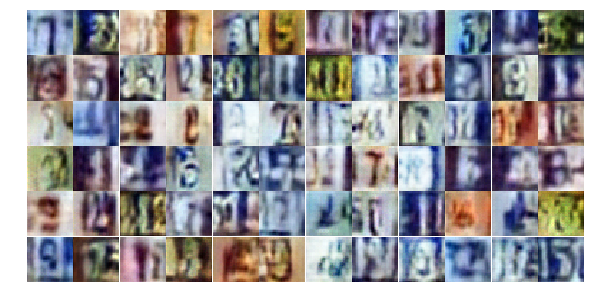

Epoch 9/25... Discriminator Loss: 1.2072... Generator Loss: 0.7957
Epoch 9/25... Discriminator Loss: 1.0869... Generator Loss: 0.9211
Epoch 9/25... Discriminator Loss: 1.1446... Generator Loss: 0.9680
Epoch 9/25... Discriminator Loss: 1.2335... Generator Loss: 0.7216
Epoch 9/25... Discriminator Loss: 1.1488... Generator Loss: 0.8572
Epoch 10/25... Discriminator Loss: 1.1436... Generator Loss: 0.9589
Epoch 10/25... Discriminator Loss: 1.0090... Generator Loss: 1.0096
Epoch 10/25... Discriminator Loss: 1.1324... Generator Loss: 0.8654
Epoch 10/25... Discriminator Loss: 1.1991... Generator Loss: 0.7392
Epoch 10/25... Discriminator Loss: 1.1494... Generator Loss: 0.8317


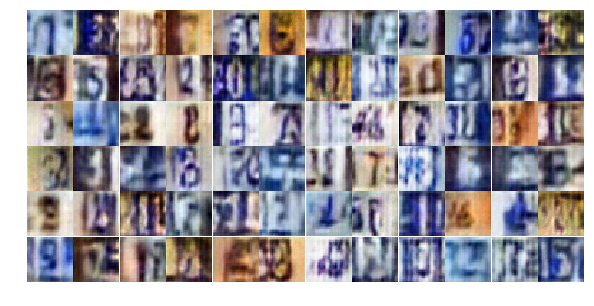

Epoch 10/25... Discriminator Loss: 1.3170... Generator Loss: 0.9680
Epoch 10/25... Discriminator Loss: 1.1588... Generator Loss: 0.9707
Epoch 10/25... Discriminator Loss: 1.0706... Generator Loss: 0.9975
Epoch 10/25... Discriminator Loss: 1.1713... Generator Loss: 0.7977
Epoch 10/25... Discriminator Loss: 1.1765... Generator Loss: 0.8216
Epoch 10/25... Discriminator Loss: 1.2495... Generator Loss: 0.9812
Epoch 10/25... Discriminator Loss: 0.9679... Generator Loss: 0.9564
Epoch 10/25... Discriminator Loss: 1.2058... Generator Loss: 0.8256
Epoch 10/25... Discriminator Loss: 1.1148... Generator Loss: 0.9378
Epoch 10/25... Discriminator Loss: 1.0658... Generator Loss: 0.9818


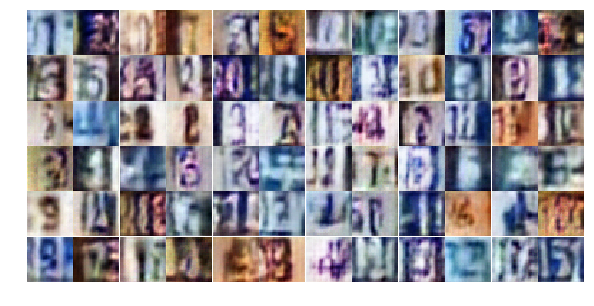

Epoch 10/25... Discriminator Loss: 1.1237... Generator Loss: 0.9318
Epoch 10/25... Discriminator Loss: 1.2682... Generator Loss: 0.8106
Epoch 10/25... Discriminator Loss: 1.2494... Generator Loss: 0.8727
Epoch 10/25... Discriminator Loss: 1.1282... Generator Loss: 1.0245
Epoch 10/25... Discriminator Loss: 1.1505... Generator Loss: 0.7763
Epoch 10/25... Discriminator Loss: 1.1047... Generator Loss: 0.9773
Epoch 10/25... Discriminator Loss: 1.1635... Generator Loss: 0.8139
Epoch 10/25... Discriminator Loss: 1.1085... Generator Loss: 0.8465
Epoch 10/25... Discriminator Loss: 1.1528... Generator Loss: 0.9188
Epoch 10/25... Discriminator Loss: 1.1903... Generator Loss: 0.8439


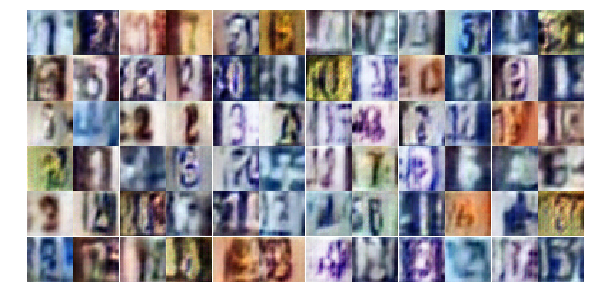

Epoch 10/25... Discriminator Loss: 1.1895... Generator Loss: 0.8796
Epoch 10/25... Discriminator Loss: 1.0941... Generator Loss: 0.9002
Epoch 10/25... Discriminator Loss: 1.1643... Generator Loss: 0.8456
Epoch 10/25... Discriminator Loss: 1.1271... Generator Loss: 0.8687
Epoch 10/25... Discriminator Loss: 1.2068... Generator Loss: 0.7584
Epoch 10/25... Discriminator Loss: 1.0923... Generator Loss: 0.9346
Epoch 10/25... Discriminator Loss: 1.0045... Generator Loss: 1.0306
Epoch 10/25... Discriminator Loss: 1.1659... Generator Loss: 0.8801
Epoch 10/25... Discriminator Loss: 1.1871... Generator Loss: 0.8575
Epoch 10/25... Discriminator Loss: 1.3215... Generator Loss: 0.8889


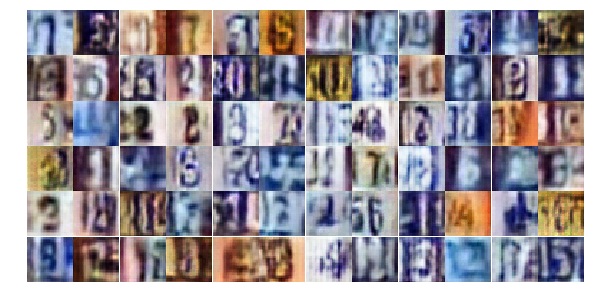

Epoch 10/25... Discriminator Loss: 1.1548... Generator Loss: 0.7914
Epoch 10/25... Discriminator Loss: 1.2148... Generator Loss: 0.9127
Epoch 10/25... Discriminator Loss: 1.0688... Generator Loss: 0.9452
Epoch 10/25... Discriminator Loss: 1.1442... Generator Loss: 0.8105
Epoch 10/25... Discriminator Loss: 1.1357... Generator Loss: 0.8243
Epoch 10/25... Discriminator Loss: 1.1798... Generator Loss: 0.9188
Epoch 10/25... Discriminator Loss: 1.1015... Generator Loss: 0.9143
Epoch 10/25... Discriminator Loss: 1.1576... Generator Loss: 0.9074
Epoch 10/25... Discriminator Loss: 1.0940... Generator Loss: 0.8481
Epoch 10/25... Discriminator Loss: 1.1337... Generator Loss: 1.0363


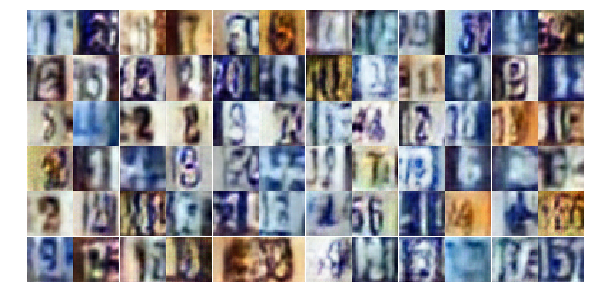

Epoch 10/25... Discriminator Loss: 1.1827... Generator Loss: 0.9329
Epoch 10/25... Discriminator Loss: 1.1120... Generator Loss: 0.9423
Epoch 10/25... Discriminator Loss: 1.2396... Generator Loss: 0.8156
Epoch 10/25... Discriminator Loss: 1.1684... Generator Loss: 0.7531
Epoch 10/25... Discriminator Loss: 1.1983... Generator Loss: 0.8823
Epoch 10/25... Discriminator Loss: 1.1536... Generator Loss: 0.9341
Epoch 10/25... Discriminator Loss: 1.1090... Generator Loss: 0.8509
Epoch 10/25... Discriminator Loss: 1.0111... Generator Loss: 0.8602
Epoch 10/25... Discriminator Loss: 1.1959... Generator Loss: 1.1174
Epoch 10/25... Discriminator Loss: 1.2054... Generator Loss: 0.8859


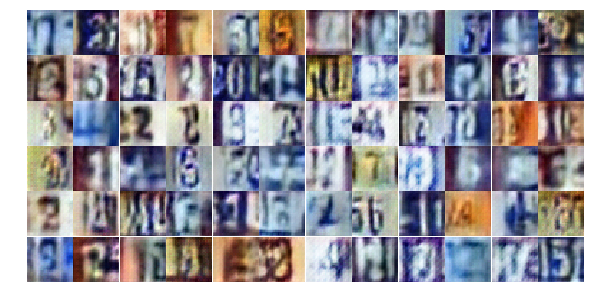

Epoch 10/25... Discriminator Loss: 1.2035... Generator Loss: 0.8543
Epoch 10/25... Discriminator Loss: 1.1109... Generator Loss: 1.0475
Epoch 10/25... Discriminator Loss: 1.0838... Generator Loss: 0.8546
Epoch 11/25... Discriminator Loss: 1.1346... Generator Loss: 0.8650
Epoch 11/25... Discriminator Loss: 1.0842... Generator Loss: 0.9308
Epoch 11/25... Discriminator Loss: 1.4201... Generator Loss: 0.6963
Epoch 11/25... Discriminator Loss: 1.2757... Generator Loss: 0.7503
Epoch 11/25... Discriminator Loss: 1.0538... Generator Loss: 0.9817
Epoch 11/25... Discriminator Loss: 1.2343... Generator Loss: 0.7913
Epoch 11/25... Discriminator Loss: 1.0790... Generator Loss: 0.9176


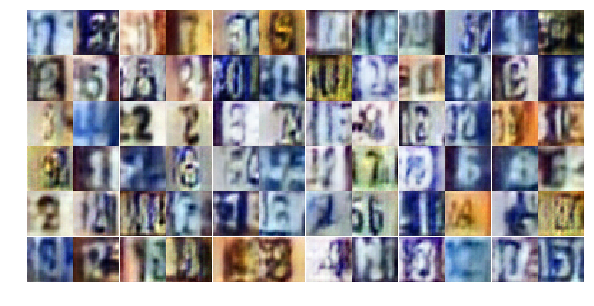

Epoch 11/25... Discriminator Loss: 1.0584... Generator Loss: 1.0213
Epoch 11/25... Discriminator Loss: 1.1752... Generator Loss: 0.7796
Epoch 11/25... Discriminator Loss: 0.9733... Generator Loss: 0.9875
Epoch 11/25... Discriminator Loss: 1.1973... Generator Loss: 0.8475
Epoch 11/25... Discriminator Loss: 1.2645... Generator Loss: 0.7254
Epoch 11/25... Discriminator Loss: 1.2473... Generator Loss: 0.8401
Epoch 11/25... Discriminator Loss: 1.1189... Generator Loss: 1.0809
Epoch 11/25... Discriminator Loss: 1.1090... Generator Loss: 1.0850
Epoch 11/25... Discriminator Loss: 1.0825... Generator Loss: 0.8318
Epoch 11/25... Discriminator Loss: 1.2200... Generator Loss: 0.8030


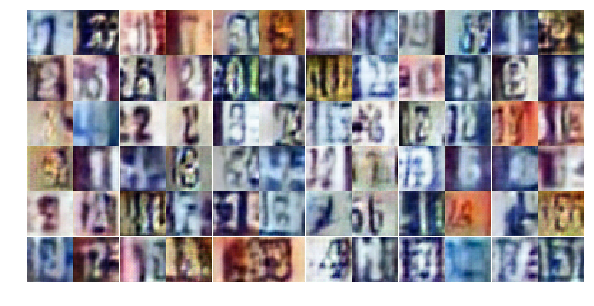

Epoch 11/25... Discriminator Loss: 1.2279... Generator Loss: 0.9200
Epoch 11/25... Discriminator Loss: 1.0733... Generator Loss: 0.9527
Epoch 11/25... Discriminator Loss: 1.2951... Generator Loss: 0.8983
Epoch 11/25... Discriminator Loss: 1.0608... Generator Loss: 0.9226
Epoch 11/25... Discriminator Loss: 1.1283... Generator Loss: 0.9200
Epoch 11/25... Discriminator Loss: 0.9862... Generator Loss: 0.9115
Epoch 11/25... Discriminator Loss: 1.2236... Generator Loss: 0.8218
Epoch 11/25... Discriminator Loss: 1.3068... Generator Loss: 0.8032
Epoch 11/25... Discriminator Loss: 1.1629... Generator Loss: 0.8881
Epoch 11/25... Discriminator Loss: 1.2263... Generator Loss: 0.8162


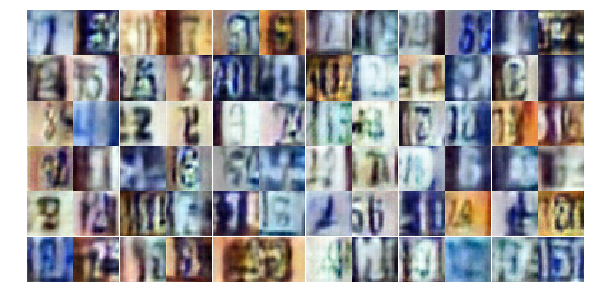

Epoch 11/25... Discriminator Loss: 1.1815... Generator Loss: 0.8121
Epoch 11/25... Discriminator Loss: 1.1431... Generator Loss: 0.9371
Epoch 11/25... Discriminator Loss: 1.2036... Generator Loss: 0.8698
Epoch 11/25... Discriminator Loss: 1.1041... Generator Loss: 0.9136
Epoch 11/25... Discriminator Loss: 1.1646... Generator Loss: 1.0540
Epoch 11/25... Discriminator Loss: 1.1262... Generator Loss: 0.8225
Epoch 11/25... Discriminator Loss: 1.1418... Generator Loss: 0.9533
Epoch 11/25... Discriminator Loss: 1.1354... Generator Loss: 0.8376
Epoch 11/25... Discriminator Loss: 1.1466... Generator Loss: 0.8566
Epoch 11/25... Discriminator Loss: 1.0040... Generator Loss: 0.9696


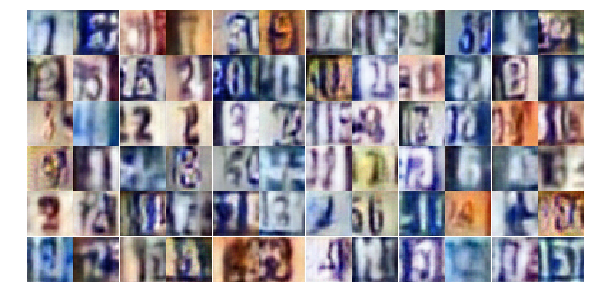

Epoch 11/25... Discriminator Loss: 1.0640... Generator Loss: 0.9771
Epoch 11/25... Discriminator Loss: 1.1217... Generator Loss: 0.9467
Epoch 11/25... Discriminator Loss: 1.2196... Generator Loss: 0.8945
Epoch 11/25... Discriminator Loss: 1.1776... Generator Loss: 0.8079
Epoch 11/25... Discriminator Loss: 1.2120... Generator Loss: 0.7832
Epoch 11/25... Discriminator Loss: 1.1786... Generator Loss: 0.8732
Epoch 11/25... Discriminator Loss: 1.1792... Generator Loss: 0.8887
Epoch 11/25... Discriminator Loss: 1.1935... Generator Loss: 0.9142
Epoch 11/25... Discriminator Loss: 1.1427... Generator Loss: 0.7493
Epoch 11/25... Discriminator Loss: 1.1592... Generator Loss: 0.8696


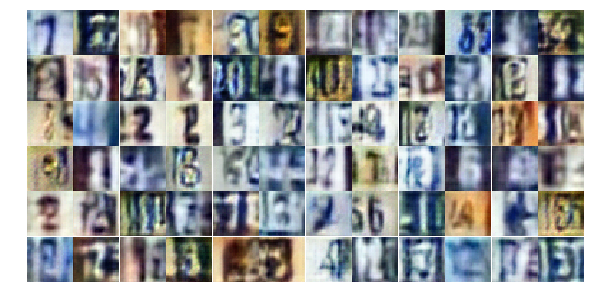

Epoch 11/25... Discriminator Loss: 1.1112... Generator Loss: 0.8985
Epoch 11/25... Discriminator Loss: 1.1261... Generator Loss: 0.9283
Epoch 11/25... Discriminator Loss: 1.2119... Generator Loss: 0.7235
Epoch 11/25... Discriminator Loss: 1.1877... Generator Loss: 0.8387
Epoch 11/25... Discriminator Loss: 1.1736... Generator Loss: 0.8429
Epoch 11/25... Discriminator Loss: 1.1316... Generator Loss: 0.9036
Epoch 11/25... Discriminator Loss: 1.2102... Generator Loss: 0.7821
Epoch 11/25... Discriminator Loss: 1.1566... Generator Loss: 0.9120
Epoch 11/25... Discriminator Loss: 1.2695... Generator Loss: 0.8135
Epoch 11/25... Discriminator Loss: 1.2584... Generator Loss: 0.9458


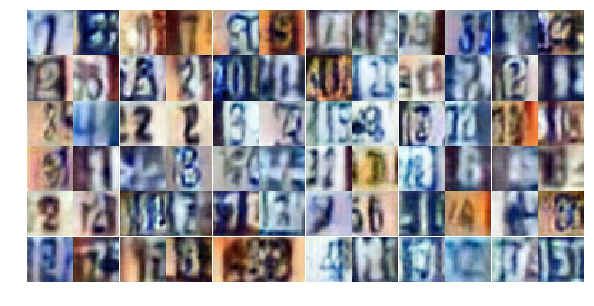

Epoch 12/25... Discriminator Loss: 1.1176... Generator Loss: 0.8674
Epoch 12/25... Discriminator Loss: 1.1529... Generator Loss: 0.8855
Epoch 12/25... Discriminator Loss: 1.2259... Generator Loss: 0.9030
Epoch 12/25... Discriminator Loss: 1.1372... Generator Loss: 0.8690
Epoch 12/25... Discriminator Loss: 1.2630... Generator Loss: 0.7842
Epoch 12/25... Discriminator Loss: 1.1054... Generator Loss: 0.8842
Epoch 12/25... Discriminator Loss: 1.1810... Generator Loss: 0.9194
Epoch 12/25... Discriminator Loss: 1.1397... Generator Loss: 1.0066
Epoch 12/25... Discriminator Loss: 1.1332... Generator Loss: 0.8659
Epoch 12/25... Discriminator Loss: 1.1961... Generator Loss: 0.7721


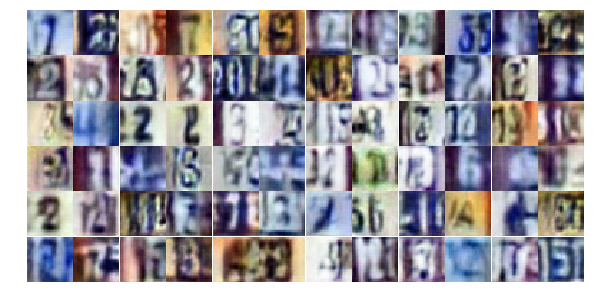

Epoch 12/25... Discriminator Loss: 1.1162... Generator Loss: 0.8674
Epoch 12/25... Discriminator Loss: 1.2040... Generator Loss: 0.8295
Epoch 12/25... Discriminator Loss: 1.0720... Generator Loss: 0.9711
Epoch 12/25... Discriminator Loss: 1.2024... Generator Loss: 0.9034
Epoch 12/25... Discriminator Loss: 1.1220... Generator Loss: 0.9307
Epoch 12/25... Discriminator Loss: 1.2397... Generator Loss: 0.7183
Epoch 12/25... Discriminator Loss: 1.2095... Generator Loss: 0.8155
Epoch 12/25... Discriminator Loss: 0.9994... Generator Loss: 0.9160
Epoch 12/25... Discriminator Loss: 1.1836... Generator Loss: 0.9617
Epoch 12/25... Discriminator Loss: 1.1705... Generator Loss: 0.8236


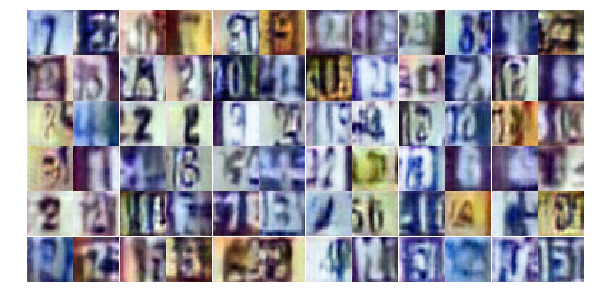

Epoch 12/25... Discriminator Loss: 1.1699... Generator Loss: 0.9219
Epoch 12/25... Discriminator Loss: 1.0989... Generator Loss: 0.9453
Epoch 12/25... Discriminator Loss: 1.1797... Generator Loss: 0.8275
Epoch 12/25... Discriminator Loss: 1.1458... Generator Loss: 0.9669
Epoch 12/25... Discriminator Loss: 1.1754... Generator Loss: 0.9229
Epoch 12/25... Discriminator Loss: 1.1467... Generator Loss: 1.0785
Epoch 12/25... Discriminator Loss: 1.1826... Generator Loss: 0.9440
Epoch 12/25... Discriminator Loss: 1.1578... Generator Loss: 1.0075
Epoch 12/25... Discriminator Loss: 1.1142... Generator Loss: 0.8965
Epoch 12/25... Discriminator Loss: 1.1767... Generator Loss: 1.0890


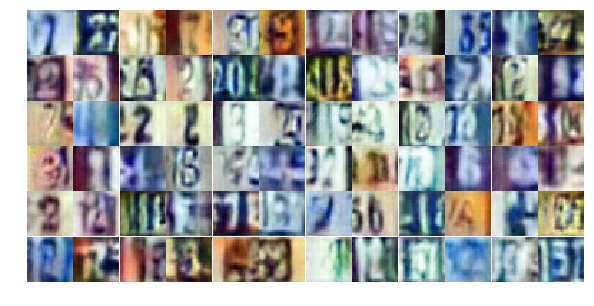

Epoch 12/25... Discriminator Loss: 1.1475... Generator Loss: 0.7987
Epoch 12/25... Discriminator Loss: 1.2046... Generator Loss: 0.8533
Epoch 12/25... Discriminator Loss: 1.1825... Generator Loss: 0.8528
Epoch 12/25... Discriminator Loss: 1.1972... Generator Loss: 0.7665
Epoch 12/25... Discriminator Loss: 1.2167... Generator Loss: 0.9073
Epoch 12/25... Discriminator Loss: 1.1968... Generator Loss: 0.9490
Epoch 12/25... Discriminator Loss: 1.1686... Generator Loss: 0.7935
Epoch 12/25... Discriminator Loss: 1.1721... Generator Loss: 0.9485
Epoch 12/25... Discriminator Loss: 1.0939... Generator Loss: 0.9794
Epoch 12/25... Discriminator Loss: 1.0949... Generator Loss: 0.9471


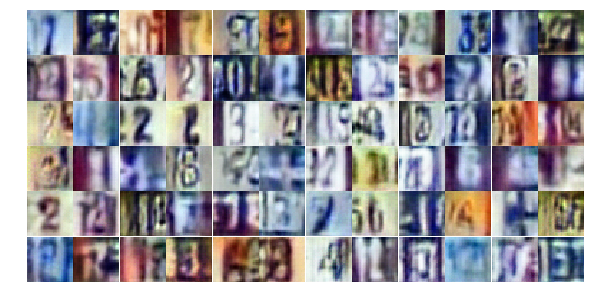

Epoch 12/25... Discriminator Loss: 1.1846... Generator Loss: 0.9420
Epoch 12/25... Discriminator Loss: 1.1992... Generator Loss: 0.8891
Epoch 12/25... Discriminator Loss: 1.1376... Generator Loss: 0.9131
Epoch 12/25... Discriminator Loss: 1.1626... Generator Loss: 0.8701
Epoch 12/25... Discriminator Loss: 1.1254... Generator Loss: 0.9485
Epoch 12/25... Discriminator Loss: 1.2789... Generator Loss: 1.1826
Epoch 12/25... Discriminator Loss: 1.1801... Generator Loss: 0.9100
Epoch 12/25... Discriminator Loss: 1.2773... Generator Loss: 0.8071
Epoch 12/25... Discriminator Loss: 1.1507... Generator Loss: 0.8727
Epoch 12/25... Discriminator Loss: 1.1764... Generator Loss: 0.8304


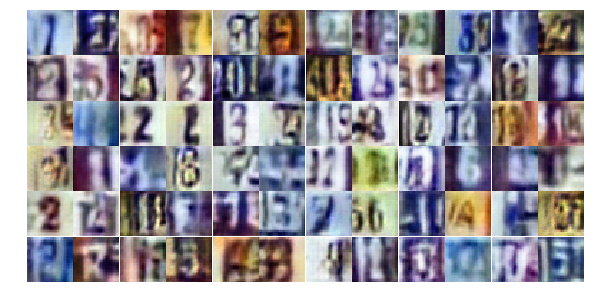

Epoch 12/25... Discriminator Loss: 1.1400... Generator Loss: 0.9240
Epoch 12/25... Discriminator Loss: 1.1840... Generator Loss: 0.7479
Epoch 12/25... Discriminator Loss: 1.0057... Generator Loss: 0.9765
Epoch 12/25... Discriminator Loss: 1.1846... Generator Loss: 0.7949
Epoch 12/25... Discriminator Loss: 1.1301... Generator Loss: 1.0019
Epoch 12/25... Discriminator Loss: 1.1081... Generator Loss: 0.8270
Epoch 12/25... Discriminator Loss: 1.1386... Generator Loss: 0.9255
Epoch 13/25... Discriminator Loss: 1.1795... Generator Loss: 0.8929
Epoch 13/25... Discriminator Loss: 1.1216... Generator Loss: 0.8657
Epoch 13/25... Discriminator Loss: 1.2179... Generator Loss: 0.7919


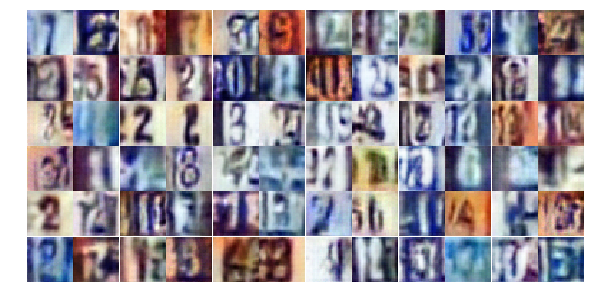

Epoch 13/25... Discriminator Loss: 1.1625... Generator Loss: 0.8164
Epoch 13/25... Discriminator Loss: 1.1823... Generator Loss: 0.8750
Epoch 13/25... Discriminator Loss: 1.1640... Generator Loss: 0.8185
Epoch 13/25... Discriminator Loss: 1.1542... Generator Loss: 0.8850
Epoch 13/25... Discriminator Loss: 1.1928... Generator Loss: 0.8693
Epoch 13/25... Discriminator Loss: 1.1252... Generator Loss: 0.9656
Epoch 13/25... Discriminator Loss: 1.1242... Generator Loss: 0.9712
Epoch 13/25... Discriminator Loss: 1.1767... Generator Loss: 0.8260
Epoch 13/25... Discriminator Loss: 1.1707... Generator Loss: 0.8508
Epoch 13/25... Discriminator Loss: 1.1151... Generator Loss: 0.9209


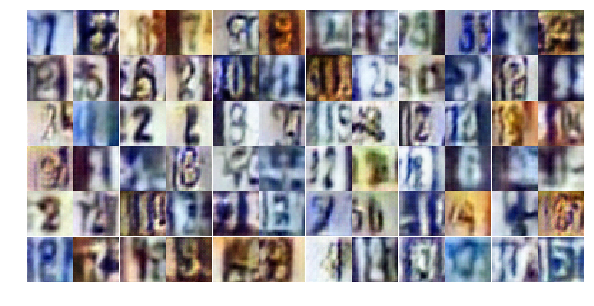

Epoch 13/25... Discriminator Loss: 1.2269... Generator Loss: 0.8582
Epoch 13/25... Discriminator Loss: 1.1764... Generator Loss: 0.8958
Epoch 13/25... Discriminator Loss: 1.0761... Generator Loss: 0.9186
Epoch 13/25... Discriminator Loss: 1.1318... Generator Loss: 0.8537
Epoch 13/25... Discriminator Loss: 1.0699... Generator Loss: 0.9237
Epoch 13/25... Discriminator Loss: 1.1612... Generator Loss: 0.8854
Epoch 13/25... Discriminator Loss: 1.1830... Generator Loss: 0.8021
Epoch 13/25... Discriminator Loss: 1.1897... Generator Loss: 0.8063
Epoch 13/25... Discriminator Loss: 1.0775... Generator Loss: 0.9148
Epoch 13/25... Discriminator Loss: 1.1735... Generator Loss: 0.9030


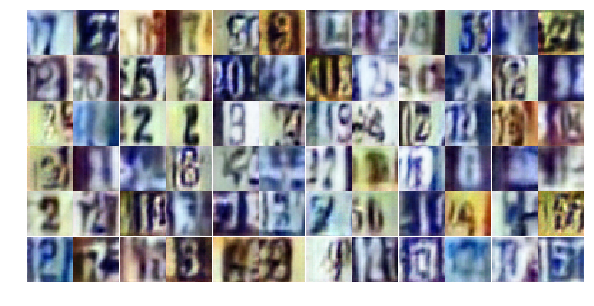

Epoch 13/25... Discriminator Loss: 1.2018... Generator Loss: 0.7783
Epoch 13/25... Discriminator Loss: 1.1131... Generator Loss: 0.9582
Epoch 13/25... Discriminator Loss: 1.1761... Generator Loss: 0.8231
Epoch 13/25... Discriminator Loss: 1.1694... Generator Loss: 0.8771
Epoch 13/25... Discriminator Loss: 1.0939... Generator Loss: 0.9529
Epoch 13/25... Discriminator Loss: 1.1850... Generator Loss: 0.8716
Epoch 13/25... Discriminator Loss: 1.0936... Generator Loss: 0.8869
Epoch 13/25... Discriminator Loss: 1.1770... Generator Loss: 0.8874
Epoch 13/25... Discriminator Loss: 1.1455... Generator Loss: 0.8287
Epoch 13/25... Discriminator Loss: 1.3020... Generator Loss: 0.7305


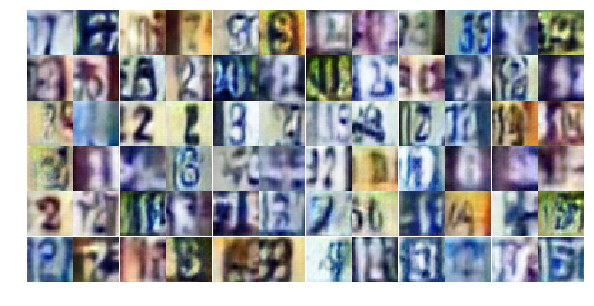

Epoch 13/25... Discriminator Loss: 1.2329... Generator Loss: 0.7752
Epoch 13/25... Discriminator Loss: 1.1260... Generator Loss: 0.9117
Epoch 13/25... Discriminator Loss: 1.2587... Generator Loss: 0.8319
Epoch 13/25... Discriminator Loss: 1.1789... Generator Loss: 0.8917
Epoch 13/25... Discriminator Loss: 1.0848... Generator Loss: 0.9118
Epoch 13/25... Discriminator Loss: 1.1141... Generator Loss: 0.9794
Epoch 13/25... Discriminator Loss: 1.1720... Generator Loss: 0.9206
Epoch 13/25... Discriminator Loss: 1.1731... Generator Loss: 0.9065
Epoch 13/25... Discriminator Loss: 1.0848... Generator Loss: 0.9437
Epoch 13/25... Discriminator Loss: 1.1840... Generator Loss: 0.7594


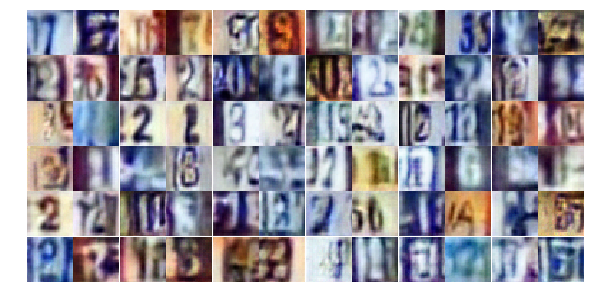

Epoch 13/25... Discriminator Loss: 1.0798... Generator Loss: 0.9162
Epoch 13/25... Discriminator Loss: 1.2102... Generator Loss: 0.8711
Epoch 13/25... Discriminator Loss: 1.1556... Generator Loss: 0.8003
Epoch 13/25... Discriminator Loss: 1.1408... Generator Loss: 1.0155
Epoch 13/25... Discriminator Loss: 1.2280... Generator Loss: 0.8248
Epoch 13/25... Discriminator Loss: 1.1433... Generator Loss: 0.8093
Epoch 13/25... Discriminator Loss: 1.1558... Generator Loss: 0.9614
Epoch 13/25... Discriminator Loss: 1.1664... Generator Loss: 0.7729
Epoch 13/25... Discriminator Loss: 1.1268... Generator Loss: 0.8692
Epoch 13/25... Discriminator Loss: 1.1755... Generator Loss: 0.8058


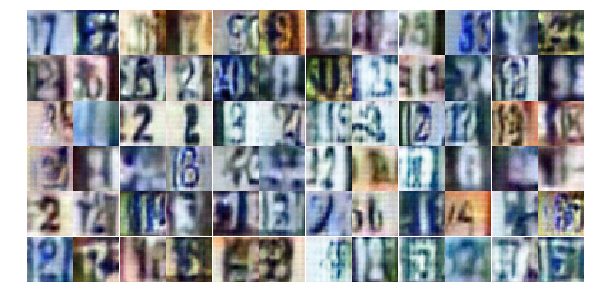

Epoch 13/25... Discriminator Loss: 1.1844... Generator Loss: 0.9303
Epoch 13/25... Discriminator Loss: 1.1345... Generator Loss: 0.9005
Epoch 13/25... Discriminator Loss: 1.1639... Generator Loss: 0.9657
Epoch 13/25... Discriminator Loss: 1.2563... Generator Loss: 0.8236
Epoch 14/25... Discriminator Loss: 1.1838... Generator Loss: 0.9009
Epoch 14/25... Discriminator Loss: 1.1999... Generator Loss: 0.9138
Epoch 14/25... Discriminator Loss: 1.1501... Generator Loss: 0.8796
Epoch 14/25... Discriminator Loss: 1.1498... Generator Loss: 1.0000
Epoch 14/25... Discriminator Loss: 1.1409... Generator Loss: 0.8389
Epoch 14/25... Discriminator Loss: 1.1821... Generator Loss: 0.7676


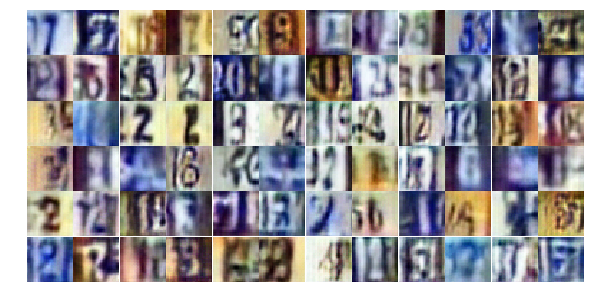

Epoch 14/25... Discriminator Loss: 1.2542... Generator Loss: 0.8129
Epoch 14/25... Discriminator Loss: 1.1947... Generator Loss: 0.7438
Epoch 14/25... Discriminator Loss: 1.1733... Generator Loss: 0.8467
Epoch 14/25... Discriminator Loss: 1.2699... Generator Loss: 1.0613
Epoch 14/25... Discriminator Loss: 1.0700... Generator Loss: 0.8734
Epoch 14/25... Discriminator Loss: 1.1515... Generator Loss: 0.8810
Epoch 14/25... Discriminator Loss: 1.0577... Generator Loss: 0.9060
Epoch 14/25... Discriminator Loss: 1.2271... Generator Loss: 0.7761
Epoch 14/25... Discriminator Loss: 1.2279... Generator Loss: 0.7660
Epoch 14/25... Discriminator Loss: 1.1650... Generator Loss: 0.7787


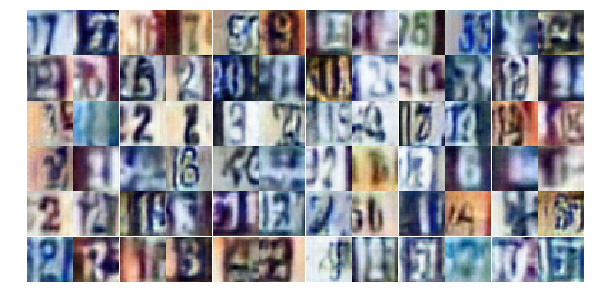

Epoch 14/25... Discriminator Loss: 1.2265... Generator Loss: 0.8878
Epoch 14/25... Discriminator Loss: 1.1574... Generator Loss: 0.7405
Epoch 14/25... Discriminator Loss: 1.2449... Generator Loss: 0.7497
Epoch 14/25... Discriminator Loss: 1.1750... Generator Loss: 0.8405
Epoch 14/25... Discriminator Loss: 1.1491... Generator Loss: 0.8077
Epoch 14/25... Discriminator Loss: 1.1886... Generator Loss: 0.9284
Epoch 14/25... Discriminator Loss: 1.2292... Generator Loss: 0.7881
Epoch 14/25... Discriminator Loss: 1.1182... Generator Loss: 0.9150
Epoch 14/25... Discriminator Loss: 1.1070... Generator Loss: 0.9247
Epoch 14/25... Discriminator Loss: 1.2520... Generator Loss: 1.0630


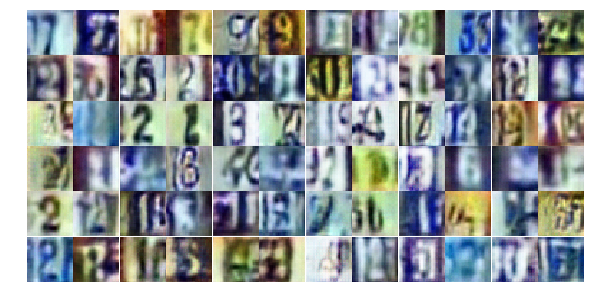

Epoch 14/25... Discriminator Loss: 1.1866... Generator Loss: 0.8829
Epoch 14/25... Discriminator Loss: 1.1045... Generator Loss: 0.7602
Epoch 14/25... Discriminator Loss: 1.2297... Generator Loss: 0.9563
Epoch 14/25... Discriminator Loss: 1.1602... Generator Loss: 0.8694
Epoch 14/25... Discriminator Loss: 1.1444... Generator Loss: 0.8831
Epoch 14/25... Discriminator Loss: 1.1740... Generator Loss: 0.8603
Epoch 14/25... Discriminator Loss: 1.1397... Generator Loss: 0.9043
Epoch 14/25... Discriminator Loss: 1.0958... Generator Loss: 0.9527
Epoch 14/25... Discriminator Loss: 1.1499... Generator Loss: 0.9184
Epoch 14/25... Discriminator Loss: 1.2577... Generator Loss: 0.8466


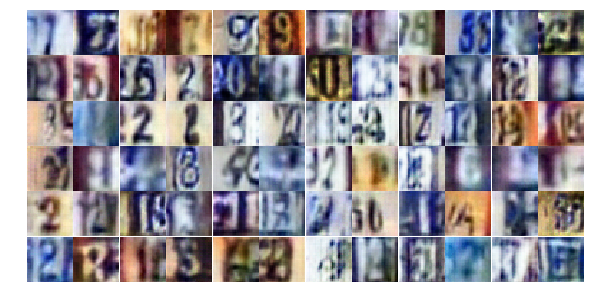

Epoch 14/25... Discriminator Loss: 1.2022... Generator Loss: 0.8482
Epoch 14/25... Discriminator Loss: 1.1313... Generator Loss: 0.8583
Epoch 14/25... Discriminator Loss: 1.1704... Generator Loss: 0.8574
Epoch 14/25... Discriminator Loss: 1.1737... Generator Loss: 0.9470
Epoch 14/25... Discriminator Loss: 1.2268... Generator Loss: 0.8658
Epoch 14/25... Discriminator Loss: 1.1950... Generator Loss: 0.8622
Epoch 14/25... Discriminator Loss: 1.1449... Generator Loss: 0.8606
Epoch 14/25... Discriminator Loss: 1.1615... Generator Loss: 0.8531
Epoch 14/25... Discriminator Loss: 1.2035... Generator Loss: 0.7392
Epoch 14/25... Discriminator Loss: 1.2714... Generator Loss: 0.9085


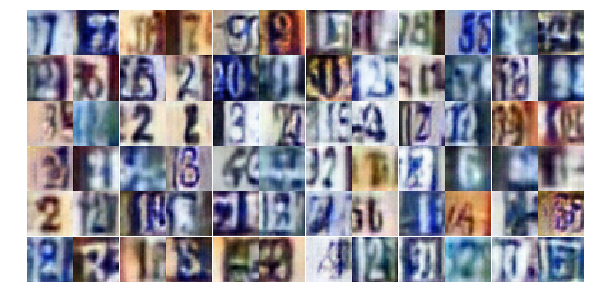

Epoch 14/25... Discriminator Loss: 1.1660... Generator Loss: 0.8337
Epoch 14/25... Discriminator Loss: 1.1702... Generator Loss: 0.9329
Epoch 14/25... Discriminator Loss: 1.1116... Generator Loss: 0.8666
Epoch 14/25... Discriminator Loss: 1.1650... Generator Loss: 0.8342
Epoch 14/25... Discriminator Loss: 1.2196... Generator Loss: 0.8127
Epoch 14/25... Discriminator Loss: 1.1540... Generator Loss: 0.8966
Epoch 14/25... Discriminator Loss: 1.2018... Generator Loss: 0.8596
Epoch 14/25... Discriminator Loss: 1.1574... Generator Loss: 0.8969
Epoch 14/25... Discriminator Loss: 1.2301... Generator Loss: 0.7819
Epoch 14/25... Discriminator Loss: 1.1692... Generator Loss: 0.8243


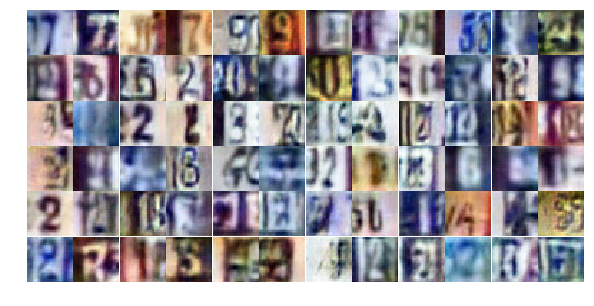

Epoch 14/25... Discriminator Loss: 1.1795... Generator Loss: 0.9133
Epoch 14/25... Discriminator Loss: 1.1441... Generator Loss: 0.9017
Epoch 15/25... Discriminator Loss: 1.1434... Generator Loss: 0.9402
Epoch 15/25... Discriminator Loss: 1.1306... Generator Loss: 0.9128
Epoch 15/25... Discriminator Loss: 1.1644... Generator Loss: 0.8135
Epoch 15/25... Discriminator Loss: 1.1977... Generator Loss: 0.8544
Epoch 15/25... Discriminator Loss: 1.1143... Generator Loss: 0.8248
Epoch 15/25... Discriminator Loss: 1.0824... Generator Loss: 0.8804
Epoch 15/25... Discriminator Loss: 1.2359... Generator Loss: 0.7609
Epoch 15/25... Discriminator Loss: 1.1815... Generator Loss: 0.8894


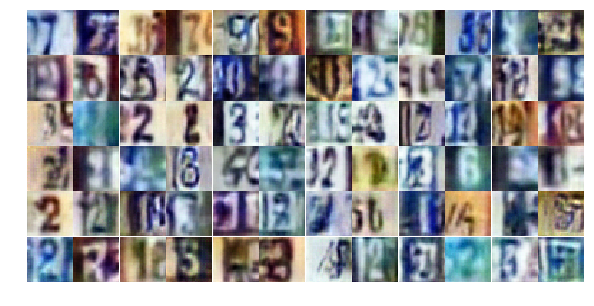

Epoch 15/25... Discriminator Loss: 1.1886... Generator Loss: 0.8997
Epoch 15/25... Discriminator Loss: 1.2283... Generator Loss: 0.7226
Epoch 15/25... Discriminator Loss: 1.2578... Generator Loss: 0.8668
Epoch 15/25... Discriminator Loss: 1.1757... Generator Loss: 0.8447
Epoch 15/25... Discriminator Loss: 1.2249... Generator Loss: 0.9581
Epoch 15/25... Discriminator Loss: 1.1367... Generator Loss: 0.8337
Epoch 15/25... Discriminator Loss: 1.3279... Generator Loss: 0.6535
Epoch 15/25... Discriminator Loss: 1.1422... Generator Loss: 0.8293
Epoch 15/25... Discriminator Loss: 1.2458... Generator Loss: 0.7878
Epoch 15/25... Discriminator Loss: 1.1149... Generator Loss: 0.8753


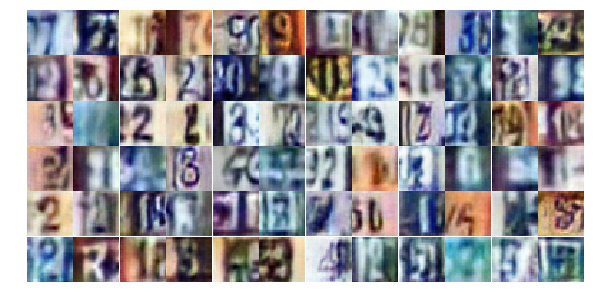

Epoch 15/25... Discriminator Loss: 1.2206... Generator Loss: 0.9155
Epoch 15/25... Discriminator Loss: 1.1927... Generator Loss: 0.8072
Epoch 15/25... Discriminator Loss: 1.1257... Generator Loss: 0.9925
Epoch 15/25... Discriminator Loss: 1.1654... Generator Loss: 0.8562
Epoch 15/25... Discriminator Loss: 1.2192... Generator Loss: 0.8262
Epoch 15/25... Discriminator Loss: 1.2383... Generator Loss: 0.8019
Epoch 15/25... Discriminator Loss: 1.0995... Generator Loss: 0.9621
Epoch 15/25... Discriminator Loss: 1.1948... Generator Loss: 0.8914
Epoch 15/25... Discriminator Loss: 1.1937... Generator Loss: 0.8758
Epoch 15/25... Discriminator Loss: 1.1653... Generator Loss: 0.9218


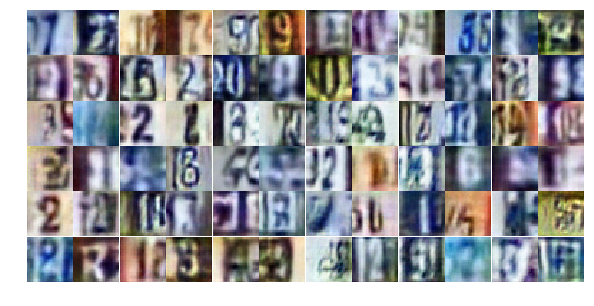

Epoch 15/25... Discriminator Loss: 1.2050... Generator Loss: 0.9394
Epoch 15/25... Discriminator Loss: 1.1792... Generator Loss: 0.7578
Epoch 15/25... Discriminator Loss: 1.1652... Generator Loss: 0.8812
Epoch 15/25... Discriminator Loss: 1.2038... Generator Loss: 0.7670
Epoch 15/25... Discriminator Loss: 1.2257... Generator Loss: 0.8404
Epoch 15/25... Discriminator Loss: 1.2207... Generator Loss: 0.7320
Epoch 15/25... Discriminator Loss: 1.1883... Generator Loss: 0.8528
Epoch 15/25... Discriminator Loss: 1.1891... Generator Loss: 0.8468
Epoch 15/25... Discriminator Loss: 1.1016... Generator Loss: 0.9490
Epoch 15/25... Discriminator Loss: 1.2089... Generator Loss: 0.8186


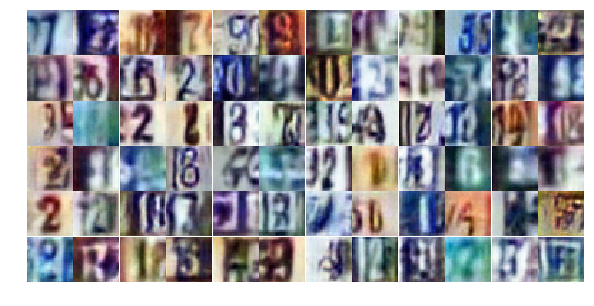

Epoch 15/25... Discriminator Loss: 1.2134... Generator Loss: 0.8496
Epoch 15/25... Discriminator Loss: 1.2508... Generator Loss: 0.8542
Epoch 15/25... Discriminator Loss: 1.1866... Generator Loss: 0.8203
Epoch 15/25... Discriminator Loss: 1.1922... Generator Loss: 0.9100
Epoch 15/25... Discriminator Loss: 1.1710... Generator Loss: 0.7530
Epoch 15/25... Discriminator Loss: 1.2584... Generator Loss: 0.8205
Epoch 15/25... Discriminator Loss: 1.1095... Generator Loss: 0.9186
Epoch 15/25... Discriminator Loss: 1.1707... Generator Loss: 0.8286
Epoch 15/25... Discriminator Loss: 1.1496... Generator Loss: 0.9197
Epoch 15/25... Discriminator Loss: 1.1791... Generator Loss: 0.8142


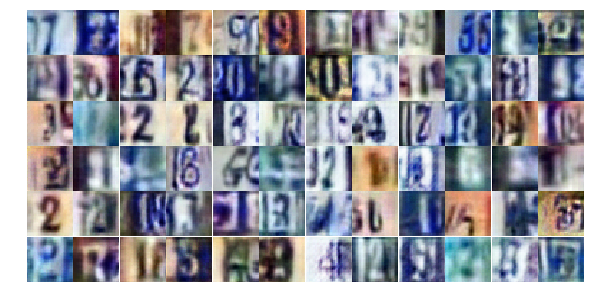

Epoch 15/25... Discriminator Loss: 1.2578... Generator Loss: 0.9721
Epoch 15/25... Discriminator Loss: 1.1621... Generator Loss: 0.8548
Epoch 15/25... Discriminator Loss: 1.1885... Generator Loss: 0.8943
Epoch 15/25... Discriminator Loss: 1.1730... Generator Loss: 0.8851
Epoch 15/25... Discriminator Loss: 1.1681... Generator Loss: 0.8839
Epoch 15/25... Discriminator Loss: 1.1689... Generator Loss: 0.8340
Epoch 15/25... Discriminator Loss: 1.1837... Generator Loss: 0.7217
Epoch 15/25... Discriminator Loss: 1.3692... Generator Loss: 0.6404
Epoch 15/25... Discriminator Loss: 1.3205... Generator Loss: 0.6853
Epoch 16/25... Discriminator Loss: 1.1293... Generator Loss: 0.8288


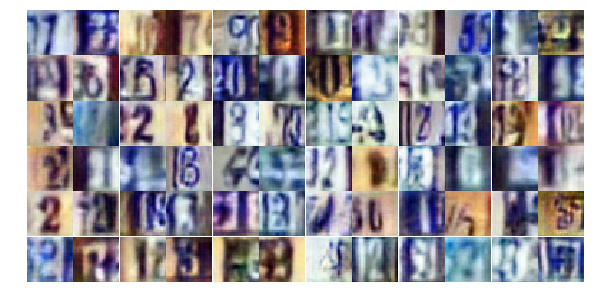

Epoch 16/25... Discriminator Loss: 1.2232... Generator Loss: 0.8931
Epoch 16/25... Discriminator Loss: 1.1940... Generator Loss: 0.8219
Epoch 16/25... Discriminator Loss: 1.1643... Generator Loss: 0.7971
Epoch 16/25... Discriminator Loss: 1.1886... Generator Loss: 0.8180
Epoch 16/25... Discriminator Loss: 1.2004... Generator Loss: 0.7506
Epoch 16/25... Discriminator Loss: 1.1732... Generator Loss: 0.8334
Epoch 16/25... Discriminator Loss: 1.1541... Generator Loss: 0.8193
Epoch 16/25... Discriminator Loss: 1.1981... Generator Loss: 0.9150
Epoch 16/25... Discriminator Loss: 1.2022... Generator Loss: 0.7843
Epoch 16/25... Discriminator Loss: 1.1917... Generator Loss: 0.8820


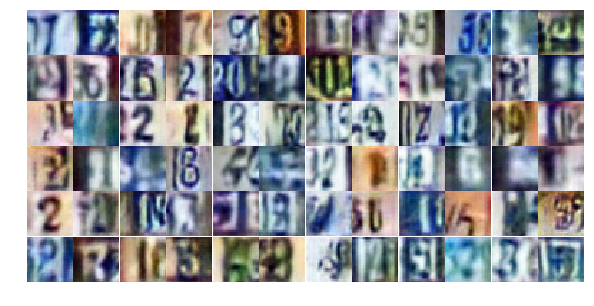

Epoch 16/25... Discriminator Loss: 1.1475... Generator Loss: 0.8723
Epoch 16/25... Discriminator Loss: 1.1562... Generator Loss: 0.8760
Epoch 16/25... Discriminator Loss: 1.1574... Generator Loss: 0.8569
Epoch 16/25... Discriminator Loss: 1.2406... Generator Loss: 0.8877
Epoch 16/25... Discriminator Loss: 1.2616... Generator Loss: 0.8876
Epoch 16/25... Discriminator Loss: 1.1661... Generator Loss: 0.8235
Epoch 16/25... Discriminator Loss: 1.2388... Generator Loss: 0.7587
Epoch 16/25... Discriminator Loss: 1.1135... Generator Loss: 0.9150
Epoch 16/25... Discriminator Loss: 1.1449... Generator Loss: 0.8908
Epoch 16/25... Discriminator Loss: 1.1933... Generator Loss: 0.8141


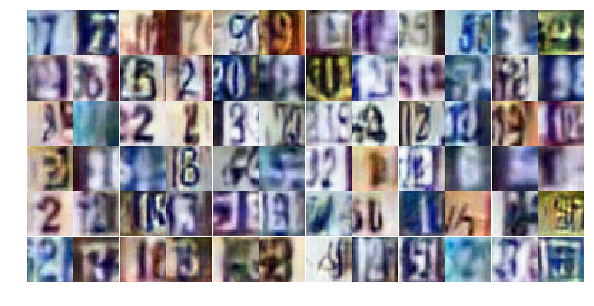

Epoch 16/25... Discriminator Loss: 1.1171... Generator Loss: 0.9910
Epoch 16/25... Discriminator Loss: 1.2010... Generator Loss: 0.8049
Epoch 16/25... Discriminator Loss: 1.2125... Generator Loss: 0.8444
Epoch 16/25... Discriminator Loss: 1.2076... Generator Loss: 0.8378
Epoch 16/25... Discriminator Loss: 1.2107... Generator Loss: 0.7542
Epoch 16/25... Discriminator Loss: 1.2245... Generator Loss: 0.8678
Epoch 16/25... Discriminator Loss: 1.1641... Generator Loss: 0.8635
Epoch 16/25... Discriminator Loss: 1.2009... Generator Loss: 0.8611
Epoch 16/25... Discriminator Loss: 1.2238... Generator Loss: 0.8713
Epoch 16/25... Discriminator Loss: 1.1848... Generator Loss: 0.8188


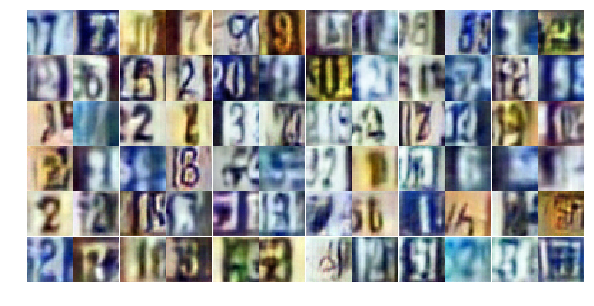

Epoch 16/25... Discriminator Loss: 1.0698... Generator Loss: 0.9140
Epoch 16/25... Discriminator Loss: 1.1782... Generator Loss: 0.7934
Epoch 16/25... Discriminator Loss: 1.1965... Generator Loss: 0.8687
Epoch 16/25... Discriminator Loss: 1.1617... Generator Loss: 0.7891
Epoch 16/25... Discriminator Loss: 1.1992... Generator Loss: 0.8047
Epoch 16/25... Discriminator Loss: 1.2360... Generator Loss: 0.9464
Epoch 16/25... Discriminator Loss: 1.1618... Generator Loss: 0.8127
Epoch 16/25... Discriminator Loss: 1.2486... Generator Loss: 0.8005
Epoch 16/25... Discriminator Loss: 1.1799... Generator Loss: 0.8361
Epoch 16/25... Discriminator Loss: 1.1037... Generator Loss: 0.8656


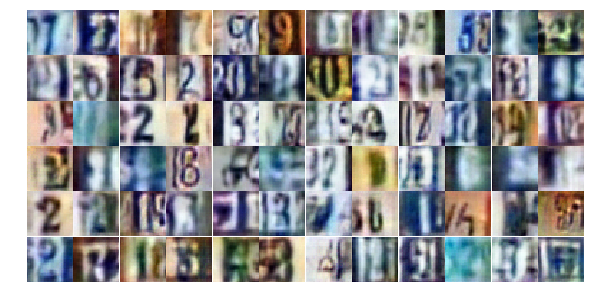

Epoch 16/25... Discriminator Loss: 1.1439... Generator Loss: 0.8829
Epoch 16/25... Discriminator Loss: 1.2652... Generator Loss: 0.7659
Epoch 16/25... Discriminator Loss: 1.2194... Generator Loss: 0.9076
Epoch 16/25... Discriminator Loss: 1.1480... Generator Loss: 0.8465
Epoch 16/25... Discriminator Loss: 1.2580... Generator Loss: 0.7555
Epoch 16/25... Discriminator Loss: 1.1337... Generator Loss: 0.9522
Epoch 16/25... Discriminator Loss: 1.2649... Generator Loss: 0.8002
Epoch 16/25... Discriminator Loss: 1.1564... Generator Loss: 0.8416
Epoch 16/25... Discriminator Loss: 1.1706... Generator Loss: 0.7830
Epoch 16/25... Discriminator Loss: 1.2843... Generator Loss: 0.8102


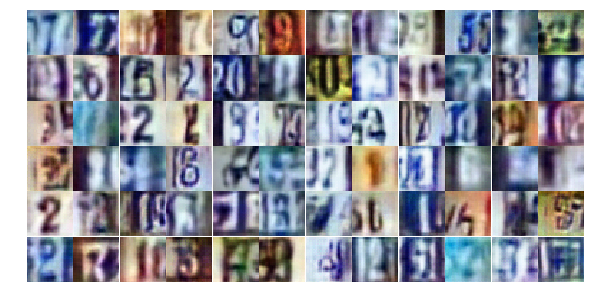

Epoch 16/25... Discriminator Loss: 1.2063... Generator Loss: 0.8885
Epoch 16/25... Discriminator Loss: 1.1339... Generator Loss: 0.8379
Epoch 16/25... Discriminator Loss: 1.2062... Generator Loss: 0.7963
Epoch 16/25... Discriminator Loss: 1.1241... Generator Loss: 0.9223
Epoch 16/25... Discriminator Loss: 1.1735... Generator Loss: 0.7821
Epoch 16/25... Discriminator Loss: 1.1974... Generator Loss: 0.7220
Epoch 17/25... Discriminator Loss: 1.2474... Generator Loss: 0.8038
Epoch 17/25... Discriminator Loss: 1.2097... Generator Loss: 0.9475
Epoch 17/25... Discriminator Loss: 1.1734... Generator Loss: 0.8098
Epoch 17/25... Discriminator Loss: 1.1329... Generator Loss: 0.8591


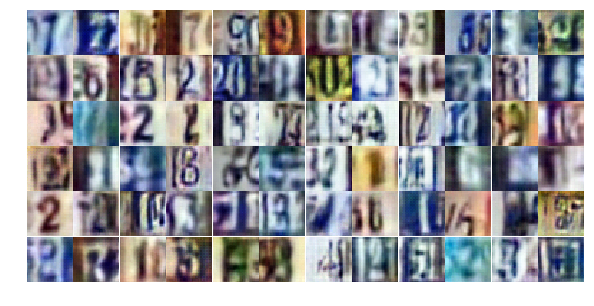

Epoch 17/25... Discriminator Loss: 1.1947... Generator Loss: 0.8716
Epoch 17/25... Discriminator Loss: 1.1120... Generator Loss: 0.9357
Epoch 17/25... Discriminator Loss: 1.0616... Generator Loss: 0.8907
Epoch 17/25... Discriminator Loss: 1.1190... Generator Loss: 0.8803
Epoch 17/25... Discriminator Loss: 1.2089... Generator Loss: 0.7194
Epoch 17/25... Discriminator Loss: 1.2045... Generator Loss: 0.7608
Epoch 17/25... Discriminator Loss: 1.1829... Generator Loss: 0.8538
Epoch 17/25... Discriminator Loss: 1.1780... Generator Loss: 0.8399
Epoch 17/25... Discriminator Loss: 1.1818... Generator Loss: 0.8372
Epoch 17/25... Discriminator Loss: 1.2139... Generator Loss: 0.8118


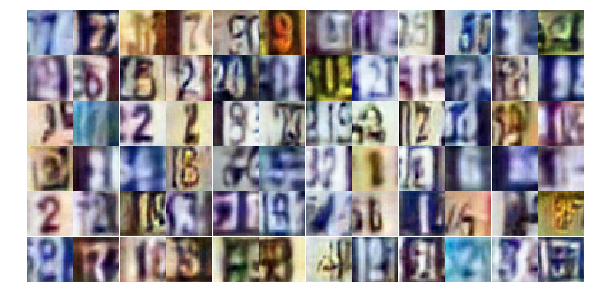

Epoch 17/25... Discriminator Loss: 1.2341... Generator Loss: 0.7008
Epoch 17/25... Discriminator Loss: 1.2210... Generator Loss: 0.8133
Epoch 17/25... Discriminator Loss: 1.1143... Generator Loss: 0.8382
Epoch 17/25... Discriminator Loss: 1.2184... Generator Loss: 0.7844
Epoch 17/25... Discriminator Loss: 1.2499... Generator Loss: 0.8084
Epoch 17/25... Discriminator Loss: 1.2294... Generator Loss: 0.8434
Epoch 17/25... Discriminator Loss: 1.1466... Generator Loss: 0.9317
Epoch 17/25... Discriminator Loss: 1.1229... Generator Loss: 0.8486
Epoch 17/25... Discriminator Loss: 1.0606... Generator Loss: 0.9387
Epoch 17/25... Discriminator Loss: 1.1857... Generator Loss: 0.8556


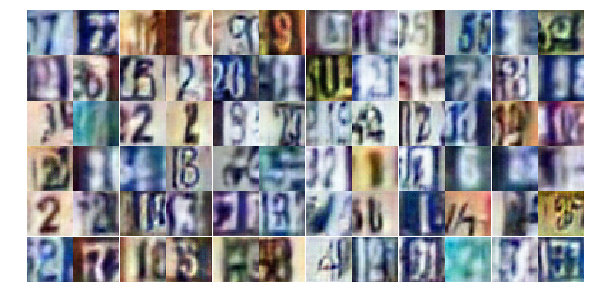

Epoch 17/25... Discriminator Loss: 1.2091... Generator Loss: 0.7988
Epoch 17/25... Discriminator Loss: 1.1109... Generator Loss: 1.0473
Epoch 17/25... Discriminator Loss: 1.2424... Generator Loss: 0.9262
Epoch 17/25... Discriminator Loss: 1.1789... Generator Loss: 0.9250
Epoch 17/25... Discriminator Loss: 1.2410... Generator Loss: 0.7654
Epoch 17/25... Discriminator Loss: 1.1414... Generator Loss: 0.8309
Epoch 17/25... Discriminator Loss: 1.1880... Generator Loss: 0.9054
Epoch 17/25... Discriminator Loss: 1.2211... Generator Loss: 0.8288
Epoch 17/25... Discriminator Loss: 1.2346... Generator Loss: 0.7862
Epoch 17/25... Discriminator Loss: 1.2037... Generator Loss: 0.8668


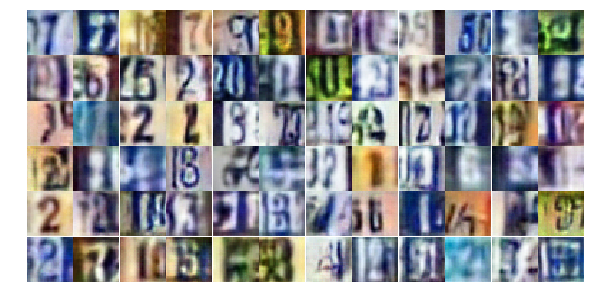

Epoch 17/25... Discriminator Loss: 1.1630... Generator Loss: 0.8052
Epoch 17/25... Discriminator Loss: 1.2362... Generator Loss: 0.7863
Epoch 17/25... Discriminator Loss: 1.0782... Generator Loss: 0.9137
Epoch 17/25... Discriminator Loss: 1.1445... Generator Loss: 0.8674
Epoch 17/25... Discriminator Loss: 1.1662... Generator Loss: 0.9002
Epoch 17/25... Discriminator Loss: 1.2025... Generator Loss: 0.8108
Epoch 17/25... Discriminator Loss: 1.2043... Generator Loss: 0.9121
Epoch 17/25... Discriminator Loss: 1.1351... Generator Loss: 0.9694
Epoch 17/25... Discriminator Loss: 1.1791... Generator Loss: 0.9109
Epoch 17/25... Discriminator Loss: 1.2075... Generator Loss: 0.7298


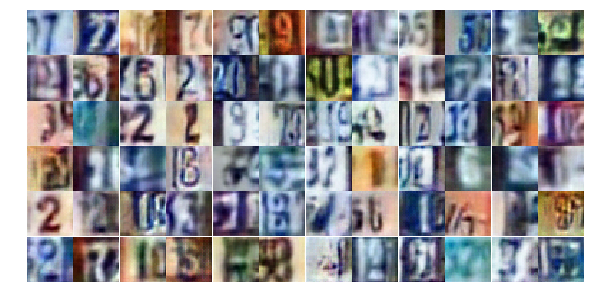

Epoch 17/25... Discriminator Loss: 1.2700... Generator Loss: 0.6842
Epoch 17/25... Discriminator Loss: 1.0670... Generator Loss: 0.9922
Epoch 17/25... Discriminator Loss: 1.2537... Generator Loss: 0.8475
Epoch 17/25... Discriminator Loss: 1.1586... Generator Loss: 0.8664
Epoch 17/25... Discriminator Loss: 1.1326... Generator Loss: 0.7918
Epoch 17/25... Discriminator Loss: 1.2185... Generator Loss: 0.7674
Epoch 17/25... Discriminator Loss: 1.1385... Generator Loss: 0.8612
Epoch 17/25... Discriminator Loss: 1.0813... Generator Loss: 0.8909
Epoch 17/25... Discriminator Loss: 1.1500... Generator Loss: 0.8740
Epoch 17/25... Discriminator Loss: 1.2030... Generator Loss: 0.7838


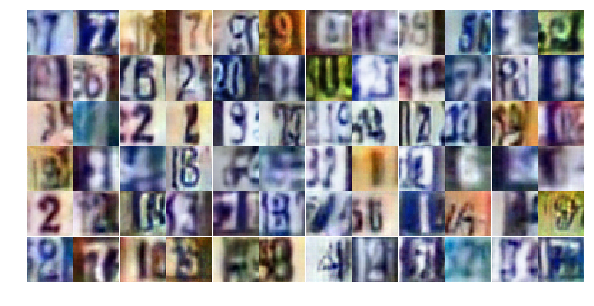

Epoch 17/25... Discriminator Loss: 1.1239... Generator Loss: 0.8793
Epoch 17/25... Discriminator Loss: 1.2180... Generator Loss: 0.7496
Epoch 17/25... Discriminator Loss: 1.1072... Generator Loss: 0.8424
Epoch 17/25... Discriminator Loss: 1.1207... Generator Loss: 0.8933
Epoch 18/25... Discriminator Loss: 1.2358... Generator Loss: 0.9340
Epoch 18/25... Discriminator Loss: 1.2218... Generator Loss: 0.7898
Epoch 18/25... Discriminator Loss: 1.1560... Generator Loss: 0.8529
Epoch 18/25... Discriminator Loss: 1.1232... Generator Loss: 0.8564
Epoch 18/25... Discriminator Loss: 1.1798... Generator Loss: 0.8756
Epoch 18/25... Discriminator Loss: 1.2443... Generator Loss: 0.8192


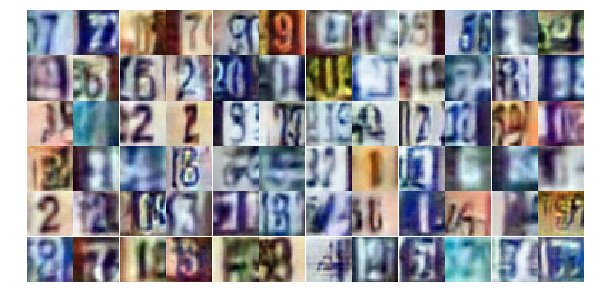

Epoch 18/25... Discriminator Loss: 1.1588... Generator Loss: 0.8122
Epoch 18/25... Discriminator Loss: 1.1054... Generator Loss: 0.9217
Epoch 18/25... Discriminator Loss: 1.2293... Generator Loss: 0.7731
Epoch 18/25... Discriminator Loss: 1.1665... Generator Loss: 0.8337
Epoch 18/25... Discriminator Loss: 1.2302... Generator Loss: 0.6957
Epoch 18/25... Discriminator Loss: 1.1639... Generator Loss: 0.8671
Epoch 18/25... Discriminator Loss: 1.1890... Generator Loss: 0.8811
Epoch 18/25... Discriminator Loss: 1.2381... Generator Loss: 0.9506
Epoch 18/25... Discriminator Loss: 1.2253... Generator Loss: 0.7902
Epoch 18/25... Discriminator Loss: 1.1558... Generator Loss: 0.7893


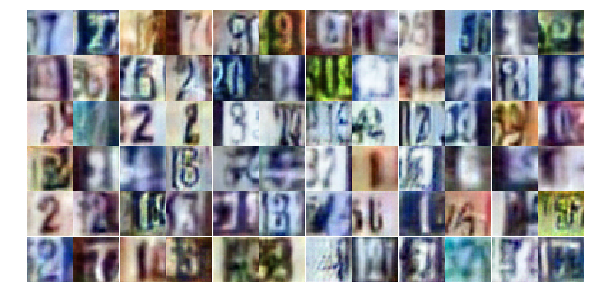

Epoch 18/25... Discriminator Loss: 1.1387... Generator Loss: 0.9364
Epoch 18/25... Discriminator Loss: 1.1197... Generator Loss: 0.9660
Epoch 18/25... Discriminator Loss: 1.2120... Generator Loss: 0.8144
Epoch 18/25... Discriminator Loss: 1.0775... Generator Loss: 0.9366
Epoch 18/25... Discriminator Loss: 1.2319... Generator Loss: 0.8570
Epoch 18/25... Discriminator Loss: 1.1997... Generator Loss: 0.7753
Epoch 18/25... Discriminator Loss: 1.1749... Generator Loss: 0.7479
Epoch 18/25... Discriminator Loss: 1.1304... Generator Loss: 0.8348
Epoch 18/25... Discriminator Loss: 1.0794... Generator Loss: 0.9114
Epoch 18/25... Discriminator Loss: 1.1338... Generator Loss: 0.8447


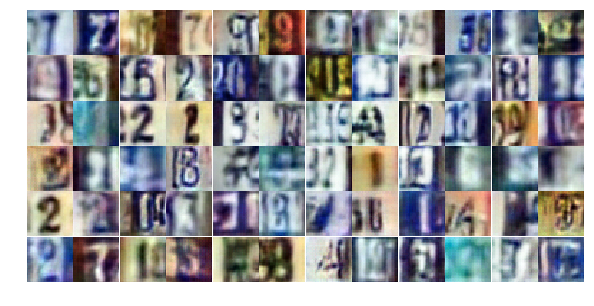

Epoch 18/25... Discriminator Loss: 1.1496... Generator Loss: 0.8952
Epoch 18/25... Discriminator Loss: 1.1681... Generator Loss: 0.8994
Epoch 18/25... Discriminator Loss: 1.1518... Generator Loss: 0.8775
Epoch 18/25... Discriminator Loss: 1.1447... Generator Loss: 0.8142
Epoch 18/25... Discriminator Loss: 1.1655... Generator Loss: 0.8176
Epoch 18/25... Discriminator Loss: 1.2254... Generator Loss: 0.8593
Epoch 18/25... Discriminator Loss: 1.1737... Generator Loss: 0.8065
Epoch 18/25... Discriminator Loss: 1.1334... Generator Loss: 0.8528
Epoch 18/25... Discriminator Loss: 1.1230... Generator Loss: 0.9251
Epoch 18/25... Discriminator Loss: 1.1899... Generator Loss: 0.8375


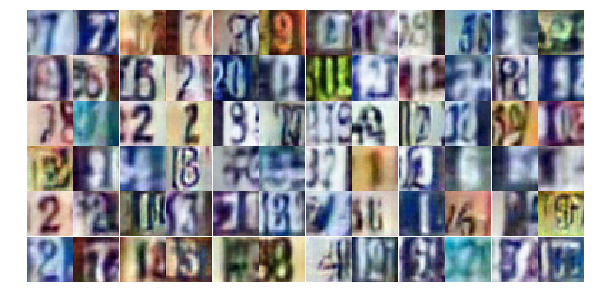

Epoch 18/25... Discriminator Loss: 1.1542... Generator Loss: 0.8830
Epoch 18/25... Discriminator Loss: 1.1307... Generator Loss: 0.7754
Epoch 18/25... Discriminator Loss: 1.1765... Generator Loss: 0.9165
Epoch 18/25... Discriminator Loss: 1.1454... Generator Loss: 0.8291
Epoch 18/25... Discriminator Loss: 1.2469... Generator Loss: 0.8474
Epoch 18/25... Discriminator Loss: 1.2085... Generator Loss: 0.7621
Epoch 18/25... Discriminator Loss: 1.2306... Generator Loss: 0.9243
Epoch 18/25... Discriminator Loss: 1.1547... Generator Loss: 0.8098
Epoch 18/25... Discriminator Loss: 1.1024... Generator Loss: 0.9443
Epoch 18/25... Discriminator Loss: 1.1530... Generator Loss: 0.8638


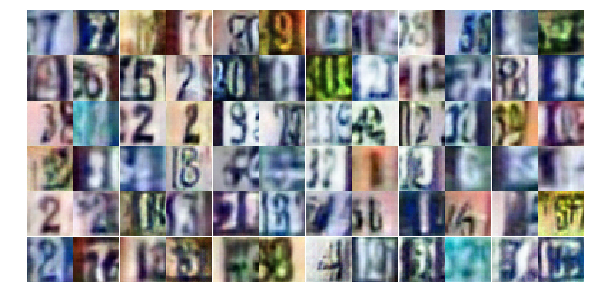

Epoch 18/25... Discriminator Loss: 1.2044... Generator Loss: 0.8864
Epoch 18/25... Discriminator Loss: 1.2395... Generator Loss: 0.8030
Epoch 18/25... Discriminator Loss: 1.1514... Generator Loss: 0.9776
Epoch 18/25... Discriminator Loss: 1.2343... Generator Loss: 0.7803
Epoch 18/25... Discriminator Loss: 1.1739... Generator Loss: 0.7899
Epoch 18/25... Discriminator Loss: 1.1753... Generator Loss: 0.9184
Epoch 18/25... Discriminator Loss: 1.2609... Generator Loss: 0.8796
Epoch 18/25... Discriminator Loss: 1.1159... Generator Loss: 0.8601
Epoch 18/25... Discriminator Loss: 1.2055... Generator Loss: 0.8025
Epoch 18/25... Discriminator Loss: 1.2299... Generator Loss: 0.9401


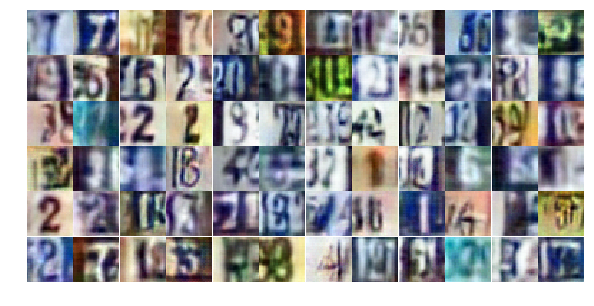

Epoch 18/25... Discriminator Loss: 1.2594... Generator Loss: 0.8070
Epoch 19/25... Discriminator Loss: 1.2023... Generator Loss: 0.8130
Epoch 19/25... Discriminator Loss: 1.2177... Generator Loss: 0.8318
Epoch 19/25... Discriminator Loss: 1.2062... Generator Loss: 0.8684
Epoch 19/25... Discriminator Loss: 1.1557... Generator Loss: 0.7903
Epoch 19/25... Discriminator Loss: 1.2341... Generator Loss: 0.8364
Epoch 19/25... Discriminator Loss: 1.2315... Generator Loss: 0.8885
Epoch 19/25... Discriminator Loss: 1.1691... Generator Loss: 0.7827
Epoch 19/25... Discriminator Loss: 1.1959... Generator Loss: 0.8023
Epoch 19/25... Discriminator Loss: 1.1788... Generator Loss: 0.8956


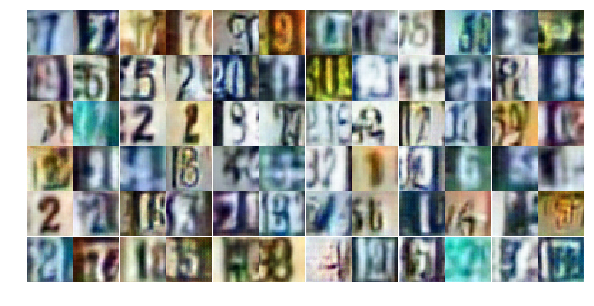

Epoch 19/25... Discriminator Loss: 1.1990... Generator Loss: 0.9076
Epoch 19/25... Discriminator Loss: 1.1678... Generator Loss: 0.8011
Epoch 19/25... Discriminator Loss: 1.1536... Generator Loss: 0.9502
Epoch 19/25... Discriminator Loss: 1.0844... Generator Loss: 0.9884
Epoch 19/25... Discriminator Loss: 1.0993... Generator Loss: 0.8341
Epoch 19/25... Discriminator Loss: 1.1948... Generator Loss: 0.7859
Epoch 19/25... Discriminator Loss: 1.2320... Generator Loss: 0.8116
Epoch 19/25... Discriminator Loss: 1.1381... Generator Loss: 0.9029
Epoch 19/25... Discriminator Loss: 1.1180... Generator Loss: 0.7586
Epoch 19/25... Discriminator Loss: 1.2056... Generator Loss: 0.8380


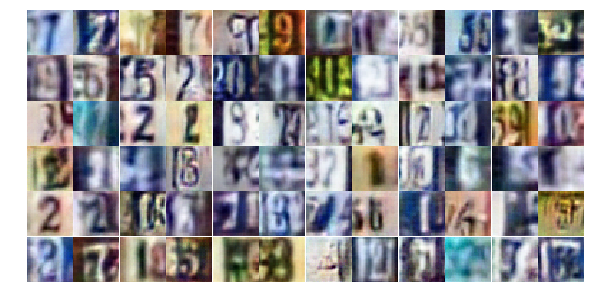

Epoch 19/25... Discriminator Loss: 1.1317... Generator Loss: 0.8334
Epoch 19/25... Discriminator Loss: 1.2221... Generator Loss: 0.8252
Epoch 19/25... Discriminator Loss: 1.2652... Generator Loss: 0.8125
Epoch 19/25... Discriminator Loss: 1.1992... Generator Loss: 0.9268
Epoch 19/25... Discriminator Loss: 1.2128... Generator Loss: 0.8619
Epoch 19/25... Discriminator Loss: 1.1860... Generator Loss: 0.8204
Epoch 19/25... Discriminator Loss: 1.0989... Generator Loss: 0.8749
Epoch 19/25... Discriminator Loss: 1.1652... Generator Loss: 0.8051
Epoch 19/25... Discriminator Loss: 1.1552... Generator Loss: 0.9088
Epoch 19/25... Discriminator Loss: 1.1435... Generator Loss: 0.7781


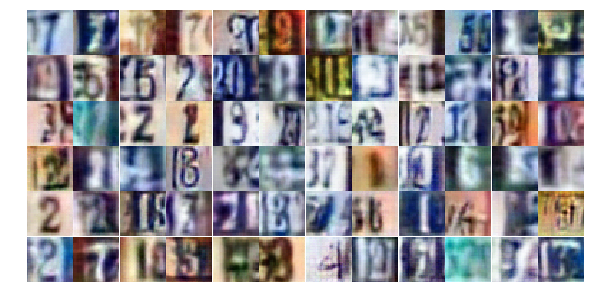

Epoch 19/25... Discriminator Loss: 1.1960... Generator Loss: 0.8582
Epoch 19/25... Discriminator Loss: 1.2571... Generator Loss: 0.8228
Epoch 19/25... Discriminator Loss: 1.0987... Generator Loss: 0.9130
Epoch 19/25... Discriminator Loss: 1.2023... Generator Loss: 0.8386
Epoch 19/25... Discriminator Loss: 1.1189... Generator Loss: 0.9404
Epoch 19/25... Discriminator Loss: 1.2900... Generator Loss: 0.7160
Epoch 19/25... Discriminator Loss: 1.1769... Generator Loss: 0.7681
Epoch 19/25... Discriminator Loss: 1.1841... Generator Loss: 0.8956
Epoch 19/25... Discriminator Loss: 1.1666... Generator Loss: 0.8679
Epoch 19/25... Discriminator Loss: 1.1649... Generator Loss: 0.8789


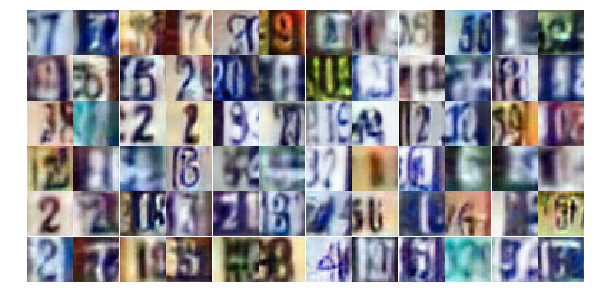

Epoch 19/25... Discriminator Loss: 1.1086... Generator Loss: 0.8036
Epoch 19/25... Discriminator Loss: 1.1784... Generator Loss: 0.6839
Epoch 19/25... Discriminator Loss: 1.2067... Generator Loss: 0.8521
Epoch 19/25... Discriminator Loss: 1.2007... Generator Loss: 0.9191
Epoch 19/25... Discriminator Loss: 1.2551... Generator Loss: 0.8165
Epoch 19/25... Discriminator Loss: 1.1520... Generator Loss: 0.8501
Epoch 19/25... Discriminator Loss: 1.1971... Generator Loss: 0.9175
Epoch 19/25... Discriminator Loss: 1.1004... Generator Loss: 0.8126
Epoch 19/25... Discriminator Loss: 1.1460... Generator Loss: 1.0447
Epoch 19/25... Discriminator Loss: 1.1361... Generator Loss: 0.8512


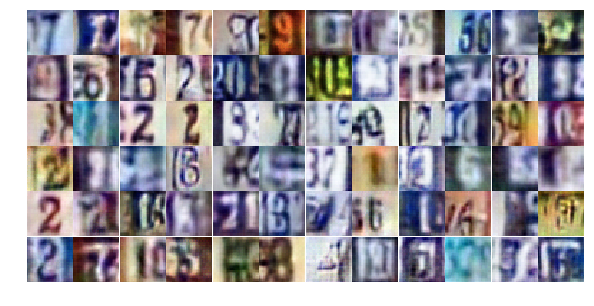

Epoch 19/25... Discriminator Loss: 1.2011... Generator Loss: 0.7581
Epoch 19/25... Discriminator Loss: 1.1555... Generator Loss: 0.9199
Epoch 19/25... Discriminator Loss: 1.2528... Generator Loss: 0.8040
Epoch 19/25... Discriminator Loss: 1.2144... Generator Loss: 0.8906
Epoch 19/25... Discriminator Loss: 1.1448... Generator Loss: 0.8991
Epoch 19/25... Discriminator Loss: 1.1596... Generator Loss: 0.9170
Epoch 19/25... Discriminator Loss: 1.2387... Generator Loss: 0.8592
Epoch 19/25... Discriminator Loss: 1.1410... Generator Loss: 0.8489
Epoch 20/25... Discriminator Loss: 1.1788... Generator Loss: 0.7445
Epoch 20/25... Discriminator Loss: 1.1358... Generator Loss: 1.0088


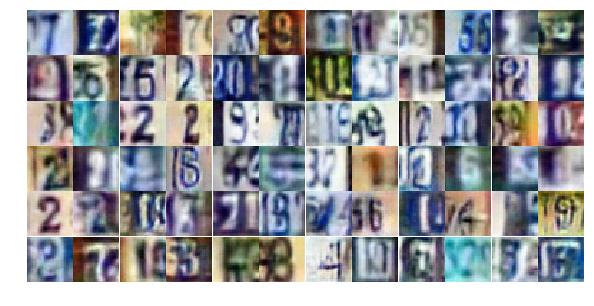

Epoch 20/25... Discriminator Loss: 1.2099... Generator Loss: 0.8304
Epoch 20/25... Discriminator Loss: 1.2291... Generator Loss: 0.8943
Epoch 20/25... Discriminator Loss: 1.2328... Generator Loss: 0.8477
Epoch 20/25... Discriminator Loss: 1.3336... Generator Loss: 1.1239
Epoch 20/25... Discriminator Loss: 1.1532... Generator Loss: 0.9368
Epoch 20/25... Discriminator Loss: 1.2389... Generator Loss: 0.7468
Epoch 20/25... Discriminator Loss: 1.2138... Generator Loss: 0.9064
Epoch 20/25... Discriminator Loss: 1.1916... Generator Loss: 0.8431
Epoch 20/25... Discriminator Loss: 1.2935... Generator Loss: 0.7655
Epoch 20/25... Discriminator Loss: 1.1440... Generator Loss: 0.8278


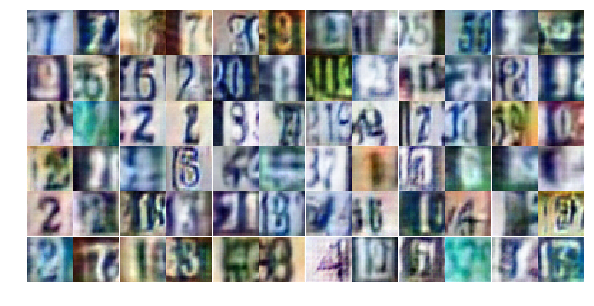

Epoch 20/25... Discriminator Loss: 1.1748... Generator Loss: 0.8033
Epoch 20/25... Discriminator Loss: 1.2486... Generator Loss: 0.8298
Epoch 20/25... Discriminator Loss: 1.1746... Generator Loss: 0.8910
Epoch 20/25... Discriminator Loss: 1.2422... Generator Loss: 0.8344
Epoch 20/25... Discriminator Loss: 1.2450... Generator Loss: 0.8246
Epoch 20/25... Discriminator Loss: 1.2104... Generator Loss: 0.8193
Epoch 20/25... Discriminator Loss: 1.2107... Generator Loss: 0.8323
Epoch 20/25... Discriminator Loss: 1.0894... Generator Loss: 0.9316
Epoch 20/25... Discriminator Loss: 1.1379... Generator Loss: 0.8768
Epoch 20/25... Discriminator Loss: 1.1527... Generator Loss: 0.8475


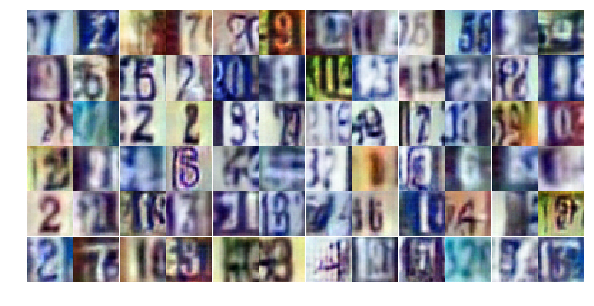

Epoch 20/25... Discriminator Loss: 1.1738... Generator Loss: 0.8768
Epoch 20/25... Discriminator Loss: 1.1101... Generator Loss: 0.8617
Epoch 20/25... Discriminator Loss: 1.1701... Generator Loss: 0.9339
Epoch 20/25... Discriminator Loss: 1.1644... Generator Loss: 0.7872
Epoch 20/25... Discriminator Loss: 1.1641... Generator Loss: 0.8157
Epoch 20/25... Discriminator Loss: 1.1212... Generator Loss: 0.8040
Epoch 20/25... Discriminator Loss: 1.2100... Generator Loss: 0.7668
Epoch 20/25... Discriminator Loss: 1.2178... Generator Loss: 0.7363
Epoch 20/25... Discriminator Loss: 1.1677... Generator Loss: 0.8591
Epoch 20/25... Discriminator Loss: 1.0766... Generator Loss: 1.0115


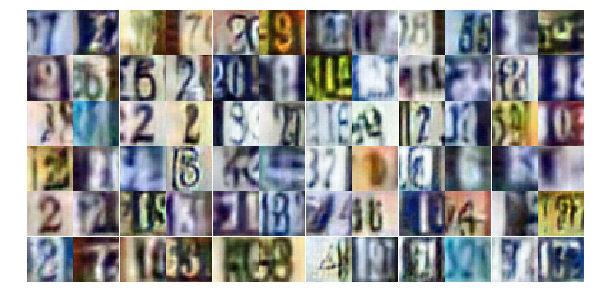

Epoch 20/25... Discriminator Loss: 1.2257... Generator Loss: 0.7494
Epoch 20/25... Discriminator Loss: 1.1981... Generator Loss: 0.8262
Epoch 20/25... Discriminator Loss: 1.3155... Generator Loss: 0.7884
Epoch 20/25... Discriminator Loss: 1.2658... Generator Loss: 0.8667
Epoch 20/25... Discriminator Loss: 1.1936... Generator Loss: 0.9169
Epoch 20/25... Discriminator Loss: 1.1971... Generator Loss: 0.7608
Epoch 20/25... Discriminator Loss: 1.1251... Generator Loss: 0.8860
Epoch 20/25... Discriminator Loss: 1.1498... Generator Loss: 0.8985
Epoch 20/25... Discriminator Loss: 1.2188... Generator Loss: 0.9367
Epoch 20/25... Discriminator Loss: 1.1492... Generator Loss: 0.8352


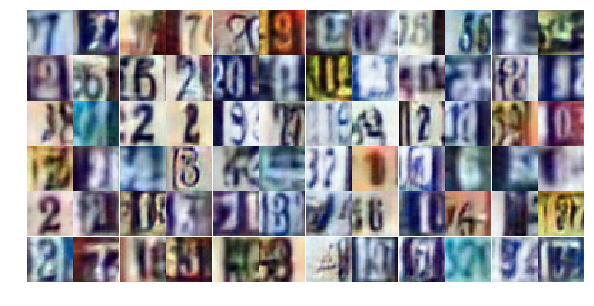

Epoch 20/25... Discriminator Loss: 1.1767... Generator Loss: 0.9076
Epoch 20/25... Discriminator Loss: 1.1804... Generator Loss: 0.8519
Epoch 20/25... Discriminator Loss: 1.1253... Generator Loss: 0.8180
Epoch 20/25... Discriminator Loss: 1.2277... Generator Loss: 0.8690
Epoch 20/25... Discriminator Loss: 1.1614... Generator Loss: 0.9357
Epoch 20/25... Discriminator Loss: 1.1506... Generator Loss: 0.8494
Epoch 20/25... Discriminator Loss: 1.1700... Generator Loss: 0.8345
Epoch 20/25... Discriminator Loss: 1.1466... Generator Loss: 0.9856
Epoch 20/25... Discriminator Loss: 1.0944... Generator Loss: 0.9118
Epoch 20/25... Discriminator Loss: 1.1433... Generator Loss: 0.8005


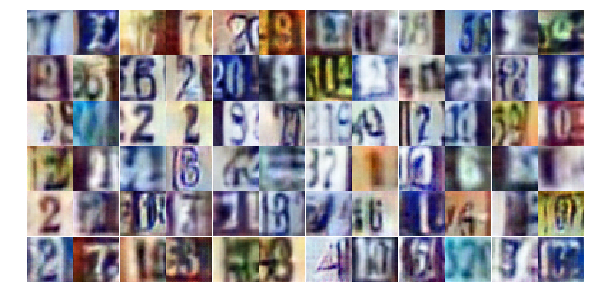

Epoch 20/25... Discriminator Loss: 1.1073... Generator Loss: 0.8477
Epoch 20/25... Discriminator Loss: 1.2699... Generator Loss: 0.8091
Epoch 20/25... Discriminator Loss: 1.2143... Generator Loss: 0.8307
Epoch 20/25... Discriminator Loss: 1.2126... Generator Loss: 0.8089
Epoch 20/25... Discriminator Loss: 1.2224... Generator Loss: 0.9276
Epoch 20/25... Discriminator Loss: 0.9379... Generator Loss: 0.9272
Epoch 21/25... Discriminator Loss: 1.1423... Generator Loss: 0.9172
Epoch 21/25... Discriminator Loss: 1.1530... Generator Loss: 0.8085
Epoch 21/25... Discriminator Loss: 1.2591... Generator Loss: 0.7872
Epoch 21/25... Discriminator Loss: 1.1852... Generator Loss: 0.8325


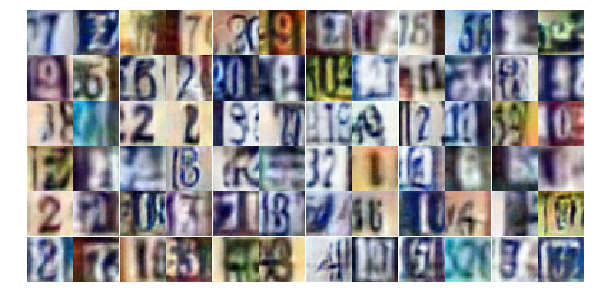

Epoch 21/25... Discriminator Loss: 1.1482... Generator Loss: 0.8334
Epoch 21/25... Discriminator Loss: 1.2632... Generator Loss: 0.7521
Epoch 21/25... Discriminator Loss: 1.0256... Generator Loss: 1.0307
Epoch 21/25... Discriminator Loss: 1.1394... Generator Loss: 0.8830
Epoch 21/25... Discriminator Loss: 1.1008... Generator Loss: 0.8380
Epoch 21/25... Discriminator Loss: 1.0093... Generator Loss: 1.0029
Epoch 21/25... Discriminator Loss: 1.2335... Generator Loss: 0.8560
Epoch 21/25... Discriminator Loss: 1.2820... Generator Loss: 0.7694
Epoch 21/25... Discriminator Loss: 1.2330... Generator Loss: 0.8471
Epoch 21/25... Discriminator Loss: 1.1466... Generator Loss: 0.9602


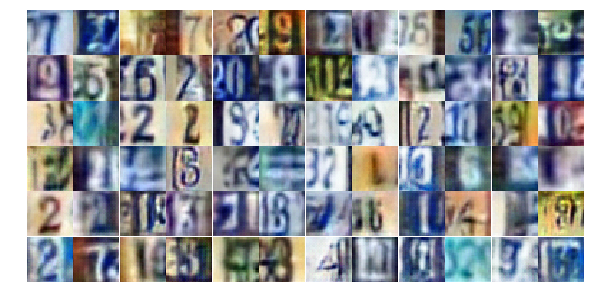

Epoch 21/25... Discriminator Loss: 1.0165... Generator Loss: 0.8967
Epoch 21/25... Discriminator Loss: 1.0945... Generator Loss: 0.7988
Epoch 21/25... Discriminator Loss: 1.3248... Generator Loss: 0.7790
Epoch 21/25... Discriminator Loss: 1.1678... Generator Loss: 0.8582
Epoch 21/25... Discriminator Loss: 1.0740... Generator Loss: 0.9421
Epoch 21/25... Discriminator Loss: 1.2792... Generator Loss: 0.7910
Epoch 21/25... Discriminator Loss: 1.1505... Generator Loss: 0.9787
Epoch 21/25... Discriminator Loss: 1.1173... Generator Loss: 0.8724
Epoch 21/25... Discriminator Loss: 1.0975... Generator Loss: 0.8049
Epoch 21/25... Discriminator Loss: 1.2010... Generator Loss: 0.8569


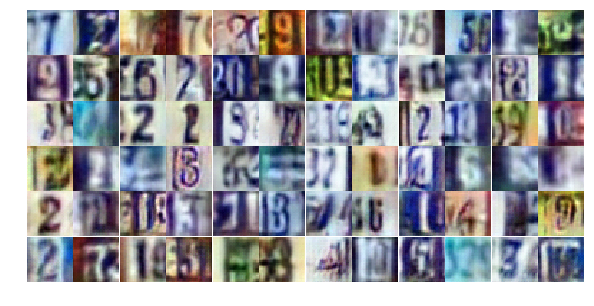

Epoch 21/25... Discriminator Loss: 1.1871... Generator Loss: 0.7508
Epoch 21/25... Discriminator Loss: 1.1813... Generator Loss: 0.8870
Epoch 21/25... Discriminator Loss: 1.2127... Generator Loss: 0.7766
Epoch 21/25... Discriminator Loss: 1.2572... Generator Loss: 0.8162
Epoch 21/25... Discriminator Loss: 1.1467... Generator Loss: 0.8747
Epoch 21/25... Discriminator Loss: 1.1962... Generator Loss: 0.8816
Epoch 21/25... Discriminator Loss: 1.1504... Generator Loss: 0.8012
Epoch 21/25... Discriminator Loss: 1.1498... Generator Loss: 0.9060
Epoch 21/25... Discriminator Loss: 1.2480... Generator Loss: 0.7998
Epoch 21/25... Discriminator Loss: 1.0945... Generator Loss: 0.9576


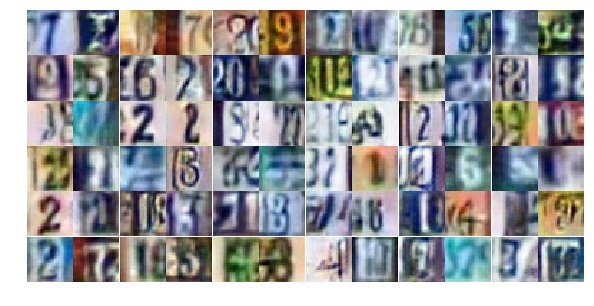

Epoch 21/25... Discriminator Loss: 1.1006... Generator Loss: 0.8456
Epoch 21/25... Discriminator Loss: 1.1606... Generator Loss: 0.8629
Epoch 21/25... Discriminator Loss: 1.1377... Generator Loss: 0.9197
Epoch 21/25... Discriminator Loss: 1.0802... Generator Loss: 0.8637
Epoch 21/25... Discriminator Loss: 1.1666... Generator Loss: 0.9263
Epoch 21/25... Discriminator Loss: 1.2147... Generator Loss: 0.8496
Epoch 21/25... Discriminator Loss: 1.1876... Generator Loss: 0.7854
Epoch 21/25... Discriminator Loss: 1.1576... Generator Loss: 0.7867
Epoch 21/25... Discriminator Loss: 1.1524... Generator Loss: 0.8106
Epoch 21/25... Discriminator Loss: 1.1955... Generator Loss: 0.8489


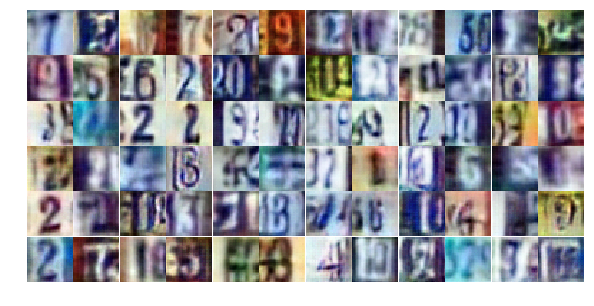

Epoch 21/25... Discriminator Loss: 1.2379... Generator Loss: 0.7168
Epoch 21/25... Discriminator Loss: 1.1831... Generator Loss: 0.7888
Epoch 21/25... Discriminator Loss: 1.2449... Generator Loss: 0.8327
Epoch 21/25... Discriminator Loss: 1.1504... Generator Loss: 0.9731
Epoch 21/25... Discriminator Loss: 1.1229... Generator Loss: 0.8677
Epoch 21/25... Discriminator Loss: 1.2548... Generator Loss: 0.6994
Epoch 21/25... Discriminator Loss: 1.1861... Generator Loss: 0.8332
Epoch 21/25... Discriminator Loss: 1.2443... Generator Loss: 0.7938
Epoch 21/25... Discriminator Loss: 1.1710... Generator Loss: 0.8990
Epoch 21/25... Discriminator Loss: 1.1370... Generator Loss: 0.8325


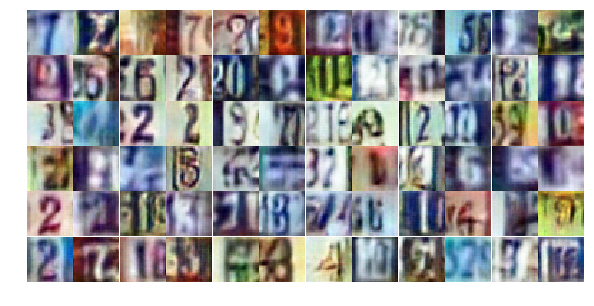

Epoch 21/25... Discriminator Loss: 1.1419... Generator Loss: 0.8135
Epoch 21/25... Discriminator Loss: 1.1607... Generator Loss: 0.9089
Epoch 21/25... Discriminator Loss: 1.2633... Generator Loss: 0.9495
Epoch 22/25... Discriminator Loss: 1.1503... Generator Loss: 0.8159
Epoch 22/25... Discriminator Loss: 1.2074... Generator Loss: 0.7951
Epoch 22/25... Discriminator Loss: 1.1335... Generator Loss: 0.9030
Epoch 22/25... Discriminator Loss: 1.1940... Generator Loss: 0.8252
Epoch 22/25... Discriminator Loss: 1.2223... Generator Loss: 0.7868
Epoch 22/25... Discriminator Loss: 1.1491... Generator Loss: 0.8400
Epoch 22/25... Discriminator Loss: 1.1861... Generator Loss: 0.7967


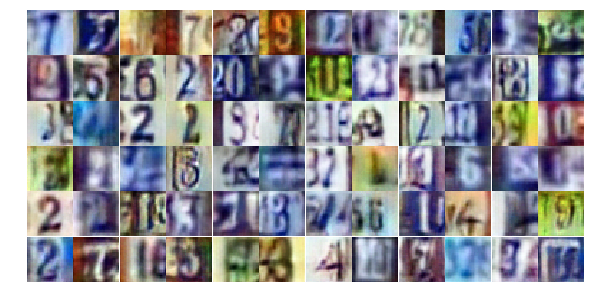

Epoch 22/25... Discriminator Loss: 1.2571... Generator Loss: 0.8982
Epoch 22/25... Discriminator Loss: 1.1701... Generator Loss: 0.7743
Epoch 22/25... Discriminator Loss: 1.2197... Generator Loss: 0.8387
Epoch 22/25... Discriminator Loss: 1.1089... Generator Loss: 0.8983
Epoch 22/25... Discriminator Loss: 1.2436... Generator Loss: 0.8951
Epoch 22/25... Discriminator Loss: 1.1404... Generator Loss: 0.8544
Epoch 22/25... Discriminator Loss: 1.3611... Generator Loss: 0.8032
Epoch 22/25... Discriminator Loss: 1.1826... Generator Loss: 0.8112
Epoch 22/25... Discriminator Loss: 1.2537... Generator Loss: 0.7661
Epoch 22/25... Discriminator Loss: 1.2705... Generator Loss: 0.7595


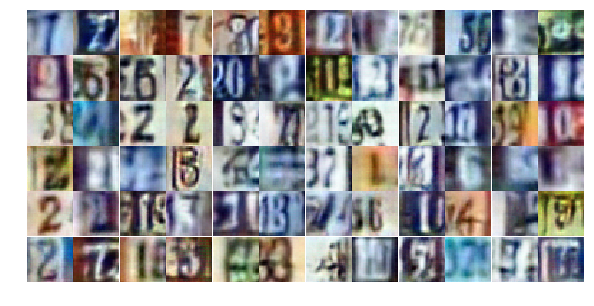

Epoch 22/25... Discriminator Loss: 1.1121... Generator Loss: 0.8875
Epoch 22/25... Discriminator Loss: 1.1327... Generator Loss: 0.8670
Epoch 22/25... Discriminator Loss: 1.1470... Generator Loss: 0.8051
Epoch 22/25... Discriminator Loss: 1.1009... Generator Loss: 0.9044
Epoch 22/25... Discriminator Loss: 1.1288... Generator Loss: 0.9709
Epoch 22/25... Discriminator Loss: 1.1769... Generator Loss: 0.7967
Epoch 22/25... Discriminator Loss: 1.1417... Generator Loss: 0.8180
Epoch 22/25... Discriminator Loss: 1.1859... Generator Loss: 0.7879
Epoch 22/25... Discriminator Loss: 1.1302... Generator Loss: 0.8751
Epoch 22/25... Discriminator Loss: 1.1561... Generator Loss: 0.8643


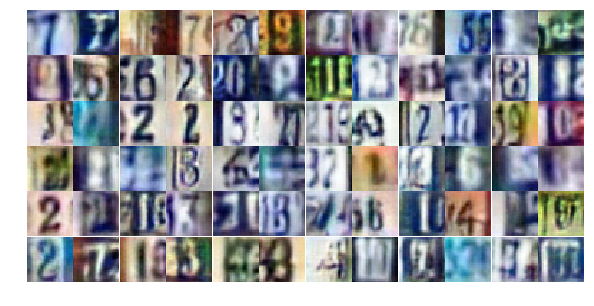

Epoch 22/25... Discriminator Loss: 1.1570... Generator Loss: 0.9547
Epoch 22/25... Discriminator Loss: 1.1796... Generator Loss: 0.7597
Epoch 22/25... Discriminator Loss: 1.1906... Generator Loss: 0.7807
Epoch 22/25... Discriminator Loss: 1.1415... Generator Loss: 0.9494
Epoch 22/25... Discriminator Loss: 1.1858... Generator Loss: 0.8723
Epoch 22/25... Discriminator Loss: 1.2181... Generator Loss: 0.8472
Epoch 22/25... Discriminator Loss: 1.1357... Generator Loss: 0.8102
Epoch 22/25... Discriminator Loss: 1.3047... Generator Loss: 0.7841
Epoch 22/25... Discriminator Loss: 1.1710... Generator Loss: 0.8304
Epoch 22/25... Discriminator Loss: 1.2148... Generator Loss: 0.8167


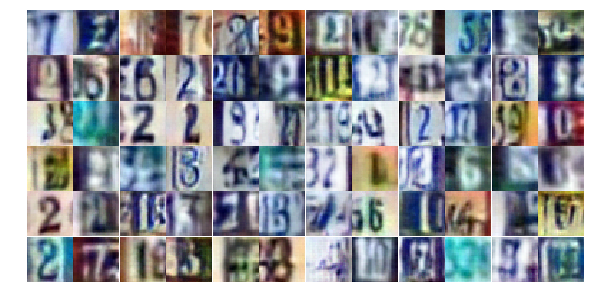

Epoch 22/25... Discriminator Loss: 1.1826... Generator Loss: 0.7926
Epoch 22/25... Discriminator Loss: 1.1338... Generator Loss: 0.8513
Epoch 22/25... Discriminator Loss: 1.1232... Generator Loss: 0.9941
Epoch 22/25... Discriminator Loss: 1.1547... Generator Loss: 1.0079
Epoch 22/25... Discriminator Loss: 1.1508... Generator Loss: 0.9251
Epoch 22/25... Discriminator Loss: 1.1977... Generator Loss: 0.8321
Epoch 22/25... Discriminator Loss: 1.2258... Generator Loss: 0.8657
Epoch 22/25... Discriminator Loss: 1.1077... Generator Loss: 0.9571
Epoch 22/25... Discriminator Loss: 1.2953... Generator Loss: 0.8208
Epoch 22/25... Discriminator Loss: 1.1684... Generator Loss: 0.8330


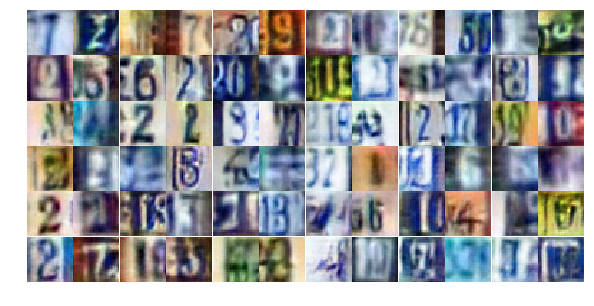

Epoch 22/25... Discriminator Loss: 1.1905... Generator Loss: 0.8838
Epoch 22/25... Discriminator Loss: 1.1958... Generator Loss: 0.8283
Epoch 22/25... Discriminator Loss: 1.1691... Generator Loss: 0.8161
Epoch 22/25... Discriminator Loss: 1.2016... Generator Loss: 0.9368
Epoch 22/25... Discriminator Loss: 1.1885... Generator Loss: 0.7894
Epoch 22/25... Discriminator Loss: 1.0857... Generator Loss: 0.8620
Epoch 22/25... Discriminator Loss: 1.2227... Generator Loss: 0.7908
Epoch 22/25... Discriminator Loss: 1.2343... Generator Loss: 0.8020
Epoch 22/25... Discriminator Loss: 1.0284... Generator Loss: 1.0506
Epoch 22/25... Discriminator Loss: 1.1564... Generator Loss: 0.8842


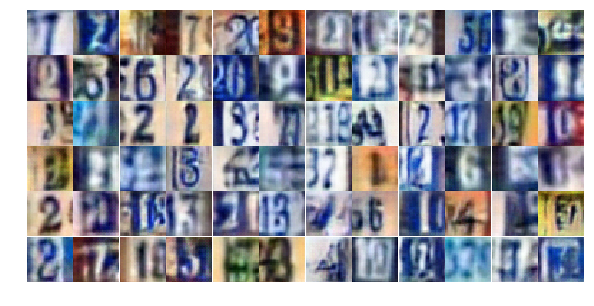

Epoch 23/25... Discriminator Loss: 1.1688... Generator Loss: 0.8822
Epoch 23/25... Discriminator Loss: 1.1142... Generator Loss: 0.8911
Epoch 23/25... Discriminator Loss: 1.1841... Generator Loss: 0.8443
Epoch 23/25... Discriminator Loss: 1.1511... Generator Loss: 0.8994
Epoch 23/25... Discriminator Loss: 1.2139... Generator Loss: 0.7912
Epoch 23/25... Discriminator Loss: 1.1272... Generator Loss: 0.8238
Epoch 23/25... Discriminator Loss: 1.2207... Generator Loss: 0.9191
Epoch 23/25... Discriminator Loss: 1.2269... Generator Loss: 0.7401
Epoch 23/25... Discriminator Loss: 1.1656... Generator Loss: 0.8479
Epoch 23/25... Discriminator Loss: 1.0511... Generator Loss: 0.8676


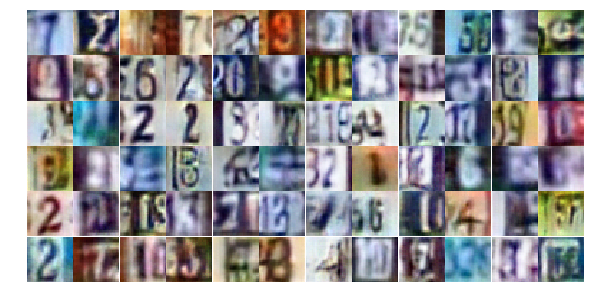

Epoch 23/25... Discriminator Loss: 1.2509... Generator Loss: 0.9605
Epoch 23/25... Discriminator Loss: 1.1751... Generator Loss: 0.7925
Epoch 23/25... Discriminator Loss: 1.0423... Generator Loss: 0.9941
Epoch 23/25... Discriminator Loss: 1.2039... Generator Loss: 0.8948
Epoch 23/25... Discriminator Loss: 1.1897... Generator Loss: 0.8059
Epoch 23/25... Discriminator Loss: 1.1641... Generator Loss: 0.8673
Epoch 23/25... Discriminator Loss: 1.1036... Generator Loss: 0.8127
Epoch 23/25... Discriminator Loss: 1.1733... Generator Loss: 0.8783
Epoch 23/25... Discriminator Loss: 1.2248... Generator Loss: 0.8067
Epoch 23/25... Discriminator Loss: 1.2039... Generator Loss: 0.8337


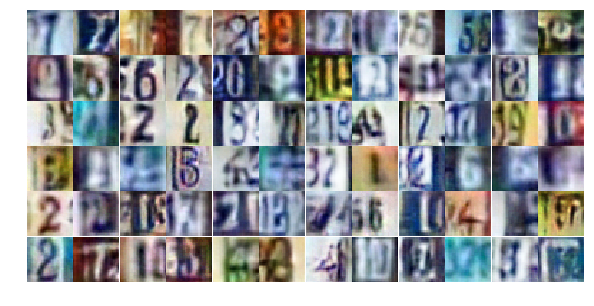

Epoch 23/25... Discriminator Loss: 1.1706... Generator Loss: 0.7703
Epoch 23/25... Discriminator Loss: 1.1061... Generator Loss: 0.8968
Epoch 23/25... Discriminator Loss: 1.1864... Generator Loss: 0.8437
Epoch 23/25... Discriminator Loss: 1.1820... Generator Loss: 0.8549
Epoch 23/25... Discriminator Loss: 1.1487... Generator Loss: 0.9358
Epoch 23/25... Discriminator Loss: 1.1785... Generator Loss: 0.8105
Epoch 23/25... Discriminator Loss: 1.1350... Generator Loss: 0.8660
Epoch 23/25... Discriminator Loss: 1.0745... Generator Loss: 0.8918
Epoch 23/25... Discriminator Loss: 1.1877... Generator Loss: 0.8006
Epoch 23/25... Discriminator Loss: 1.0933... Generator Loss: 0.8508


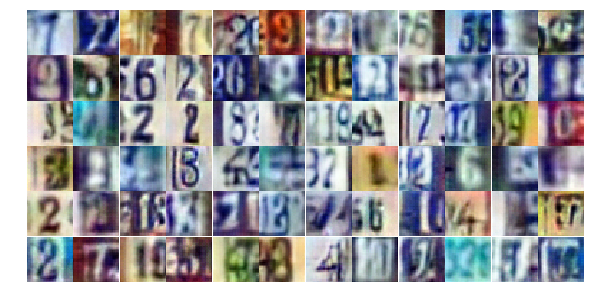

Epoch 23/25... Discriminator Loss: 1.1209... Generator Loss: 0.9130
Epoch 23/25... Discriminator Loss: 1.1531... Generator Loss: 0.8923
Epoch 23/25... Discriminator Loss: 1.2258... Generator Loss: 0.8119
Epoch 23/25... Discriminator Loss: 1.2330... Generator Loss: 0.8283
Epoch 23/25... Discriminator Loss: 1.2116... Generator Loss: 0.8068
Epoch 23/25... Discriminator Loss: 1.2375... Generator Loss: 0.7844
Epoch 23/25... Discriminator Loss: 1.2230... Generator Loss: 0.8436
Epoch 23/25... Discriminator Loss: 1.0996... Generator Loss: 1.0006
Epoch 23/25... Discriminator Loss: 1.1034... Generator Loss: 0.9902
Epoch 23/25... Discriminator Loss: 1.1782... Generator Loss: 0.8430


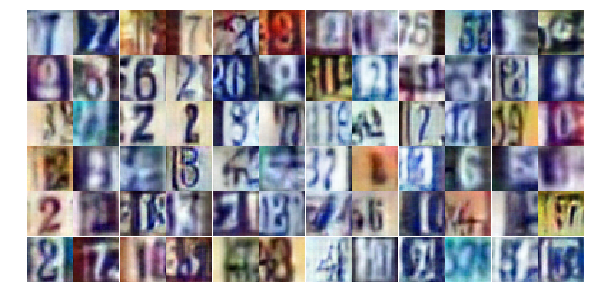

Epoch 23/25... Discriminator Loss: 1.1863... Generator Loss: 0.9477
Epoch 23/25... Discriminator Loss: 1.1734... Generator Loss: 0.8880
Epoch 23/25... Discriminator Loss: 1.1874... Generator Loss: 0.7982
Epoch 23/25... Discriminator Loss: 1.0853... Generator Loss: 0.9767
Epoch 23/25... Discriminator Loss: 1.2214... Generator Loss: 0.8915
Epoch 23/25... Discriminator Loss: 1.1558... Generator Loss: 0.7791
Epoch 23/25... Discriminator Loss: 1.1542... Generator Loss: 0.9417
Epoch 23/25... Discriminator Loss: 1.2459... Generator Loss: 0.8749
Epoch 23/25... Discriminator Loss: 1.2072... Generator Loss: 0.7861
Epoch 23/25... Discriminator Loss: 1.1250... Generator Loss: 0.8927


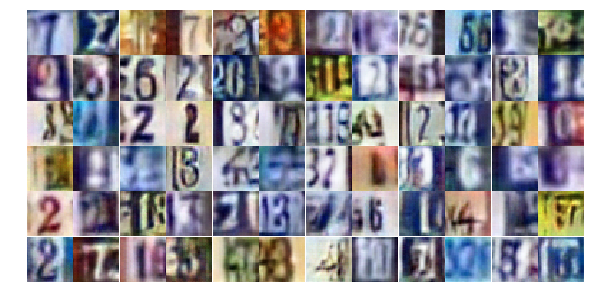

Epoch 23/25... Discriminator Loss: 1.2057... Generator Loss: 0.9240
Epoch 23/25... Discriminator Loss: 1.2588... Generator Loss: 0.8091
Epoch 23/25... Discriminator Loss: 1.2260... Generator Loss: 0.7613
Epoch 23/25... Discriminator Loss: 1.2558... Generator Loss: 0.8223
Epoch 23/25... Discriminator Loss: 1.1304... Generator Loss: 0.7660
Epoch 23/25... Discriminator Loss: 1.1316... Generator Loss: 0.8680
Epoch 23/25... Discriminator Loss: 1.1975... Generator Loss: 0.8632
Epoch 24/25... Discriminator Loss: 1.2395... Generator Loss: 0.8320
Epoch 24/25... Discriminator Loss: 1.2604... Generator Loss: 0.7339
Epoch 24/25... Discriminator Loss: 1.1529... Generator Loss: 0.8271


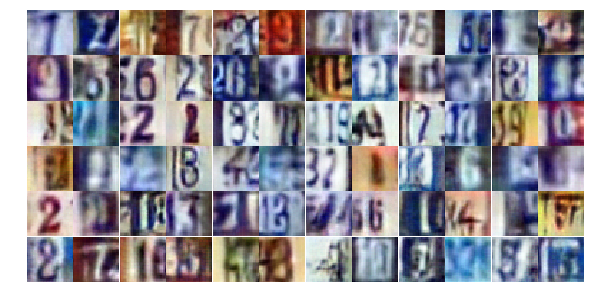

Epoch 24/25... Discriminator Loss: 1.1955... Generator Loss: 0.9831
Epoch 24/25... Discriminator Loss: 1.1571... Generator Loss: 0.9534
Epoch 24/25... Discriminator Loss: 1.1396... Generator Loss: 0.8577
Epoch 24/25... Discriminator Loss: 1.2332... Generator Loss: 0.9061
Epoch 24/25... Discriminator Loss: 1.1942... Generator Loss: 0.7566
Epoch 24/25... Discriminator Loss: 1.2146... Generator Loss: 0.7991
Epoch 24/25... Discriminator Loss: 1.2146... Generator Loss: 0.8462
Epoch 24/25... Discriminator Loss: 1.1017... Generator Loss: 0.8321
Epoch 24/25... Discriminator Loss: 1.0975... Generator Loss: 0.9564
Epoch 24/25... Discriminator Loss: 1.0549... Generator Loss: 0.9077


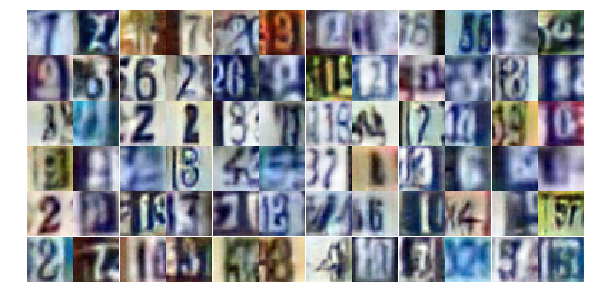

Epoch 24/25... Discriminator Loss: 1.1776... Generator Loss: 0.8343
Epoch 24/25... Discriminator Loss: 1.1814... Generator Loss: 0.8604
Epoch 24/25... Discriminator Loss: 1.1583... Generator Loss: 0.8951
Epoch 24/25... Discriminator Loss: 1.2421... Generator Loss: 0.8421
Epoch 24/25... Discriminator Loss: 1.2177... Generator Loss: 0.7734
Epoch 24/25... Discriminator Loss: 1.1718... Generator Loss: 0.8026
Epoch 24/25... Discriminator Loss: 1.1670... Generator Loss: 0.8417
Epoch 24/25... Discriminator Loss: 1.1294... Generator Loss: 0.7863
Epoch 24/25... Discriminator Loss: 1.1472... Generator Loss: 0.9453
Epoch 24/25... Discriminator Loss: 1.2010... Generator Loss: 0.8808


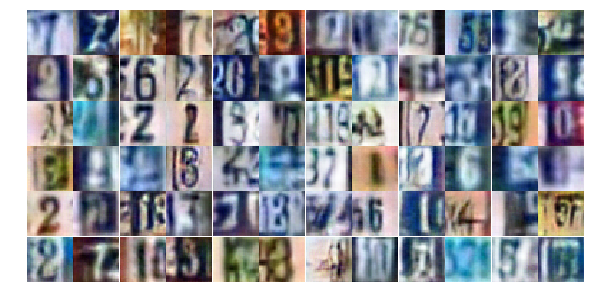

Epoch 24/25... Discriminator Loss: 1.1399... Generator Loss: 0.9266
Epoch 24/25... Discriminator Loss: 1.1318... Generator Loss: 0.8209
Epoch 24/25... Discriminator Loss: 1.1458... Generator Loss: 0.8218
Epoch 24/25... Discriminator Loss: 1.1880... Generator Loss: 0.8773
Epoch 24/25... Discriminator Loss: 1.1181... Generator Loss: 0.8691
Epoch 24/25... Discriminator Loss: 1.2268... Generator Loss: 0.7949
Epoch 24/25... Discriminator Loss: 1.2030... Generator Loss: 0.9275
Epoch 24/25... Discriminator Loss: 1.1070... Generator Loss: 0.9052
Epoch 24/25... Discriminator Loss: 1.2059... Generator Loss: 0.8258
Epoch 24/25... Discriminator Loss: 1.0867... Generator Loss: 0.9142


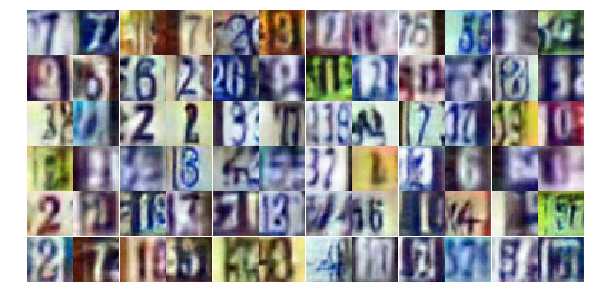

Epoch 24/25... Discriminator Loss: 1.0834... Generator Loss: 0.9387
Epoch 24/25... Discriminator Loss: 1.1273... Generator Loss: 0.8693
Epoch 24/25... Discriminator Loss: 1.2355... Generator Loss: 0.8298
Epoch 24/25... Discriminator Loss: 1.1740... Generator Loss: 0.7757
Epoch 24/25... Discriminator Loss: 1.1468... Generator Loss: 0.9050
Epoch 24/25... Discriminator Loss: 1.1485... Generator Loss: 0.8734
Epoch 24/25... Discriminator Loss: 1.2113... Generator Loss: 0.8144
Epoch 24/25... Discriminator Loss: 1.2166... Generator Loss: 0.8469
Epoch 24/25... Discriminator Loss: 1.1992... Generator Loss: 0.8453
Epoch 24/25... Discriminator Loss: 1.1603... Generator Loss: 0.8109


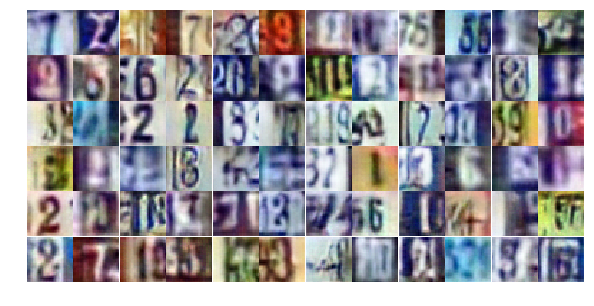

Epoch 24/25... Discriminator Loss: 1.2319... Generator Loss: 0.7613
Epoch 24/25... Discriminator Loss: 1.1633... Generator Loss: 0.7935
Epoch 24/25... Discriminator Loss: 1.2417... Generator Loss: 0.8509
Epoch 24/25... Discriminator Loss: 1.1794... Generator Loss: 0.8596
Epoch 24/25... Discriminator Loss: 1.1647... Generator Loss: 0.8355
Epoch 24/25... Discriminator Loss: 1.1484... Generator Loss: 0.8493
Epoch 24/25... Discriminator Loss: 1.2271... Generator Loss: 0.8234
Epoch 24/25... Discriminator Loss: 1.2347... Generator Loss: 0.7560
Epoch 24/25... Discriminator Loss: 1.2242... Generator Loss: 0.8756
Epoch 24/25... Discriminator Loss: 1.1527... Generator Loss: 0.8619


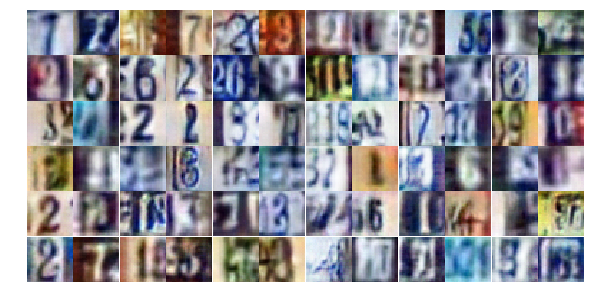

Epoch 24/25... Discriminator Loss: 1.1828... Generator Loss: 0.8747
Epoch 24/25... Discriminator Loss: 1.2248... Generator Loss: 0.8113
Epoch 24/25... Discriminator Loss: 1.2415... Generator Loss: 0.7472
Epoch 24/25... Discriminator Loss: 1.1303... Generator Loss: 0.8646
Epoch 24/25... Discriminator Loss: 1.2051... Generator Loss: 0.8369
Epoch 25/25... Discriminator Loss: 1.0927... Generator Loss: 0.8799
Epoch 25/25... Discriminator Loss: 1.1147... Generator Loss: 0.9152
Epoch 25/25... Discriminator Loss: 1.1587... Generator Loss: 0.8957
Epoch 25/25... Discriminator Loss: 1.1858... Generator Loss: 0.9336
Epoch 25/25... Discriminator Loss: 1.1524... Generator Loss: 0.8386


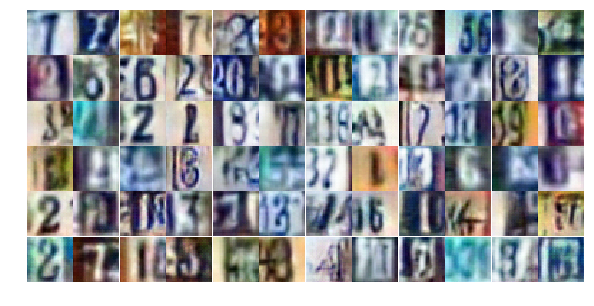

Epoch 25/25... Discriminator Loss: 1.0873... Generator Loss: 0.8571
Epoch 25/25... Discriminator Loss: 1.1683... Generator Loss: 0.8042
Epoch 25/25... Discriminator Loss: 1.2330... Generator Loss: 0.8250
Epoch 25/25... Discriminator Loss: 1.2231... Generator Loss: 0.8522
Epoch 25/25... Discriminator Loss: 1.1957... Generator Loss: 0.8501
Epoch 25/25... Discriminator Loss: 1.2665... Generator Loss: 0.8475
Epoch 25/25... Discriminator Loss: 1.1423... Generator Loss: 0.8253
Epoch 25/25... Discriminator Loss: 1.2149... Generator Loss: 0.8696
Epoch 25/25... Discriminator Loss: 1.0859... Generator Loss: 0.9054
Epoch 25/25... Discriminator Loss: 1.2428... Generator Loss: 0.7414


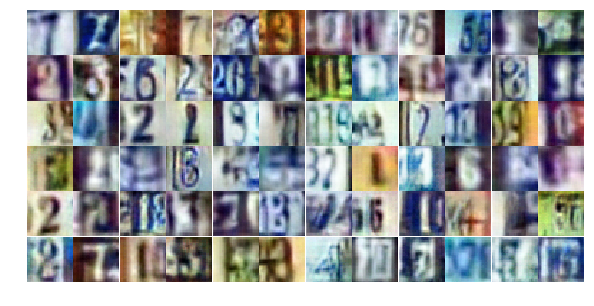

Epoch 25/25... Discriminator Loss: 1.1584... Generator Loss: 0.7978
Epoch 25/25... Discriminator Loss: 1.2347... Generator Loss: 0.7750
Epoch 25/25... Discriminator Loss: 1.1325... Generator Loss: 0.9267
Epoch 25/25... Discriminator Loss: 1.2920... Generator Loss: 0.9494
Epoch 25/25... Discriminator Loss: 1.1700... Generator Loss: 0.8247
Epoch 25/25... Discriminator Loss: 1.1401... Generator Loss: 0.8653
Epoch 25/25... Discriminator Loss: 1.1905... Generator Loss: 0.8138
Epoch 25/25... Discriminator Loss: 1.2179... Generator Loss: 0.7635
Epoch 25/25... Discriminator Loss: 1.1757... Generator Loss: 0.8945
Epoch 25/25... Discriminator Loss: 1.1561... Generator Loss: 1.0014


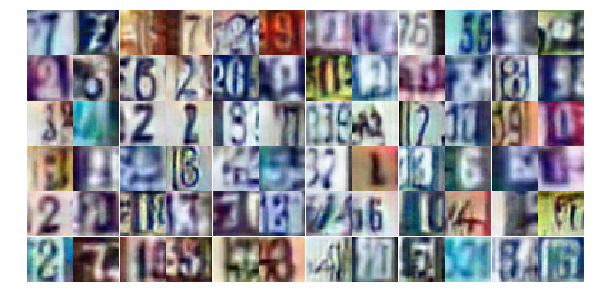

Epoch 25/25... Discriminator Loss: 1.2322... Generator Loss: 0.8204
Epoch 25/25... Discriminator Loss: 1.1577... Generator Loss: 0.8769
Epoch 25/25... Discriminator Loss: 1.1635... Generator Loss: 0.8405
Epoch 25/25... Discriminator Loss: 1.1781... Generator Loss: 1.0162
Epoch 25/25... Discriminator Loss: 1.1602... Generator Loss: 0.7824
Epoch 25/25... Discriminator Loss: 1.1302... Generator Loss: 0.8864
Epoch 25/25... Discriminator Loss: 1.1817... Generator Loss: 0.9815
Epoch 25/25... Discriminator Loss: 1.1587... Generator Loss: 0.8044
Epoch 25/25... Discriminator Loss: 1.2414... Generator Loss: 0.7835
Epoch 25/25... Discriminator Loss: 1.0588... Generator Loss: 0.9104


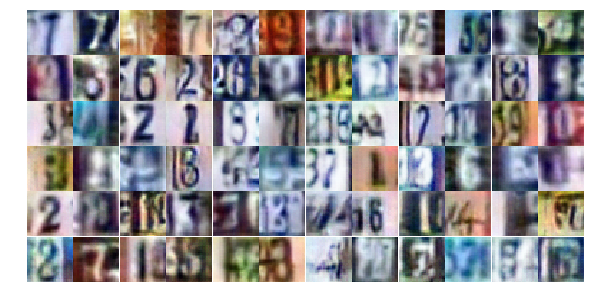

Epoch 25/25... Discriminator Loss: 1.1960... Generator Loss: 0.8354
Epoch 25/25... Discriminator Loss: 1.0704... Generator Loss: 0.8486
Epoch 25/25... Discriminator Loss: 1.1898... Generator Loss: 0.8116
Epoch 25/25... Discriminator Loss: 1.1363... Generator Loss: 0.9808
Epoch 25/25... Discriminator Loss: 1.1570... Generator Loss: 0.8388
Epoch 25/25... Discriminator Loss: 1.1894... Generator Loss: 0.9023
Epoch 25/25... Discriminator Loss: 1.2142... Generator Loss: 0.8279
Epoch 25/25... Discriminator Loss: 1.2093... Generator Loss: 0.7735
Epoch 25/25... Discriminator Loss: 1.1987... Generator Loss: 0.8202
Epoch 25/25... Discriminator Loss: 1.1211... Generator Loss: 0.9787


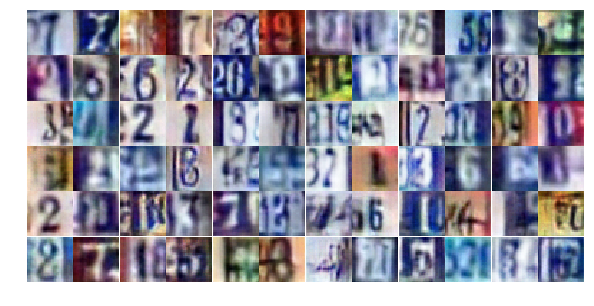

Epoch 25/25... Discriminator Loss: 1.1208... Generator Loss: 0.8091
Epoch 25/25... Discriminator Loss: 1.1486... Generator Loss: 0.8817
Epoch 25/25... Discriminator Loss: 1.2702... Generator Loss: 0.7373
Epoch 25/25... Discriminator Loss: 1.2605... Generator Loss: 0.8135
Epoch 25/25... Discriminator Loss: 1.1798... Generator Loss: 0.8374
Epoch 25/25... Discriminator Loss: 1.1803... Generator Loss: 0.8137
Epoch 25/25... Discriminator Loss: 1.1713... Generator Loss: 0.9337
Epoch 25/25... Discriminator Loss: 1.1189... Generator Loss: 0.7675
Epoch 25/25... Discriminator Loss: 1.1528... Generator Loss: 0.8047
Epoch 25/25... Discriminator Loss: 1.1881... Generator Loss: 0.7777


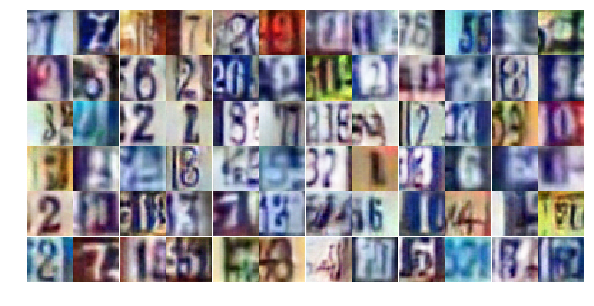

Epoch 25/25... Discriminator Loss: 1.1807... Generator Loss: 0.8811
Epoch 25/25... Discriminator Loss: 1.2408... Generator Loss: 0.6871


In [22]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

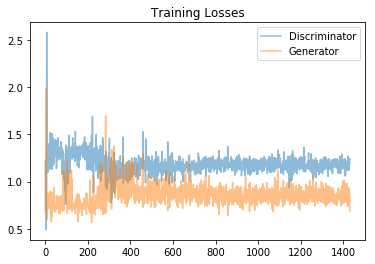

In [23]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

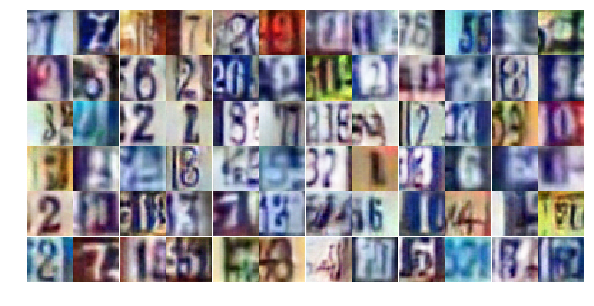

In [24]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))